# Load in functions

In [2]:
sys.path.insert(0, '/home/566/nd0349/notebooks/functions')
from plotting import create_map_axis, plot_style, add_subplot_label, set_ax_date
from functions import cyclic_moving_av
from matplotlib_scalebar.scalebar import ScaleBar
import cartopy.feature as cft
from datetime import datetime


def ProgressBar(Total, Progress, BarLength=20, ProgressIcon="#", BarIcon="-"):
    try:
        # You can't have a progress bar with zero or negative length.
        if BarLength <1:
            BarLength = 20
        # Use status variable for going to the next line after progress completion.
        Status = ""
        # Calcuting progress between 0 and 1 for percentage.
        Progress = float(Progress) / float(Total)
        # Doing this conditions at final progressing.
        if Progress >= 1.:
            Progress = 1
            Status = "\r\n"    # Going to the next line
        # Calculating how many places should be filled
        Block = int(round(BarLength * Progress))
        # Show this
        Bar = "[{}] {:.0f}% {}".format(ProgressIcon * Block + BarIcon * (BarLength - Block), round(Progress * 100, 0), Status)
        return Bar
    except:
        return "ERROR"


def ShowBar(Bar):
    sys.stdout.write(Bar)
    sys.stdout.flush()
    

In [3]:
year = 2019
COLOR_MIZ = [0.9805, 0.5000, 0.4453, 1.0]
COLOR_FSD = sns.color_palette("colorblind",15)[2]
COLOR_WAVE = sns.color_palette("colorblind",15)[3]
COLOR_IAGE = sns.color_palette("colorblind",15)[4]
COLOR_INTERIOR = sns.color_palette("colorblind",15)[0]

# Plot settings
rc('font',**{'family':'serif','serif':['Computer Modern Roman']})
rc('text', usetex=True)
textwidth = 3.31314*2
aspect_ratio = 6/8
scale = 1.0
width = textwidth * scale
height = width * aspect_ratio

#plt.style.use("seaborn")
plt.style.use('default')
plt.style.use(['science','ieee', 'grid'])
sns.set_context("paper")
rc('font',**{'family':'serif','serif':['Computer Modern Roman']})
rc('text', usetex=True)
font_size = 14
mpl.rcParams.update({'font.size': font_size})
mpl.rcParams.update({"axes.grid" : True, "grid.color": [0.6, 0.6, 0.6]})
sns.color_palette("colorblind",15)

filename = '/g/data/ia40/sea-ice-classification/kmean_2019.nc'
ds_mask = xr.open_dataset(filename)
LT = ds_mask['LAT']
LN = ds_mask['LON']
land_mask = ds_mask['tmask'].where(ds_mask['tmask'][:,:] != 1.) 
del ds_mask

In [4]:
#df_raw = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/raw_'+str(year)+'.csv')
df_raw = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/raw_'+str(year)+'.csv') for year in tqdm(range(2010,2020))), ignore_index=True)
print(df_raw.describe())
df_raw.shape
#del df_raw

100%|██████████| 10/10 [00:19<00:00,  1.97s/it]


         Unnamed: 0          aice            hi            hs        fsdrad  \
count  2.306257e+07  2.306257e+07  2.306257e+07  2.306257e+07  2.306257e+07   
mean   3.879780e+06  9.482792e-01  1.126902e+00  1.785182e-01  5.079758e+02   
std    1.808737e+06  1.391000e-01  6.909227e-01  1.596133e-01  2.892687e+02   
min    4.530000e+02  1.500001e-01  4.721331e-03  0.000000e+00  4.480674e-01   
25%    2.521272e+06  9.854153e-01  5.801811e-01  5.410500e-02  2.726680e+02   
50%    3.980437e+06  9.989012e-01  1.061694e+00  1.350417e-01  5.657750e+02   
75%    5.371874e+06  9.997078e-01  1.555502e+00  2.636590e-01  7.828963e+02   
max    7.109110e+06  1.000000e+00  7.465749e+00  1.736400e+00  8.504835e+02   

               iage          alvl     longitude      latitude  
count  2.306257e+07  2.306257e+07  2.306257e+07  2.306257e+07  
mean   3.859041e-01  7.373947e-01  2.061760e+02 -6.812363e+01  
std    3.013998e-01  2.183452e-01  1.008528e+02  5.217452e+00  
min    2.846959e-04  2.793839e-0

(23062571, 10)

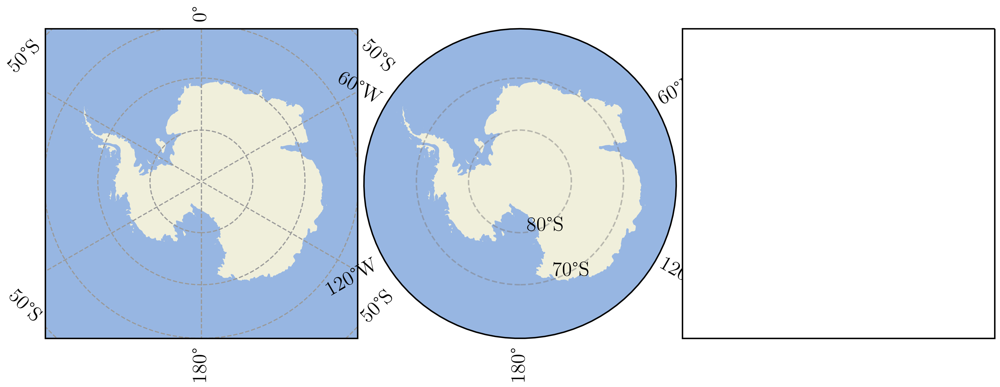

In [116]:
fig = plt.figure(figsize=[10, 5])
ax1 = fig.add_subplot(1, 3, 1, projection=ccrs.SouthPolarStereo())
ax2 = fig.add_subplot(1, 3, 2, projection=ccrs.SouthPolarStereo(),
                      sharex=ax1, sharey=ax1)
ax3 = fig.add_subplot(1, 3, 3, projection=ccrs.SouthPolarStereo(),
                      sharex=ax1, sharey=ax1)
fig.subplots_adjust(bottom=0.05, top=0.95,
                    left=0.04, right=0.95, wspace=0.02)

# Limit the map to -60 degrees latitude and below.
ax1.set_extent([-180, 180, -90, -60], ccrs.PlateCarree())


ax1.add_feature(cfeature.LAND)
ax1.add_feature(cfeature.OCEAN)

ax1.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False)
#ax2.gridlines()

gl = ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                  linewidth=1, color='gray', alpha=0.5, linestyle='--')
gl.top_labels = False
gl.botttom_labels = False
gl.left_labels = False
gl.right_labels = False
gl.left_labels = False
gl.xlabels_top = False
gl.ylabels_left = False
gl.xlines = False

gl.xlocator = mticker.FixedLocator([-180, -120, -60, 0, 60, 120])
gl.ylocator = mticker.FixedLocator([-80, -70, -60])
#gl.set_extent((10, 90, 20, 90))
#ax1.set_yticks([-80, -70])
#gl.ylocator = LatitudeLocator()
gl.xformatter = LongitudeFormatter()
gl.yformatter = LatitudeFormatter()
gl.xlabel_style = {#'size': 15, 
                   'color': 'gray'}
gl.xlabel_style = {'color': 'black', 'weight': 'bold'}

ax2.add_feature(cfeature.LAND)
ax2.add_feature(cfeature.OCEAN)

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

ax2.set_boundary(circle, transform=ax2.transAxes)

plt.show()

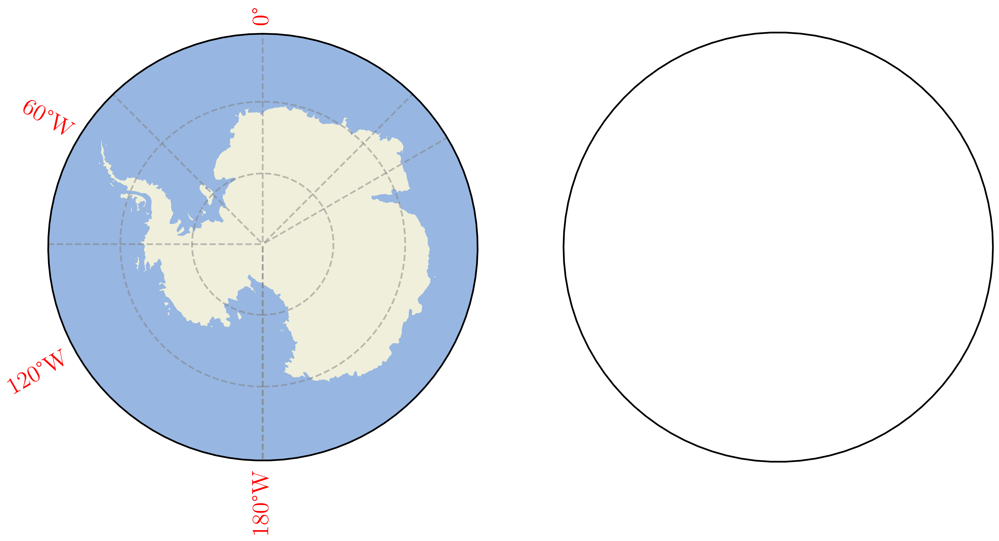

In [130]:
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER

fig = plt.figure(figsize=[10, 7])
ax1 = fig.add_subplot(1, 2, 1, projection=ccrs.SouthPolarStereo())
ax2 = fig.add_subplot(1, 2, 2, projection=ccrs.SouthPolarStereo())

ax1.set_extent([-180, 180, -90, -60], ccrs.PlateCarree())


ax1.add_feature(cfeature.LAND)
ax1.add_feature(cfeature.OCEAN)

gl = ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=False,
                  linewidth=1, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top = True
gl.xlabels_bottom = False
gl.ylabels_left = False
gl.ylabels_right = False
gl.xlines = True
gl.xlocator = mticker.FixedLocator([-180, -45, -90, 0, 60, 45, 180])
gl.ylocator = mticker.FixedLocator([-80, -70, -60])
gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 15, 'color': 'gray'}
gl.xlabel_style = {'color': 'red', 'weight': 'bold'}


gl = ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                  linewidth=1, color='gray', alpha=0.0, linestyle='--')
gl.xlocator = mticker.FixedLocator([-180, -60, -120, 0])
gl.ylocator = mticker.FixedLocator([0])
gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 15, 'color': 'gray'}
gl.xlabel_style = {'color': 'red', 'weight': 'bold'}



theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

ax1.set_boundary(circle, transform=ax1.transAxes)


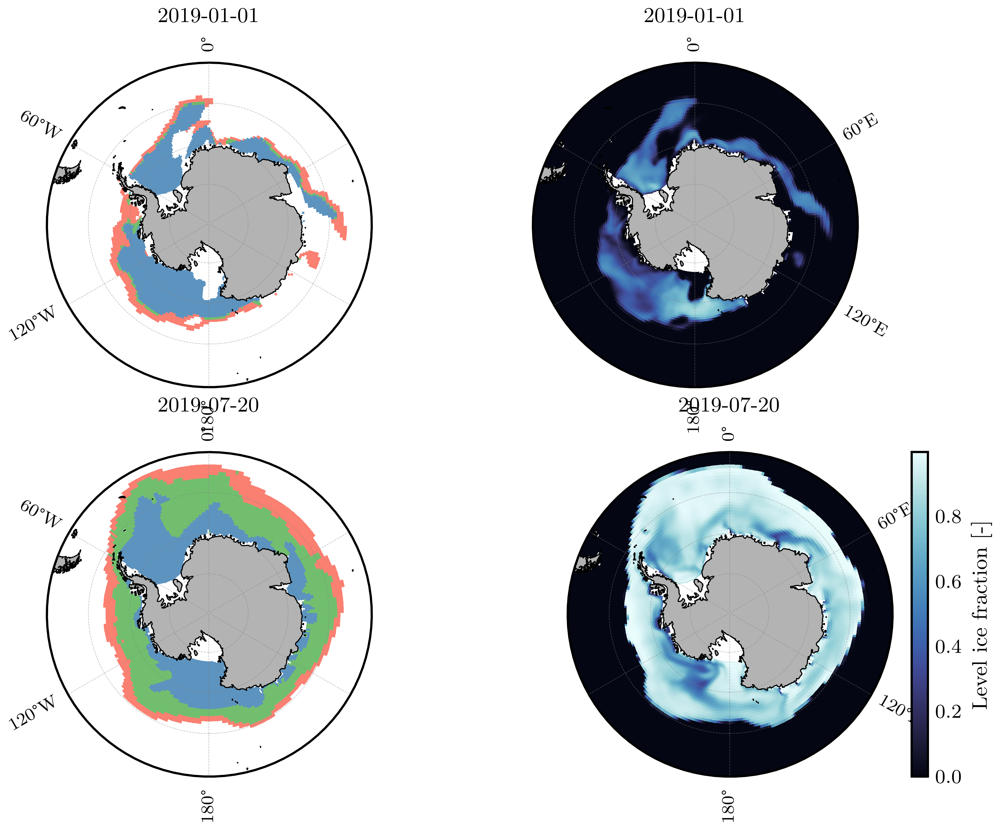

In [15]:
filename = '/g/data/ia40/sea-ice-classification/kmean_2019.nc'
ds = xr.open_dataset(filename)
LT = ds['LAT']
LN = ds['LON']


fig = plt.figure(figsize=[width, height])
ax1 = fig.add_subplot(2, 2, 1, projection=ccrs.SouthPolarStereo())
ax2 = fig.add_subplot(2, 2, 2, projection=ccrs.SouthPolarStereo(), sharex=ax1, sharey=ax1)
ax3 = fig.add_subplot(2, 2, 3, projection=ccrs.SouthPolarStereo(), sharex=ax1, sharey=ax1)
ax4 = fig.add_subplot(2, 2, 4, projection=ccrs.SouthPolarStereo(), sharex=ax1, sharey=ax1)
ax1 = create_map_axis(ax=ax1, LN=LN, LT=LT, land_mask=land_mask, draw_labels="left")
ax2 = create_map_axis(ax=ax2, LN=LN, LT=LT, land_mask=land_mask, draw_labels="right")
ax3 = create_map_axis(ax=ax3, LN=LN, LT=LT, land_mask=land_mask, draw_labels="left")
ax4 = create_map_axis(ax=ax4, LN=LN, LT=LT, land_mask=land_mask, draw_labels="right")
fig.subplots_adjust(bottom=0.05, top=0.95,
                left=0.04, right=0.95, wspace=0.02)


# Make a colormap
cmap = mpl.colors.ListedColormap([(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)])

bounds = [44, 51, 53, 56]
tick_labels = ['1', '2', '3']
# define the bins and normalize
bounds = np.linspace(0, 3, 4)

norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
p = ax1.pcolormesh(LN, LT, ds['k'][0,:,:],
            transform=ccrs.PlateCarree(),
            cmap=cmap,
            norm=norm,
            shading='auto')
ax1.set_title('2019-01-01')

filename = '/g/data/ia40/cice-dirs/runs/waves-10/history/iceh.2019-01-01.nc'
ds2 = xr.open_dataset(filename)
LT2 = ds['LAT']
LN2 = ds['LON']
p = ax2.pcolormesh(LN, LT, ds2['alvl'][0,:,:],
            transform=ccrs.PlateCarree(),
            cmap=cmo.ice,
            #norm=norm,
            shading='auto')
ax2.set_title('2019-01-01')
#cb = plt.colorbar(p, orientation='vertical', fraction=0.046, pad=0.04, label='Level ice fraction [-]') 


p = ax3.pcolormesh(LN, LT, ds['k'][200,:,:],
            transform=ccrs.PlateCarree(),
            cmap=cmap,
            norm=norm,
            shading='auto')
ax3.set_title('2019-07-20')

filename = '/g/data/ia40/cice-dirs/runs/waves-10/history/iceh.2019-07-20.nc'
ds2 = xr.open_dataset(filename)
LT2 = ds['LAT']
LN2 = ds['LON']
p = ax4.pcolormesh(LN, LT, ds2['alvl'][0,:,:],
            transform=ccrs.PlateCarree(),
            cmap=cmo.ice,
            #norm=norm,
            shading='auto')
ax4.set_title('2019-07-20')

cb = plt.colorbar(p, orientation='vertical', fraction=0.046, pad=0.04, label='Level ice fraction [-]') 

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'level_ice_maps_'+str(year)+'.png', dpi = 300) 

In [ ]:
proj = ccrs.Mercator(central_longitude=180, min_latitude=15, 
    max_latitude=55)

fig, ax = plt.subplots(subplot_kw=dict(projection=proj), figsize=(12,12))

ax.set_extent([255 ,115, 0, 60], crs=ccrs.PlateCarree())

ax.add_feature(cfeature.LAND, facecolor='0.3')
ax.add_feature(cfeature.LAKES, alpha=0.9)  
ax.add_feature(cfeature.BORDERS, zorder=10)
ax.add_feature(cfeature.COASTLINE, zorder=10)

states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',  name='admin_1_states_provinces_lines',
        scale='50m', facecolor='none')
ax.add_feature(states_provinces, edgecolor='black', zorder=10)

ax.set_xticks([120., 140., 160., 180., -160., -140., -120.], crs=ccrs.PlateCarree())
ax.set_xticklabels([120., 140., 160., 180., -160., -140., -120.], color='red', weight='bold')
ax.set_yticks([20, 40], crs=ccrs.PlateCarree())
ax.set_yticklabels([20, 40])
ax.yaxis.tick_right()

lon_formatter = cticker.LongitudeFormatter()
lat_formatter = cticker.LatitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.yaxis.set_major_formatter(lat_formatter)
ax.grid(linewidth=2, color='black', alpha=0.5, linestyle='--')

In [ ]:
import proplot as plot
f, axs = plot.subplots(nrows=2, axwidth=4.5,
           proj='pcarree', basemap={1:False, 2:True},
           proj_kw={2:{'llcrnrlon':-20, 'llcrnrlat':-10, 'urcrnrlon':180, 'urcrnrlat':50}})
# Ordinary projection
axs.format(land=True, labels=True, lonlines=20, latlines=20, suptitle='Zooming into projections')
axs[0].format(lonlim=(-140,60), latlim=(-10,50), labels=True, title='Cartopy example')
axs[1].format(title='Basemap example')
# Polar projection
f, axs = plot.subplots(ncols=2, axwidth=2.2,
           proj={1:'splaea', 2:'npaeqd'}, basemap={1:False,2:True},
           proj_kw={2:{'boundinglat':60}})
axs.format(land=True, latlines=10, latmax=80, suptitle='Zooming into polar projections')
axs[0].format(boundinglat=-60, title='Cartopy example')
axs[1].format(title='Basemap example')
# Example from basemap website
f, axs = plot.subplots(ncols=2, axwidth=2, proj='lcc', basemap={1:False,2:True},
             proj_kw={1:{'lon_0':0}, 2:{'lon_0':-100, 'lat_0':45, 'width':8e6, 'height':8e6}})
axs.format(suptitle='Zooming into specific regions', land=True)
axs[0].format(title='Cartopy example', land=True, lonlim=(-20,50), latlim=(30,70))
axs[1].format(title='Basemap example', land=True)

# Figure 1: Cluster number plot - with SWH

In [5]:
filename = '/g/data/ia40/sea-ice-classification/kmean_'+str(year)+'.nc'
n_clusters = 3
#filename = '/g/data/ia40/sea-ice-classification/kmean_'+str(n_clusters)+'_clusters_new_12345_'+str(year)+'.nc'
ds = xr.open_dataset(filename)
LT = ds['LAT']
LN = ds['LON']
cmap
day = 200
print(day)

n_days, n_lat, n_lon = ds['k'].shape

# Plot this on a map        
fontprops = fm.FontProperties(size=18)
plt.figure()
clevs=np.arange(0,4,1)

coord_lims = [-180, 180, -45, -90]
# Make a colormap
cmap = mpl.colors.ListedColormap([(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)])
bounds = [44, 51, 53, 56]
tick_labels = ['1', '2', '3']
# define the bins and normalize
bounds = np.linspace(0, 3, 4)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

ax = plt.subplot(1, 1, 1, projection=ccrs.SouthPolarStereo())
ax.set_extent(coord_lims, ccrs.PlateCarree())
land_50m = cft.NaturalEarthFeature('physical', 'land', '50m',
                        edgecolor='none', facecolor='gray', linewidth=0.5)
#ax.coastlines(resolution='50m')
ax.add_feature(land_50m)
p = ax.pcolormesh(LN, LT, ds['k'][day,:,:],
            transform=ccrs.PlateCarree(),
            cmap=cmap,
            norm=norm,
#                norm=colors.LogNorm(vmin=1, vmax=1000),
            shading='auto')




#plt.title(str(n_clusters)+" clusters")

cb = plt.colorbar(p, orientation='vertical', fraction=0.046, pad=0.04, label='Cluster number') 
#cb.set_ticks([bounds[0]] + [(b0 + b1) / 2 for b0, b1 in zip(bounds[:-1], bounds[1:])] + [bounds[-1]])
cb.set_ticks(bounds[0:-1]+0.5)
tick_texts = cb.ax.set_yticklabels(tick_labels)
tick_texts[0].set_verticalalignment('top')
tick_texts[-1].set_verticalalignment('bottom')

cb.ax.tick_params(length=0) # optionally remove the tick marks
savepath = '/home/566/nd0349/notebooks/'
plt.tight_layout()
plt.savefig(savepath+'kmeans_map_day_200_'+str(year)+'.png', dpi = 300) 

200



KeyboardInterrupt



Error in callback <function flush_figures at 0x14a77ee555e0> (for post_execute):



KeyboardInterrupt



### Inset SWH hist

2


FileNotFoundError: [Errno 2] No such file or directory: b'/g/data/ia40/sea-ice-classification/kmean_2_clusters_2019.nc'

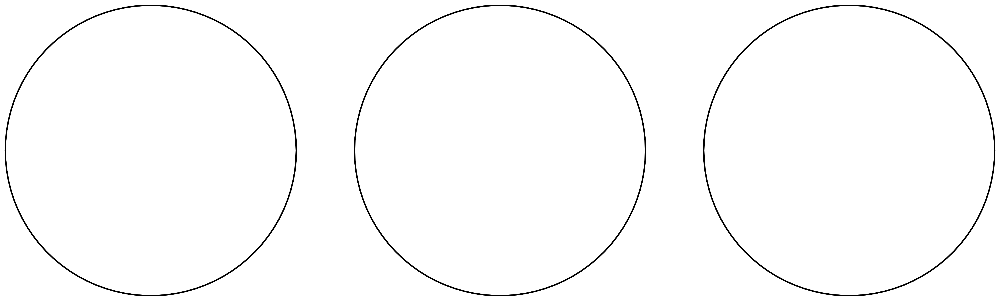

In [56]:
n_bins = 31

# Preparation for maps ---------
filename = '/g/data/ia40/cice-dirs/runs/waves-10/history/iceh.'+str(year)+'-08-25.nc'
ds = xr.open_dataset(filename)
tmask = ds['tmask'][:,:]
# Define the contour levels to use in plt.contourf
clevs=np.arange(0,5,1)
year = 2019
coord_lims = [-180, 180, -50, -90]
# Make a colormap
cmap = mpl.colors.ListedColormap([(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0), 'purple'])
# define the bins and normalize
bounds = np.linspace(0, 4, 5)
tick_labels = ['1', '2', '3', '4']
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
# Make the map
land_50m = cft.NaturalEarthFeature('physical', 'land', '50m',
                        edgecolor='none', facecolor='gray', linewidth=0.5)

# --------


fig, axs = plt.subplot_mosaic([['a)','b)','c)']],#,'b)', 'c)']],#,['d)','e)','f)']],
#                              nrows=2,ncols=3,#
                              subplot_kw={'projection': ccrs.SouthPolarStereo()},
                              figsize=(12,6))


plt.rcParams["font.family"] = "serif"
n_clusters = 2
for label, ax in axs.items():
    # Plot a map for the first 3
    if n_clusters < 5:
        print(n_clusters)
        readfilename='/g/data/ia40/sea-ice-classification/kmean_'+str(n_clusters)+'_clusters_'+str(year)+'.nc'
        if n_clusters == 3:
            readfilename='/g/data/ia40/sea-ice-classification/kmean_'+str(year)+'.nc'
        ds = xr.open_dataset(readfilename)
        plot_data = ds['k'][243,:,:]
        cs = ax.pcolormesh(ds['LON'][:,:], ds['LAT'][:,:], plot_data,
                    transform=ccrs.PlateCarree(),
                    cmap=cmap,
                    norm=norm,
                    shading='auto')

        # label physical distance in and down:
        trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
        ax.text(0.0, 1.0, label, transform=ax.transAxes + trans,
                fontsize='large', verticalalignment='top', fontfamily='serif',
                bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
        ax.set_extent(coord_lims, ccrs.PlateCarree())
        
        # region for the map inset
#        insetBox = [-17.5,12,-11,17]
        # setup inset map and add layers
        # ([left, bottom, width, height])
        pos1 = ax.get_position()
        ax_inset = fig.add_axes([pos1.x0, pos1.y0,  pos1.width / 2.0, pos1.height / 2.0])#([left_corner, 0.2, 0.1, 0.2])#,projection='linear')
        plot_data_2 = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/SWH_inner_outer_'+str(n_clusters)+'_clusters.csv')
        sns.histplot(ax=ax_inset, data=plot_data_2['interior'], 
                     kde=False, bins=n_bins, stat='probability',
                     binwidth = 0.33, line_kws={'lw': 0.25, 'color': (0.9805, 0.5000, 0.4453, 1.0)},
                     alpha=0.5,color=(0.9805, 0.5000, 0.4453, 1.0))
        ax_inset.set_xlabel('$H_s$ [m]')#, fontsize=8)
        ax_inset.set_xlim((0, 10))
        ax_inset.set_ylim((0.0005,1.0))
        ax_inset.set_yscale('log')
        ax_inset.set_xscale('linear')
        ax_inset.spines['top'].set_visible(False)
        ax_inset.spines['right'].set_visible(False)
        ax_inset.set_facecolor("none")
        ax_inset.set_xticks([0, 5, 10])
        ax_inset.set_yticks([0.01, 0.1, 1])
        
        
#        ax_inset.axvline(plot_data_2['interior'].mean())#, c="k", ls="-", lw=2.5)
 #       ax.spines['bottom'].set_visible(False)
#        ax.spines['left'].set_visible(False)
        if n_clusters > 2:
            ax_inset.set_ylabel('')
            #ax_inset.get_yaxis().set_ticks([])
            plt.setp(ax_inset.get_yticklabels(), visible=False)
        del ax_inset, plot_data_2

        # Add coastlines
        ax.add_feature(land_50m)
#        ax.coastlines()
        
        n_clusters = n_clusters + 1
        
    elif label == 'd)':
        # September 1st
        readfilename='/g/data/ia40/sea-ice-classification/kmean_2019.nc'
        ds = xr.open_dataset(readfilename)
        read_data = ds['k'][243,:,:]
        cmaptmp = cmap
    elif label == 'e)':
        readfilename='/g/data/ia40/sea-ice-classification/kmean_3_4_2019.nc'
        ds = xr.open_dataset(readfilename)
        read_data = ds['k'][243,:,:]
        cmaptmp = mpl.colors.ListedColormap([(0.3639, 0.5755, 0.748, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.9805, 0.5000, 0.4453, 1.0)])
    elif label == 'f)':
        readfilename='/g/data/ia40/sea-ice-classification/kmean_3_1235_2019.nc'
        ds = xr.open_dataset(readfilename)
        read_data = ds['k'][243,:,:]
        cmaptmp = cmap

fig.subplots_adjust(right=0.9)
cbar_ax = fig.add_axes([pos1.x0 + pos1.width + 0.01, pos1.y0, 0.01, pos1.height])
cbar = fig.colorbar(cs, cax=cbar_ax,orientation='vertical', label='Cluster number') 
cbar.set_ticks(bounds[0:-1]+0.5)
tick_texts = cbar.ax.set_yticklabels(tick_labels)
#tick_texts[0].set_verticalalignment('top')
#tick_texts[-1].set_verticalalignment('bottom')

    
savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'SWH_difference_234_clusters.png', dpi = 300, bbox_inches='tight') 
plt.savefig(savepath+'SWH_difference_234_clusters.pdf', bbox_inches='tight')  
plt.show()
        

In [ ]:
fig, axs = plt.subplot_mosaic([['a)','b)','c)']],#,'b)', 'c)']],#,['d)','e)','f)']],
#                              nrows=2,ncols=3,#
                              subplot_kw={'projection': ccrs.SouthPolarStereo()},
                              figsize=(12,6))

#fig.add_subplot()
pos1 = ax.get_position()
fig.subplots_adjust(bottom=0.1)
fig.add_axes([pos1.x0, pos1.y0, pos1.width, pos1.height/2.0])

### 2 rows

2



KeyboardInterrupt



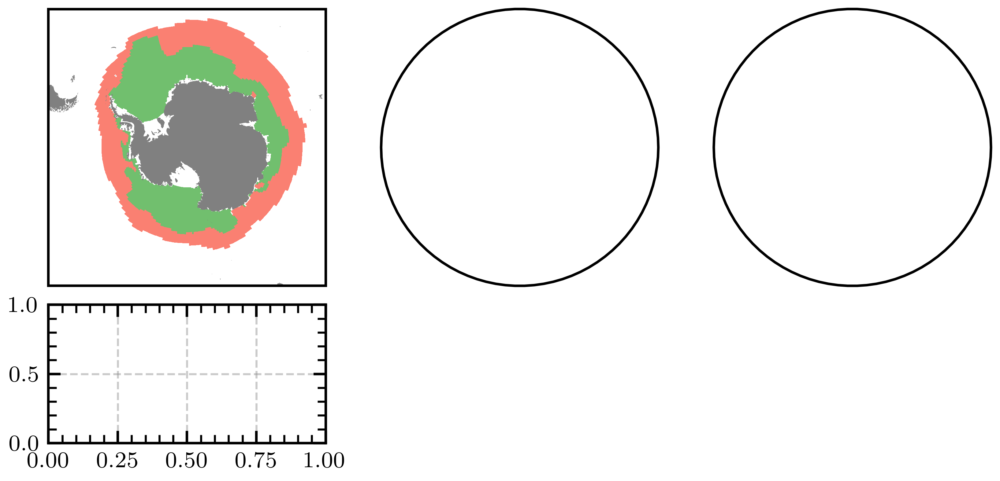

In [6]:
n_bins = 31
day = 243
# Preparation for maps ---------
filename = '/g/data/ia40/cice-dirs/runs/waves-10/history/iceh.'+str(year)+'-08-25.nc'
ds = xr.open_dataset(filename)
tmask = ds['tmask'][:,:]
# Define the contour levels to use in plt.contourf
clevs=np.arange(0,5,1)
coord_lims = [-180, 180, -50, -90]
# Make a colormap
cmap = mpl.colors.ListedColormap([(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0), 'purple'])
# define the bins and normalize
bounds = np.linspace(0, 4, 5)
tick_labels = ['1', '2', '3', '4']
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
# Make the map
land_50m = cft.NaturalEarthFeature('physical', 'land', '50m',
                        edgecolor='none', facecolor='gray', linewidth=0.5)


fig, axs = plt.subplot_mosaic([['a)','b)','c)']],#,['d)','e)','f)']],
#                              gridspec_kw={'height_ratios': [2, 1]},
                              subplot_kw={'projection': ccrs.SouthPolarStereo()},
                              #per_subplot_kw={("a)", "b)", "c)"): {"projection": ccrs.SouthPolarStereo()},
                              #              ("d)", "e)", "f)"): {"xscale": "linear"}},
                              figsize=(width,height))#, layout="constrained")
#                              nrows=2,ncols=3,#
#                              gridspec_kw={'height_ratios': [2, 1]},
#                              subplot_kw={'projection': ccrs.SouthPolarStereo()},

n_clusters = 2
for label, ax in axs.items():
    
    # Plot a map for the first 3
#    if label == 'a)':
    print(n_clusters)
    readfilename='/g/data/ia40/sea-ice-classification/kmean_'+str(n_clusters)+'_clusters_'+str(year)+'.nc'
    if n_clusters == 3:
        readfilename='/g/data/ia40/sea-ice-classification/kmean_'+str(year)+'.nc'
    ds = xr.open_dataset(readfilename)
    plot_data = ds['k'][day,:,:]
    cs = ax.pcolormesh(ds['LON'][:,:], ds['LAT'][:,:], plot_data,
                transform=ccrs.PlateCarree(),
                cmap=cmap,
                norm=norm,
                shading='auto')
    ax.set_extent(coord_lims, ccrs.PlateCarree())



    # region for the map inset
#        insetBox = [-17.5,12,-11,17]
    # setup inset map and add layers
    # ([left, bottom, width, height])
    # pos1 = ax.get_position()
    # ax_inset = fig.add_subplot(335+n_clusters)
    # #fig.add_axes([pos1.x0, pos1.y0,  pos1.width, pos1.height / 2.0])
    # plot_data_2 = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/SWH_inner_outer_'+str(n_clusters)+'_clusters.csv')
    # sns.histplot(ax=ax_inset, data=plot_data_2['interior'], 
    #              kde=False, bins=n_bins, stat='probability',
    #              binwidth = 0.33, line_kws={'lw': 0.25, 'color': (0.9805, 0.5000, 0.4453, 1.0)},
    #              alpha=0.5,color=(0.9805, 0.5000, 0.4453, 1.0))
    # ax_inset.set_xlabel('$H_s$ [m]')#, fontsize=8)
    # ax_inset.set_xlim((0, 10))
    # ax_inset.set_ylim((0.0005,1.0))
    # ax_inset.set_yscale('log')
    # ax_inset.set_xscale('linear')
#        ax_inset.spines['top'].set_visible(False)
#        ax_inset.spines['right'].set_visible(False)
#        ax_inset.set_facecolor("none")
#        ax_inset.set_xticks([0, 5, 10])
#        ax_inset.set_yticks([0.01, 0.1, 1])



#        ax_inset.axvline(plot_data_2['interior'].mean())#, c="k", ls="-", lw=2.5)
#       ax.spines['bottom'].set_visible(False)
#        ax.spines['left'].set_visible(False)
    # if n_clusters > 2:
    #     ax_inset.set_ylabel('')
    #     #ax_inset.get_yaxis().set_ticks([])
    #     plt.setp(ax_inset.get_yticklabels(), visible=False)
    # del ax_inset, plot_data_2

    # Add coastlines
    ax.add_feature(land_50m)
#        ax.coastlines()



    pos1 = ax.get_position()
    
    if n_clusters == 2:
        fig.subplots_adjust(bottom=pos1.height/2.0)
        ax_inset = fig.add_axes([pos1.x0, pos1.y0-pos1.height/2.0, pos1.width, pos1.height/2.0])

        plot_data_2 = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/SWH_inner_outer_'+str(n_clusters)+'_clusters_2019.csv')
        sns.histplot(ax=ax_inset, data=plot_data_2['interior'], 
                     kde=False, bins=n_bins, stat='probability',
                     binwidth = 0.33, line_kws={'lw': 0.25, 'color': (0.9805, 0.5000, 0.4453, 1.0)},
                     alpha=0.5,color=(0.9805, 0.5000, 0.4453, 1.0))
        ax_inset.set_yscale('log')
        ax_inset.set_xscale('linear')
        ax_inset.set_xlim((0, 10))
        ax_inset.set_ylim((0.0005,1.0))
        ax_inset.set_yticks([0.01, 0.1, 1])
        ax_inset.set_xlabel('$H_s$ [m]')
        
        trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
        ax_inset.text(0.0, 1.0, 'd)', transform=ax_inset.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
        
        pos2 = ax_inset.get_position()
        
    elif n_clusters > 2:
        ax_inset = fig.add_axes([pos1.x0, pos2.y0, pos2.width, pos2.height])
        plot_data_2 = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/SWH_inner_outer_'+str(n_clusters)+'_clusters.csv')
        sns.histplot(ax=ax_inset, data=plot_data_2['interior'], 
                     kde=False, bins=n_bins, stat='probability',
                     binwidth = 0.33, line_kws={'lw': 0.25, 'color': (0.9805, 0.5000, 0.4453, 1.0)},
                     alpha=0.5,color=(0.9805, 0.5000, 0.4453, 1.0))
        ax_inset.set_yscale('log')
        ax_inset.set_xscale('linear')
        ax_inset.set_xlim((0, 10))
        ax_inset.set_ylim((0.0005,1.0))
        ax_inset.set_xlabel('$H_s$ [m]')
        ax_inset.set_ylabel('')
        ax_inset.set_yticks([0.01, 0.1, 1])
        #ax_inset.get_yaxis().set_ticks([])
        plt.setp(ax_inset.get_yticklabels(), visible=False)
        
        if n_clusters == 3:
            ax_inset.text(0.0, 1.0, 'e)', transform=ax_inset.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
        elif n_clusters == 4: 
            ax_inset.text(0.0, 1.0, 'f)', transform=ax_inset.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
    #del ax_inset
    n_clusters = n_clusters + 1
    add_subplot_label(fig, label)
       
pos1 = ax.get_position()
fig.subplots_adjust(right=0.9)
cbar_ax = fig.add_axes([pos1.x0 + pos1.width + 0.01, pos1.y0, 0.01, pos1.height])
cbar = fig.colorbar(cs, cax=cbar_ax,orientation='vertical', label='Cluster number') 
cbar.set_ticks(bounds[0:-1]+0.5)
tick_texts = cbar.ax.set_yticklabels(tick_labels)



    
savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'SWH_difference_234_clusters_2rows.png', dpi = 300, bbox_inches='tight') 
plt.savefig(savepath+'SWH_difference_234_clusters_2rows.pdf', bbox_inches='tight')  
plt.show()
        

In [33]:

#x_exp
#np.random.rand(10)1/(1-x)
np.log(x)

array([ 1.38464832,  1.8833691 ,  0.80904563,  1.39137723,  2.12806581,
       -0.6505358 ,  2.24473464,  1.62270274,  0.99483558,  0.3288659 ,
        1.60034629,  1.2212442 ,  2.23747606,  1.05017967,  1.9533653 ,
        1.75142442,  0.34850646,  1.14141331,  1.85956452,  0.9600468 ,
        1.4560071 ,  1.91302641,  1.81033181,  2.05717261,  0.98216902,
        0.89355364,  2.17069471,  2.23902274, -1.01715034,  2.02666055,
       -4.12271705,  1.86315293,  1.96413744,  2.14251565,  2.09805768,
        2.17109933,  1.23877114, -0.70203349,  1.70648453,  1.67729329,
        1.67413454,  0.94328205,  1.25801941,  2.01494773,  2.14655958,
        1.0401359 ,  1.43403341,  2.18865112,  1.39086029,  1.87070764,
       -2.59922914,  2.28602404,  2.10522485,  2.19230249,  1.58153449,
        1.52422097,  2.23315148,  0.82985608,  1.55570775,  1.91277233,
        0.96943616,  1.26983705,  1.9089027 ,  1.64118527,  1.24427241,
        1.93995281,  2.18618391,  2.00375893,  2.26446115,  0.46

(0.0, 15.0)

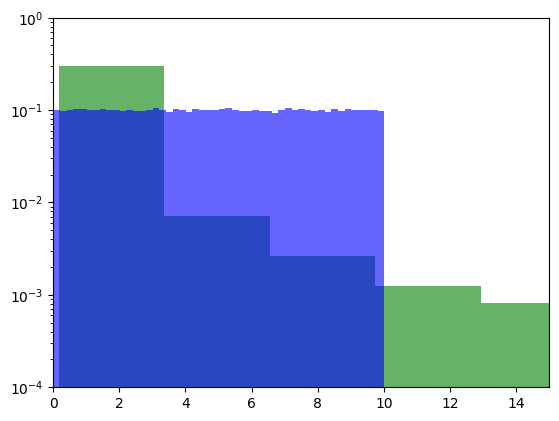

In [44]:
lam = 1

def exp_pdf(lam, x):
    return (1/lam) * np.log(x)

x = np.random.rand(100000)*10 + 0.01
lam = 5
x_exp = exp_pdf(x, lam)
x_exp_exp = exp_pdf(x_exp, lam)

fig = plt.figure()
ax1 = fig.add_subplot(1, 1, 1)
plt.hist(x_exp, bins=50, density=True, alpha=0.6, color='g')
plt.hist(x_exp_exp, bins=50, density=True, alpha=0.6, color='b')
ax1.set_yscale('log')
ax1.set_xscale('linear')
ax1.set_ylim((10**-4, 1))
ax1.set_xlim((0, 15))

### Fig. 1: FINAL PLOT

In [70]:
plot_data


#valid = date_by_items.notnull()
#positive = date_by_items > 0
#positive = positive * 2
#result = plot_data.fillna(2.0).where(mask_2)
#(result == 4).sum()
mask_4 = plot_data.values == 4
mask_2 = plot_data.values == 2
plot_data.values[mask_4] = 4
plot_data.values[mask_2] = 2
plot_data

<xarray.DataArray 'k' (nj: 300, ni: 360)>
array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])
Coordinates:
    LON      (nj, ni) float32 ...
    LAT      (nj, ni) float32 ...
    time     <U10 '2019-09-01'
Dimensions without coordinates: nj, ni
Attributes:
    long_name:  k-means_clusters
    units:      cluster number

ax1 done!
ax2 done!
ax3 done!
ax1 inset done!
ax2 inset done!
ax3 inset done!


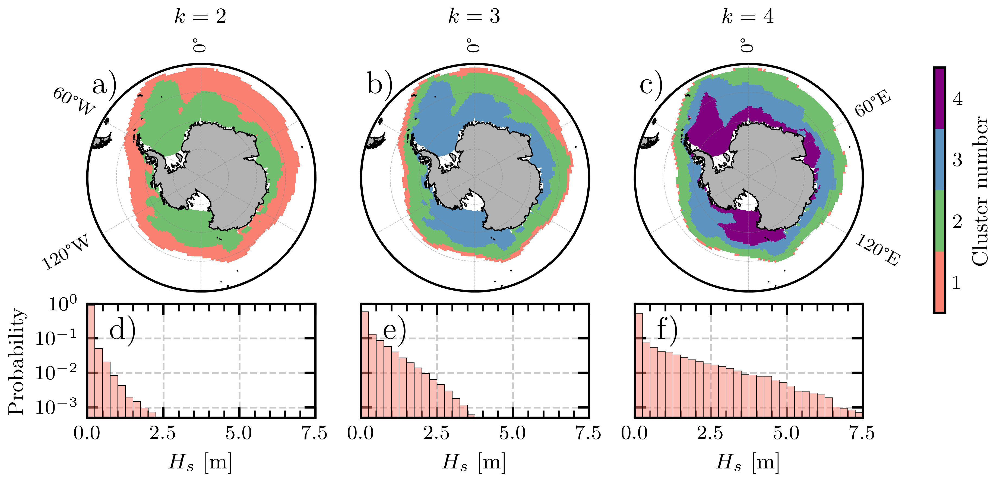

In [6]:
#from random import sample
n_bins = 15
day = 238-1 # 26th of August - Sea ice maximum
#243 # = 1st of September
# Preparation for maps ---------
filename = '/g/data/ia40/cice-dirs/runs/waves-10/history/iceh.'+str(year)+'-08-26.nc'
ds = xr.open_dataset(filename)
tmask = ds['tmask'][:,:]
# Define the contour levels to use in plt.contourf
clevs=np.arange(0,5,1)
# Make a colormap
cmap = mpl.colors.ListedColormap([(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0), 'purple'])
#cmap2 = mpl.colors.ListedColormap([(0.9805, 0.5000, 0.4453, 1.0), 'purple', (0.3639, 0.5755, 0.748, 1.0), (0.4416, 0.7490, 0.4322, 1.0)])
# define the bins and normalize
bounds = np.linspace(0, 4, 5)
tick_labels = ['1', '2', '3', '4']
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
n_clusters = 2


plot_data_2 = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/SWH_inner_outer_'+str(n_clusters)+'_clusters_'+str(year)+'.csv')
#plot_data_2['interior'].loc[sample(plot_data_2.index, 1000)]
row1 = plot_data_2['interior'].sample(n = 100)
row1
plot_data_2.describe()

fig = plt.figure(figsize=[width, height])
ax1 = fig.add_subplot(1, 3, 1, projection=ccrs.SouthPolarStereo())
ax1 = create_map_axis(ax=ax1, LN=LN, LT=LT, land_mask=land_mask, draw_labels="left")
ax2 = fig.add_subplot(1, 3, 2, projection=ccrs.SouthPolarStereo())
ax2 = create_map_axis(ax=ax2, LN=LN, LT=LT, land_mask=land_mask, draw_labels="middle")
ax3 = fig.add_subplot(1, 3, 3, projection=ccrs.SouthPolarStereo())
ax3 = create_map_axis(ax=ax3, LN=LN, LT=LT, land_mask=land_mask, draw_labels="right")

readfilename='/g/data/ia40/sea-ice-classification/kmean_2_clusters_'+str(year)+'.nc'
ds = xr.open_dataset(readfilename)
plot_data = ds['k'][day,:,:]
cs = ax1.pcolormesh(ds['LON'][:,:], ds['LAT'][:,:], plot_data,
            transform=ccrs.PlateCarree(),
            cmap=cmap,
            norm=norm,
            shading='auto')

print('ax1 done!')

readfilename='/g/data/ia40/sea-ice-classification/kmean_'+str(year)+'.nc'
ds = xr.open_dataset(readfilename)
plot_data = ds['k'][day,:,:]
cs = ax2.pcolormesh(ds['LON'][:,:], ds['LAT'][:,:], plot_data,
            transform=ccrs.PlateCarree(),
            cmap=cmap,
            norm=norm,
            shading='auto')
print('ax2 done!')

readfilename='/g/data/ia40/sea-ice-classification/kmean_4_clusters_'+str(year)+'.nc'
ds = xr.open_dataset(readfilename)
plot_data = ds['k'][day,:,:]
mask_4 = plot_data.values == 4
mask_2 = plot_data.values == 2
plot_data.values[mask_4] = 4
plot_data.values[mask_2] = 2

cs = ax3.pcolormesh(ds['LON'][:,:], ds['LAT'][:,:], plot_data,
            transform=ccrs.PlateCarree(),
            cmap=cmap,
            norm=norm,
            shading='auto')
print('ax3 done!')

# Add colorbar
pos1 = ax3.get_position()
fig.subplots_adjust(right=1-10/64) # (right=1-10/64)
cbar_ax = fig.add_axes([pos1.x0 + pos1.width + 0.01, pos1.y0, 0.01, pos1.height])
cbar = fig.colorbar(cs, cax=cbar_ax,orientation='vertical', label='Cluster number') 
cbar.set_ticks(bounds[0:-1]+0.5)
tick_texts = cbar.ax.set_yticklabels(tick_labels)

trans = mtransforms.ScaledTranslation(2.5/72, -2.5/72, fig.dpi_scale_trans)
ax1.text(0.0, 1.0, 'a)', transform=ax1.transAxes + trans,
               fontsize='medium', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax2.text(0.0, 1.0, 'b)', transform=ax2.transAxes + trans,
               fontsize='medium', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax3.text(0.0, 1.0, 'c)', transform=ax3.transAxes + trans,
               fontsize='medium', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))


# Add inset
trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
pos1 = ax1.get_position()
fig.subplots_adjust(bottom=pos1.height/2.0)
ax_inset = fig.add_axes([pos1.x0, pos1.y0 - pos1.height/2.0 + 0/64, pos1.width, pos1.height/2.0])
n_clusters = 2
plot_data_2 = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/SWH_inner_outer_'+str(n_clusters)+'_clusters_'+str(year)+'.csv')
sns.histplot(ax=ax_inset, data=plot_data_2['interior'], 
             kde=False, bins=n_bins, stat='probability',
             binwidth = 0.25, line_kws={'lw': 0.25, 'color': (0.9805, 0.5000, 0.4453, 1.0)},
             alpha=0.5,color=(0.9805, 0.5000, 0.4453, 1.0))
ax_inset.set_yscale('log')
ax_inset.set_xscale('linear')
ax_inset.set_xlim((0, 7.5))
ax_inset.set_ylim((0.0005,1.0))
inset_yticks = [0.001, 0.01, 0.1, 1]
ax_inset.set_yticks(inset_yticks)
ax_inset.set_xlabel('$H_s$ [m]')
ax_inset.text(0.0, 1.0, 'd)', transform=ax_inset.transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
pos2 = ax_inset.get_position()
print('ax1 inset done!')

pos1 = ax2.get_position()
fig.subplots_adjust(bottom=pos1.height/2.0)
ax_inset = fig.add_axes([pos1.x0, pos2.y0, pos1.width, pos2.height])
n_clusters = 3
plot_data_2 = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/SWH_inner_outer_'+str(n_clusters)+'_clusters_'+str(year)+'.csv')
sns.histplot(ax=ax_inset, data=plot_data_2['interior'], 
             kde=False, bins=n_bins, stat='probability',
             binwidth = 0.25, line_kws={'lw': 0.25, 'color': (0.9805, 0.5000, 0.4453, 1.0)},
             alpha=0.5,color=(0.9805, 0.5000, 0.4453, 1.0))
ax_inset.set_yscale('log')
ax_inset.set_xscale('linear')
ax_inset.set_xlim((0, 7.5))
ax_inset.set_ylim((0.0005,1.0))
ax_inset.set_xlabel('$H_s$ [m]')
ax_inset.set_ylabel('')
ax_inset.set_yticks(inset_yticks)
#ax_inset.get_yaxis().set_ticks([])
plt.setp(ax_inset.get_yticklabels(), visible=False)
ax_inset.text(0.0, 1.0, 'e)', transform=ax_inset.transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
print('ax2 inset done!')

pos1 = ax3.get_position()
fig.subplots_adjust(bottom=pos1.height/2.0)
ax_inset = fig.add_axes([pos1.x0, pos2.y0, pos1.width, pos2.height])
n_clusters = 4
plot_data_2 = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/SWH_inner_outer_'+str(n_clusters)+'_clusters_'+str(year)+'.csv')
sns.histplot(ax=ax_inset, data=plot_data_2['interior'], 
             kde=False, bins=n_bins, stat='probability',
             binwidth = 0.25, line_kws={'lw': 0.25, 'color': (0.9805, 0.5000, 0.4453, 1.0)},
             alpha=0.5,color=(0.9805, 0.5000, 0.4453, 1.0))
ax_inset.set_yscale('log')
ax_inset.set_xscale('linear')
ax_inset.set_xlim((0, 7.5))
ax_inset.set_ylim((0.0005,1.0))
ax_inset.set_xlabel('$H_s$ [m]')
ax_inset.set_ylabel('')
ax_inset.set_yticks(inset_yticks)
#ax_inset.get_yaxis().set_ticks([])
plt.setp(ax_inset.get_yticklabels(), visible=False)
ax_inset.text(0.0, 1.0, 'f)', transform=ax_inset.transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
print('ax3 inset done!')

ax1.set_title('$k=2$')
ax2.set_title('$k=3$')
ax3.set_title('$k=4$')

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'SWH_difference_234_clusters_2rows.png', dpi = 300, bbox_inches='tight') 
plt.savefig(savepath+'SWH_difference_234_clusters_2rows.pdf', bbox_inches='tight')  
plt.show()

### Old plot

ax1 done!
ax2 done!
ax3 done!
ax1 inset done!
ax2 inset done!
ax3 inset done!


/jobfs/96457095.gadi-pbs/ipykernel_2662467/526843041.py:146: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(pad=0.25)


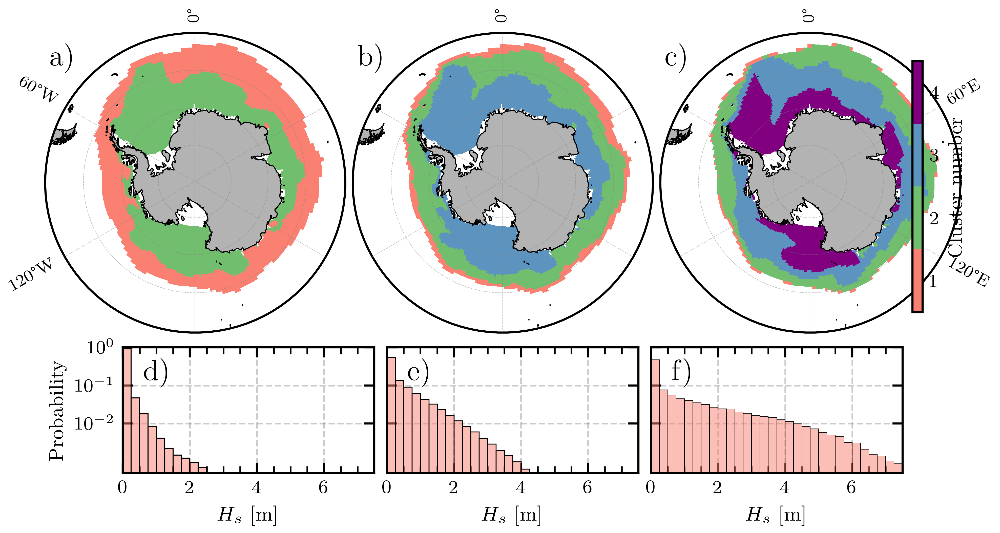

In [21]:
n_bins = 15
day = 243
# Preparation for maps ---------
filename = '/g/data/ia40/cice-dirs/runs/waves-10/history/iceh.'+str(year)+'-08-25.nc'
ds = xr.open_dataset(filename)
tmask = ds['tmask'][:,:]
# Define the contour levels to use in plt.contourf
clevs=np.arange(0,5,1)
# Make a colormap
cmap = mpl.colors.ListedColormap([(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0), 'purple'])
# define the bins and normalize
bounds = np.linspace(0, 4, 5)
tick_labels = ['1', '2', '3', '4']
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
n_clusters = 2


fig = plt.figure(figsize=[width, height])
ax1 = fig.add_subplot(1, 3, 1, projection=ccrs.SouthPolarStereo())
ax2 = fig.add_subplot(1, 3, 2, projection=ccrs.SouthPolarStereo(), sharex=ax1, sharey=ax1)
ax3 = fig.add_subplot(1, 3, 3, projection=ccrs.SouthPolarStereo(), sharex=ax1, sharey=ax1)
ax1 = create_map_axis(ax=ax1, LN=LN, LT=LT, land_mask=land_mask, draw_labels="left")
ax2 = create_map_axis(ax=ax2, LN=LN, LT=LT, land_mask=land_mask, draw_labels="middle")
ax3 = create_map_axis(ax=ax3, LN=LN, LT=LT, land_mask=land_mask, draw_labels="right")
#fig.subplots_adjust(bottom=0.05, top=0.95, left=0.04, right=0.95, wspace=0.02)
fig.subplots_adjust(wspace=0.05)
trans = mtransforms.ScaledTranslation(2.5/72, -5/72, fig.dpi_scale_trans)

readfilename='/g/data/ia40/sea-ice-classification/kmean_2_clusters_'+str(year)+'.nc'
ds = xr.open_dataset(readfilename)
plot_data = ds['k'][day,:,:]
cs = ax1.pcolormesh(ds['LON'][:,:], ds['LAT'][:,:], plot_data,
            transform=ccrs.PlateCarree(),
            cmap=cmap,
            norm=norm,
            shading='auto')
print('ax1 done!')

readfilename='/g/data/ia40/sea-ice-classification/kmean_'+str(year)+'.nc'
ds = xr.open_dataset(readfilename)
plot_data = ds['k'][day,:,:]
cs = ax2.pcolormesh(ds['LON'][:,:], ds['LAT'][:,:], plot_data,
            transform=ccrs.PlateCarree(),
            cmap=cmap,
            norm=norm,
            shading='auto')
print('ax2 done!')

readfilename='/g/data/ia40/sea-ice-classification/kmean_4_clusters_'+str(year)+'.nc'
ds = xr.open_dataset(readfilename)
plot_data = ds['k'][day,:,:]
cs = ax3.pcolormesh(ds['LON'][:,:], ds['LAT'][:,:], plot_data,
            transform=ccrs.PlateCarree(),
            cmap=cmap,
            norm=norm,
            shading='auto')
print('ax3 done!')

ax1.text(0.0, 1.0, 'a)', transform=ax1.transAxes + trans,
               fontsize='medium', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax2.text(0.0, 1.0, 'b)', transform=ax2.transAxes + trans,
               fontsize='medium', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax3.text(0.0, 1.0, 'c)', transform=ax3.transAxes + trans,
               fontsize='medium', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))

# Add colorbar
pos1 = ax3.get_position()
#fig.subplots_adjust(right=1-32/64) # (right=1-10/64)
cbar_ax = fig.add_axes([pos1.x0 + pos1.width + 0.01, pos1.y0, 0.01, pos1.height])
cbar = fig.colorbar(cs, cax=cbar_ax,orientation='vertical', label='Cluster number') 
cbar.set_ticks(bounds[0:-1]+0.5)
tick_texts = cbar.ax.set_yticklabels(tick_labels)


# Add inset
trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
pos1 = ax1.get_position()
fig.subplots_adjust(bottom=pos1.height/2.0)
ax_inset = fig.add_axes([pos1.x0, pos1.y0-pos1.height/2.0-3/64, pos1.width, pos1.height/2.0])
n_clusters = 2
plot_data_2 = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/SWH_inner_outer_'+str(n_clusters)+'_clusters_'+str(year)+'.csv')
sns.histplot(ax=ax_inset, data=plot_data_2['interior'], 
             kde=False, bins=n_bins, stat='probability',
             binwidth = 0.25, line_kws={'lw': 0.25, 'color': (0.9805, 0.5000, 0.4453, 1.0)},
             alpha=0.5,color=(0.9805, 0.5000, 0.4453, 1.0))
ax_inset.set_yscale('log')
ax_inset.set_xscale('linear')
ax_inset.set_xlim((0, 7.5))
ax_inset.set_ylim((0.0005,1.0))
ax_inset.set_yticks([0.01, 0.1, 1])
ax_inset.set_xlabel('$H_s$ [m]')
ax_inset.text(0.0, 1.0, 'd)', transform=ax_inset.transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
pos2 = ax_inset.get_position()
print('ax1 inset done!')

pos1 = ax2.get_position()
fig.subplots_adjust(bottom=pos1.height/2.0)
ax_inset = fig.add_axes([pos1.x0, pos2.y0, pos1.width, pos2.height])
n_clusters = 3
plot_data_2 = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/SWH_inner_outer_'+str(n_clusters)+'_clusters_'+str(year)+'.csv')
sns.histplot(ax=ax_inset, data=plot_data_2['interior'], 
             kde=False, bins=n_bins, stat='probability',
             binwidth = 0.25, line_kws={'lw': 0.25, 'color': (0.9805, 0.5000, 0.4453, 1.0)},
             alpha=0.5,color=(0.9805, 0.5000, 0.4453, 1.0))
ax_inset.set_yscale('log')
ax_inset.set_xscale('linear')
ax_inset.set_xlim((0, 7.5))
ax_inset.set_ylim((0.0005,1.0))
ax_inset.set_xlabel('$H_s$ [m]')
ax_inset.set_ylabel('')
ax_inset.set_yticks([0.01, 0.1, 1])
#ax_inset.get_yaxis().set_ticks([])
plt.setp(ax_inset.get_yticklabels(), visible=False)
ax_inset.text(0.0, 1.0, 'e)', transform=ax_inset.transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
print('ax2 inset done!')

pos1 = ax3.get_position()
fig.subplots_adjust(bottom=pos1.height/2.0)
ax_inset = fig.add_axes([pos1.x0, pos2.y0, pos1.width, pos2.height])
n_clusters = 4
plot_data_2 = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/SWH_inner_outer_'+str(n_clusters)+'_clusters_'+str(year)+'.csv')
sns.histplot(ax=ax_inset, data=plot_data_2['interior'], 
             kde=False, bins=n_bins, stat='probability',
             binwidth = 0.25, line_kws={'lw': 0.25, 'color': (0.9805, 0.5000, 0.4453, 1.0)},
             alpha=0.5,color=(0.9805, 0.5000, 0.4453, 1.0))
ax_inset.set_yscale('log')
ax_inset.set_xscale('linear')
ax_inset.set_xlim((0, 7.5))
ax_inset.set_ylim((0.0005,1.0))
ax_inset.set_xlabel('$H_s$ [m]')
ax_inset.set_ylabel('')
ax_inset.set_yticks([0.01, 0.1, 1])
#ax_inset.get_yaxis().set_ticks([])
plt.setp(ax_inset.get_yticklabels(), visible=False)
ax_inset.text(0.0, 1.0, 'f)', transform=ax_inset.transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
print('ax3 inset done!')
fig.tight_layout(pad=0.25)

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'SWH_difference_234_clusters_2rows.png', dpi = 300, bbox_inches='tight') 
plt.savefig(savepath+'SWH_difference_234_clusters_2rows.pdf', bbox_inches='tight')  
plt.show()

In [ ]:
# Helper function used for visualization in the following examples
def identify_axes(ax_dict, fontsize=48):
    """
    Helper to identify the Axes in the examples below.

    Draws the label in a large font in the center of the Axes.

    Parameters
    ----------
    ax_dict : dict[str, Axes]
        Mapping between the title / label and the Axes.
    fontsize : int, optional
        How big the label should be.
    """
    kw = dict(ha="center", va="center", fontsize=fontsize, color="darkgrey")
    for k, ax in ax_dict.items():
        ax.text(0.5, 0.5, k, transform=ax.transAxes, **kw)


mosaic = [['a)','b)','c)'],['d)','e)','f)']]
fig, axs = plt.subplot_mosaic(mosaic,
#                              nrows=2,ncols=3,#
                              gridspec_kw={'height_ratios': [2, 0.5]},
                              per_subplot_kw={("a)", "b)", "c)"): {"projection": "polar"},
                                            ("d)", "e)", "f)"): {"xscale": "log"}},
                              figsize=(width,height), layout="constrained")

#fig = plt.figure(layout="constrained")
#ax_dict = fig.subplot_mosaic(mosaic)
#identify_axes(ax_dict)

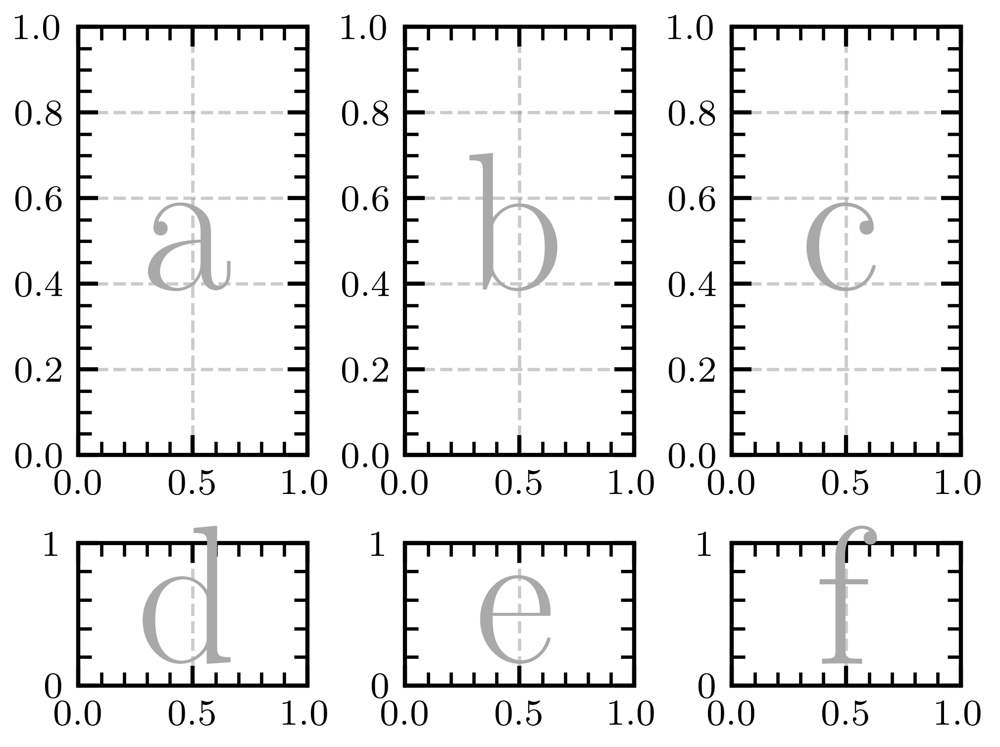

In [47]:
axd = plt.figure(layout="constrained").subplot_mosaic(
    """
    abc
    abc
    def
    """,
    # set the height ratios between the rows
    #height_ratios=[1, 3.5, 1],
    gridspec_kw={'height_ratios': [2, 1, 1]},
    # set the width ratios between the columns
#    width_ratios=[1, 3.5, 1],
)
identify_axes(axd)

# Figure 2: FSD, SIC, ITD, PDFS

In [10]:
# Read in the dataframes
df_all = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/kmeans_'+str(year)+'.csv') for year in tqdm(range(2010,2020))), ignore_index=True)
df_all_raw = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/raw_'+str(year)+'.csv') for year in tqdm(range(2010,2020))), ignore_index=True)
df_all_raw['k'] = df_all['k']


100%|██████████| 10/10 [00:29<00:00,  2.99s/it]

100%|██████████| 10/10 [00:22<00:00,  2.24s/it]


In [17]:
# Statistics of the distributions
#df_all_raw.groupby('k')['fsdrad'].mean()

mask = df_all_raw['hi'] < 0.5
df_temp = df_all_raw.copy()
df_temp['hi_lt_05'] = mask

mask = df_all_raw['hi'] > 1.0
df_temp['hi_gt_10'] = mask
#print(mask.mean())
df_temp.groupby('k').mean(numeric_only=True)


mask = df_all_raw['fsdrad'] > 100.0
df_temp['ra_gt_100'] = mask
#print(mask.mean())
df_temp.groupby('k').mean(numeric_only=True)



,Unnamed: 0,aice,hi,hs,fsdrad,iage,alvl,longitude,latitude,hi_lt_05,hi_gt_10,ra_gt_100
k,,,,,,,,,,,,
0,3.242580e+06,0.788902,0.372849,0.033066,26.890073,0.284367,0.710025,184.317786,-63.558271,0.784948,0.062748,0.055726
1,3.534458e+06,0.986465,0.814494,0.144647,269.680536,0.300852,0.817661,184.637539,-65.254142,0.270559,0.238879,0.872374
2,4.166244e+06,0.963794,1.422525,0.223648,714.150553,0.445084,0.706839,220.371025,-70.354238,0.054800,0.757080,1.000000


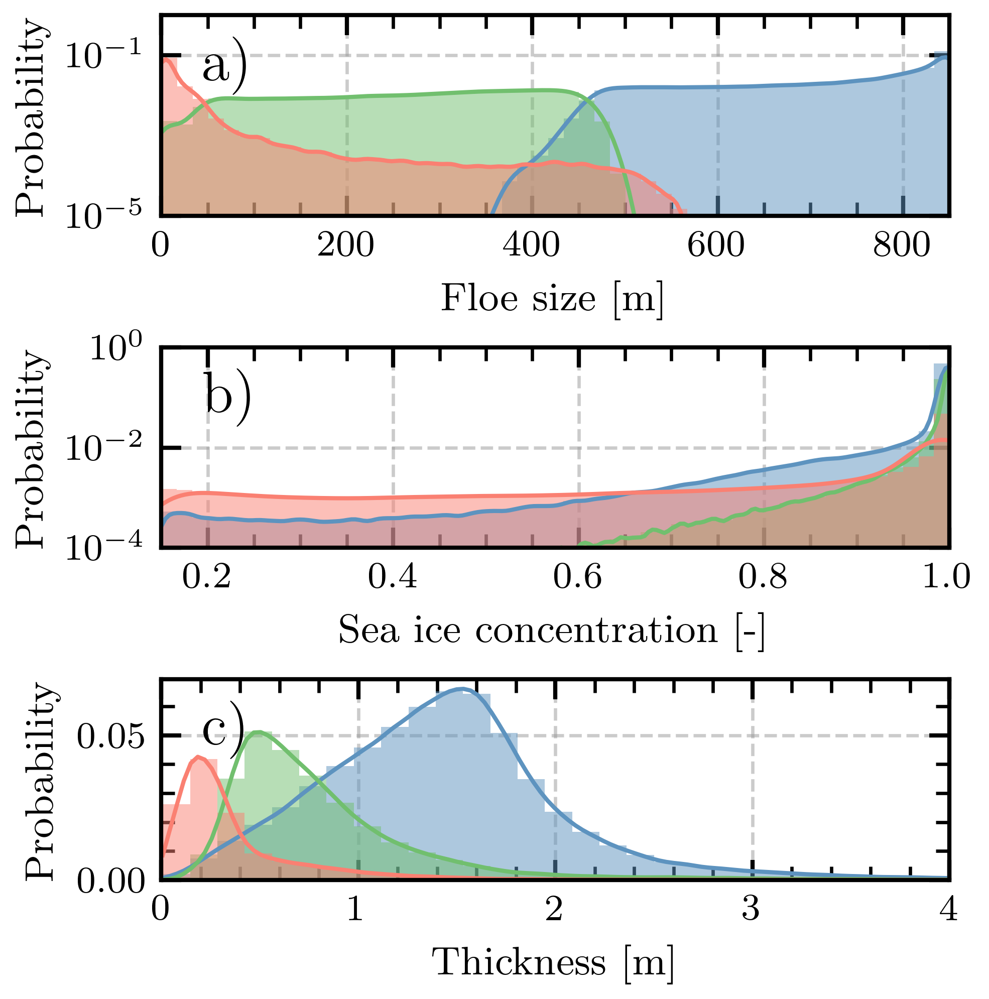

In [8]:
n_bins = 51
fig, axes = plt.subplots(3, 1, figsize=(width/2,height*(2/3)), sharey=False)

df_plot = df_all_raw.sample(n=1000000)

trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)

sns.histplot(ax=axes[0], data=df_plot, x="fsdrad", hue="k", 
             kde=True, legend=False,
             palette=[(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)],
             bins=n_bins, stat='probability',
             line_kws={'lw': 1, 'ls': '-'},
             edgecolor=None, alpha = 0.5,
             cbar_kws=dict(edgecolor="black", linewidth=0))
             #binwidth = 0.33)#, line_kws={'lw': 0.25, 'color': (0.9805, 0.5000, 0.4453, 1.0)},
             #alpha=0.5,color=(0.9805, 0.5000, 0.4453, 1.0))
axes[0].set_yscale('log')
axes[0].set_xlabel('Floe size [m]')
axes[0].set_ylim((0.00001, 1.0))
axes[0].set_xlim((0, 850))

sns.histplot(ax=axes[1], data=df_plot, x="aice", hue="k",
             kde=True, legend=False,
             bins=n_bins, stat='probability',
             line_kws={'lw': 1, 'ls': '-'},
             edgecolor=None, alpha = 0.5,
            palette=[(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)])
axes[1].set_yscale('log')
#axes[1].set_ylabel('')
axes[1].set_xlabel('Sea ice concentration [-]')
axes[1].set_ylim((0.0001, 1.0))
axes[1].set_xlim((0.15, 1))


sns.histplot(ax=axes[2], data=df_plot, x="hi", hue="k", 
             kde=True, legend=False,
             bins=n_bins, stat='probability',
             line_kws={'lw': 1, 'ls': '-'},
             edgecolor=None, alpha = 0.5,
            palette=[(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)])
axes[2].set_yscale('linear')
#axes[2].set_ylabel('')
axes[2].set_xlabel('Thickness [m]')
#axes[2].set_ylim((0.00001, 0.01))
axes[2].set_xlim((0, 4))

# axes[2].legend(['Cluster 1','Cluster 2','Cluster 3'], fancybox=False, edgecolor="black")
# leg = axes[2].get_legend()
# leg.legendHandles[0].set_color((0.9805, 0.5000, 0.4453, 1.0))
# leg.legendHandles[1].set_color((0.4416, 0.7490, 0.4322, 1.0))
# leg.legendHandles[2].set_color((0.3639, 0.5755, 0.748, 1.0))
fig.tight_layout(pad=0.25)

axes[0].text(0.0, 1.0, 'a)', transform=axes[0].transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
axes[1].text(0.0, 1.0, 'b)', transform=axes[1].transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
axes[2].text(0.0, 1.0, 'c)', transform=axes[2].transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'fsd_dist.png', dpi = 600, bbox_inches="tight")
plt.savefig(savepath+'fsd_dist.pdf')

In [12]:
from sklearn.datasets import load_wine
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.cluster import KMeans
import textwrap
plt.rcParams["axes.axisbelow"] = False

class ComplexRadar():
    """
    Create a complex radar chart with different scales for each variable

    Parameters
    ----------
    fig : figure object
        A matplotlib figure object to add the axes on
    variables : list
        A list of variables
    ranges : list
        A list of tuples (min, max) for each variable
    n_ring_levels: int, defaults to 5
        Number of ordinate or ring levels to draw
    show_scales: bool, defaults to True
        Indicates if we the ranges for each variable are plotted

    """
    def __init__(self, fig, variables, ranges, n_ring_levels=5, show_scales=True):
        # Calculate angles and create for each variable an axes
        # Consider here the trick with having the first axes element twice (len+1)
        angles = np.arange(0, 360, 360./len(variables))
        # 0.125
        # 0.10999999999999999
        # 0.35227272727272724
        # 0.77
        axes = [fig.add_axes([0.125,0.10999,0.352*0.8,0.87], polar=True, label = "axes{}".format(i)) for i in range(len(variables)+1)]
        
        # Ensure clockwise rotation (first variable at the top N)
        for ax in axes:
            ax.set_theta_zero_location('N')
            ax.set_theta_direction(-1)
            ax.set_axisbelow(True)
        
        # Writing the ranges on each axes
        for i, ax in enumerate(axes):

            # Here we do the trick by repeating the first iteration
            j = 0 if (i==0 or i==1) else i-1
            ax.set_ylim(*ranges[j])
            # Set endpoint to True if you like to have values right before the last circle
            grid = np.linspace(*ranges[j], num=n_ring_levels, 
                               endpoint=False)
            # gridlabel = ["{}".format(round(x,1)) for x in grid]
            gridlabel = ['{:.3g}'.format(x) for x in grid]

#            gridlabel = ["{}" for x in grid]
            gridlabel[0] = "" # remove values from the center
            lines, labels = ax.set_rgrids(grid, labels=gridlabel, angle=angles[j], fontsize=8)
            
            ax.set_ylim(*ranges[j])
            ax.spines["polar"].set_visible(False)
            ax.grid(visible=False)
            
            if show_scales == False:
                ax.set_yticklabels([])

        # Set all axes except the first one unvisible
        for ax in axes[1:]:
            ax.patch.set_visible(False)
            ax.xaxis.set_visible(False)
            
            
        # Setting the attributes
        self.angle = np.deg2rad(np.r_[angles, angles[0]])
        self.ranges = ranges
        self.ax = axes[0]
        self.ax1 = axes[1]
        self.plot_counter = 0
        
        # Draw (inner) circles and lines
        self.ax.yaxis.grid()
        self.ax.xaxis.grid()

        # Draw outer circle
        self.ax.spines['polar'].set_visible(True)
        
        
        # ax1 is the duplicate of axes[0] (self.ax)
        # Remove everything from ax1 except the plot itself
        self.ax1.axis('off')
        self.ax1.set_zorder(9)
        
        
        # Create the outer labels for each variable
        l, text = self.ax.set_thetagrids(angles, labels=variables)
        
        # Beautify them
        labels = [t.get_text() for t in self.ax.get_xticklabels()]
        labels = ['\n'.join(textwrap.wrap(l, 10, 
                                          break_long_words=False)) for l in labels]
        self.ax.set_xticklabels(labels)
        
        for t,a in zip(self.ax.get_xticklabels(),angles):
            if a == 0:
                t.set_ha('center')
            elif a > 0 and a < 180:
                t.set_ha('center') # can be left or right
            elif a == 180:
                t.set_ha('center')
            else:
                t.set_ha('center')

        self.ax.tick_params(axis='both', pad=15, zorder=3)


    def _scale_data(self, data, ranges):
        """Scales data[1:] to ranges[0]"""
        for d, (y1, y2) in zip(data[1:], ranges[1:]):
            assert (y1 <= d <= y2) or (y2 <= d <= y1)
        x1, x2 = ranges[0]
        d = data[0]
        sdata = [d]
        for d, (y1, y2) in zip(data[1:], ranges[1:]):
            sdata.append((d-y1) / (y2-y1) * (x2 - x1) + x1)
        return sdata
        
    def plot(self, data, *args, **kwargs):
        """Plots a line"""
        sdata = self._scale_data(data, self.ranges)
        self.ax1.plot(self.angle, np.r_[sdata, sdata[0]], *args, **kwargs)
        self.plot_counter = self.plot_counter+1
    
    def fill(self, data, *args, **kwargs):
        """Plots an area"""
        sdata = self._scale_data(data, self.ranges)
        self.ax1.fill(self.angle, np.r_[sdata, sdata[0]], *args, **kwargs)
        
    def use_legend(self, *args, **kwargs):
        """Shows a legend"""
        self.ax1.legend(*args, **kwargs)
    
    def set_title(self, title, pad=25, **kwargs):
        """Set a title"""
        self.ax.set_title(title,pad=pad, **kwargs)

In [15]:
#min_max_per_variable
df_plot = df_all_raw.sample(n=1000000)
df_plot = df_plot.drop(columns='alvl')

df_plot.groupby('k').mean(numeric_only=True)


,Unnamed: 0,aice,hi,hs,fsdrad,iage,longitude,latitude
k,,,,,,,,
0,3.247675e+06,0.790173,0.374107,0.033098,26.754338,0.284315,184.027827,-63.547407
1,3.532467e+06,0.986642,0.814234,0.144707,269.351610,0.299851,184.461917,-65.249739
2,4.164729e+06,0.963874,1.423409,0.223684,714.284258,0.445127,220.517443,-70.365102


In [ ]:
df_plot

/jobfs/98220799.gadi-pbs/ipykernel_1243930/590687329.py:104: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(pad=0.25)


<Figure size 1987.88x1987.88 with 0 Axes>

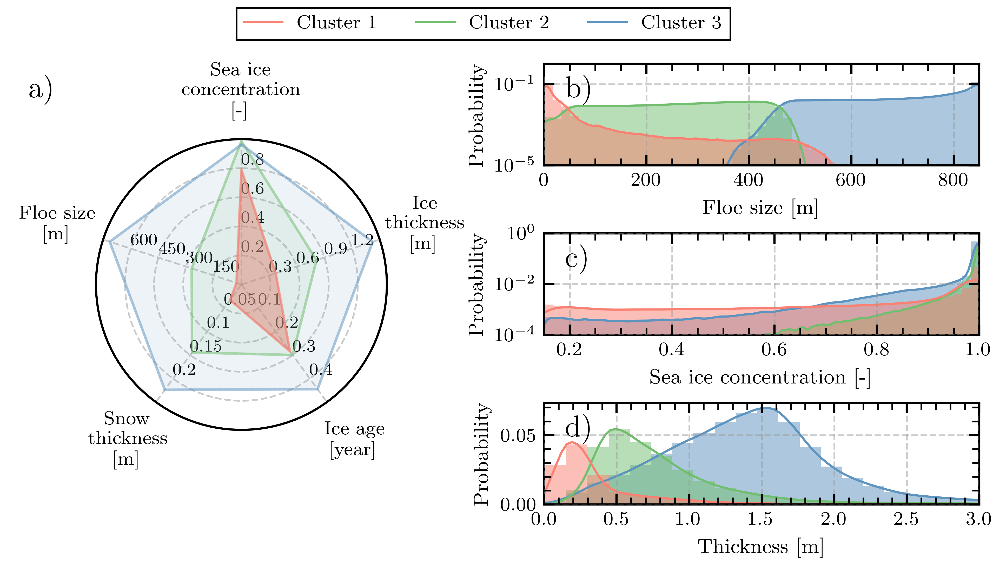

In [21]:
# 5 variables
#df_all_raw.drop(columns='alvl')
cice_dict = {'aice': 'Sea ice concentration [-]',
             'fsdrad': 'Floe size [m]',
             'hi': 'Ice thickness [m]',
             'hs': 'Snow thickness [m]',
             'iage': 'Ice age [year]',
            }

import math

n_bins = 51

df_plot = df_all_raw.sample(n=1000000)
df_plot = df_plot.drop(columns='alvl')
var_idx = [1, 2, 5, 3, 4]

radar_cmap = [(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)]
min_max_per_variable = df_plot.describe().T[['min', 'max']]
min_max_per_variable = min_max_per_variable[1:-3]
min_max_per_variable['min'] = [0, 0, 0, 0, 0] # aice, hi, hs, fsdrad, iage, alvl
min_max_per_variable['max'] = [1.0, 1.5, 0.5, 0.25, 750.0] # aice, hi, hs, fsdrad, iage

result = df_plot.groupby('k').mean(numeric_only=True)
result = result.iloc[:,var_idx]
var_tmp = result.columns#[var_idx]
variables = []
variables += (cice_dict[var_tmp[i]] for i in range(0,len(var_tmp)))

ranges = list(min_max_per_variable.itertuples(index=False, name=None))   

fig1 = plt.figure(figsize=(width/2, height*(2/3)))
fig = plt.figure(figsize=(width, height*(2/3)))#, sharex=False)


ax1 = plt.subplot(1,2,1)
ax2 = plt.subplot(3,2,2)
ax3 = plt.subplot(3,2,4)
ax4 = plt.subplot(3,2,6)
axes = [ax1, ax2, ax3, ax4]



radar = ComplexRadar(fig, variables, ranges, show_scales=True)


for k in range(0,3):
    radar.plot(result.iloc[k,:].values, label=f"Cluster {k+1}", color=radar_cmap[k], linestyle='solid', alpha=0.5)
    if k == 0:
        radar.fill(result.iloc[k,:].values, alpha=0.5, color=radar_cmap[k])
    elif k == 1:
        radar.fill(result.iloc[k,:].values, alpha=0.1, color=radar_cmap[k])
    elif k == 2:
        radar.fill(result.iloc[k,:].values, alpha=0.1, color=radar_cmap[k])


#radar.set_title("Radar chart solution with different scales")
#radar.use_legend(loc='upper left', bbox_to_anchor=(0.15, -0.25),ncol=radar.plot_counter)#fancybox=False)
#plt.show() 

sns.histplot(ax=axes[1], data=df_plot, x="fsdrad", hue="k", 
             kde=True, legend=False,
             palette=[(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)],
             bins=n_bins, stat='probability',
             line_kws={'lw': 1, 'ls': '-'},
             edgecolor=None, alpha = 0.5,
             cbar_kws=dict(edgecolor="black", linewidth=0))
             #binwidth = 0.33)#, line_kws={'lw': 0.25, 'color': (0.9805, 0.5000, 0.4453, 1.0)},
             #alpha=0.5,color=(0.9805, 0.5000, 0.4453, 1.0))
axes[1].set_ylim((0.00001, 1.0))
inset_yticks = [0.00001, 0.001, 0.1]
axes[1].set_yticks(inset_yticks)
axes[1].set_yscale('log')
axes[1].set_xlabel('Floe size [m]')

axes[1].set_xlim((0, 850))


sns.histplot(ax=axes[2], data=df_plot, x="aice", hue="k",
             kde=True, legend=False,
             bins=n_bins, stat='probability',
             line_kws={'lw': 1, 'ls': '-'},
             edgecolor=None, alpha = 0.5,
            palette=[(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)])
axes[2].set_yscale('log')
#axes[1].set_ylabel('')
axes[2].set_xlabel('Sea ice concentration [-]')
axes[2].set_ylim((0.0001, 1.0))
axes[2].set_xlim((0.15, 1))


sns.histplot(ax=axes[3], data=df_plot, x="hi", hue="k", 
             kde=True, legend=False,
             bins=n_bins, stat='probability',
             line_kws={'lw': 1, 'ls': '-'},
             edgecolor=None, alpha = 0.5,
            palette=[(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)])
axes[3].set_yscale('linear')
#axes[2].set_ylabel('')
axes[3].set_xlabel('Thickness [m]')
#axes[2].set_ylim((0.00001, 0.01))
axes[3].set_xlim((0, 3))

fig.tight_layout(pad=0.25)

ax1.set_axis_off()

trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
ax1.text(0.0, 1.0, 'a)', transform=axes[0].transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax2.text(0.0, 1.0, 'b)', transform=axes[1].transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax3.text(0.0, 1.0, 'c)', transform=axes[2].transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax4.text(0.0, 1.0, 'd)', transform=axes[3].transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))

# Create a legend
from matplotlib.lines import Line2D
import matplotlib.patches as mpatches

# access legend objects automatically created from data
handles, labels = ax1.get_legend_handles_labels()

# create manual symbols for legend
#patch = mpatches.Patch(color='grey', label='manual patch')   
#line = Line2D([0], [0], label='manual line', color='k')
#point = Line2D([0], [0], label='manual point', marker='s', markersize=10, 
#         markeredgecolor='r', markerfacecolor='k', linestyle='')
line1 = Line2D([0], [0], label='Cluster 1', color=radar_cmap[0])
line2 = Line2D([0], [0], label='Cluster 2', color=radar_cmap[1])
line3 = Line2D([0], [0], label='Cluster 3', color=radar_cmap[2])
                                                             

# add manual symbols to auto legend
handles.extend([line1, line2, line3])
plt.legend(handles=handles, ncol=3, fancybox=False, edgecolor="black", loc="center", bbox_to_anchor=(0.5, 1.05), bbox_transform=fig.transFigure)
#[0.125,0.10999,0.352*0.8,0.77*0.8]
#bbox_to_anchor=(1, 1), bbox_transform=fig.transFigure

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'spider_pdf.png', dpi = 600, bbox_inches="tight")
plt.savefig(savepath+'spider_pdf.pdf')

plt.show()

/jobfs/97247614.gadi-pbs/ipykernel_779787/1381763840.py:107: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(pad=0.25)


<Figure size 1987.88x1987.88 with 0 Axes>

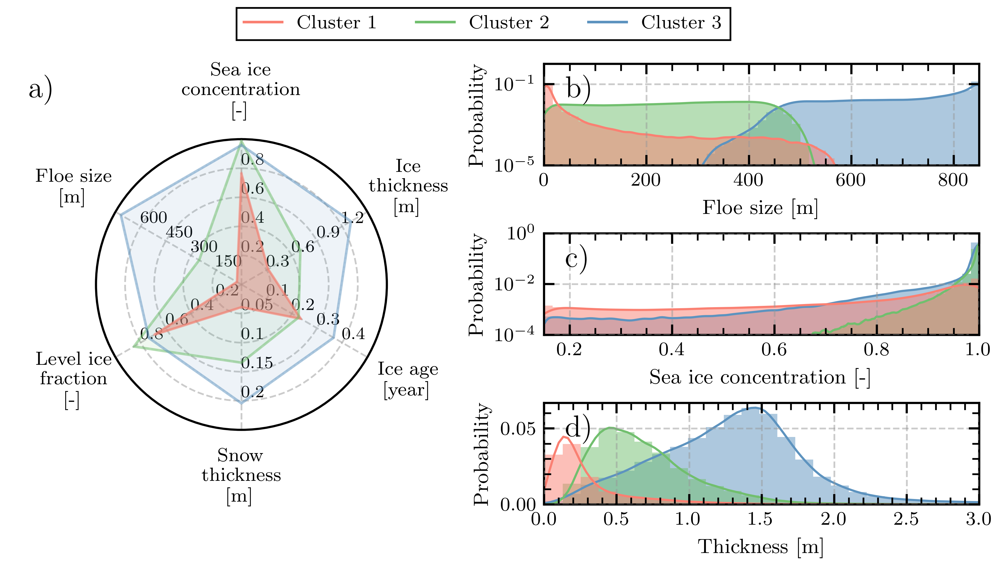

In [14]:
cice_dict = {'aice': 'Sea ice concentration [-]',
             'fsdrad': 'Floe size [m]',
             'hi': 'Ice thickness [m]',
             'hs': 'Snow thickness [m]',
             'iage': 'Ice age [year]',
             'alvl': 'Level ice fraction [-]',
            }

import math

n_bins = 51

df_plot = df_all_raw.sample(n=1000000)
var_idx = [1, 2, 5, 3, 6, 4]

radar_cmap = [(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)]
min_max_per_variable = df_plot.describe().T[['min', 'max']]
min_max_per_variable = min_max_per_variable[1:-3]
min_max_per_variable['min'] = [0, 0, 0, 0, 0, 0] # aice, hi, hs, fsdrad, iage, alvl
# aice, fsdrad, iage, hs, alvl, hi
#min_max_per_variable['min'].apply(lambda x: int(x))
min_max_per_variable['max'] = [1.0, 1.5, 0.5, 0.25, 1.0, 750.0] # aice, hi, hs, fsdrad, iage, alvl
# array([ 0.74869581, 25.2903551 ,  0.27067625,  0.03827766,  0.66506514,
      #  0.35345026])
#min_max_per_variable['max'].apply(lambda x: math.ceil(x))

result = df_plot.groupby('k').mean(numeric_only=True)
result = result.iloc[:,var_idx]
var_tmp = result.columns#[var_idx]
variables = []
variables += (cice_dict[var_tmp[i]] for i in range(0,len(var_tmp)))

ranges = list(min_max_per_variable.itertuples(index=False, name=None))   

fig1 = plt.figure(figsize=(width/2, height*(2/3)))
fig = plt.figure(figsize=(width, height*(2/3)))#, sharex=False)


ax1 = plt.subplot(1,2,1)
ax2 = plt.subplot(3,2,2)
ax3 = plt.subplot(3,2,4)
ax4 = plt.subplot(3,2,6)
axes = [ax1, ax2, ax3, ax4]



radar = ComplexRadar(fig, variables, ranges, show_scales=True)


for k in range(0,3):
    radar.plot(result.iloc[k,:].values, label=f"Cluster {k+1}", color=radar_cmap[k], linestyle='solid', alpha=0.5)
    if k == 0:
        radar.fill(result.iloc[k,:].values, alpha=0.5, color=radar_cmap[k])
    elif k == 1:
        radar.fill(result.iloc[k,:].values, alpha=0.1, color=radar_cmap[k])
    elif k == 2:
        radar.fill(result.iloc[k,:].values, alpha=0.1, color=radar_cmap[k])


#radar.set_title("Radar chart solution with different scales")
#radar.use_legend(loc='upper left', bbox_to_anchor=(0.15, -0.25),ncol=radar.plot_counter)#fancybox=False)
#plt.show() 

sns.histplot(ax=axes[1], data=df_plot, x="fsdrad", hue="k", 
             kde=True, legend=False,
             palette=[(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)],
             bins=n_bins, stat='probability',
             line_kws={'lw': 1, 'ls': '-'},
             edgecolor=None, alpha = 0.5,
             cbar_kws=dict(edgecolor="black", linewidth=0))
             #binwidth = 0.33)#, line_kws={'lw': 0.25, 'color': (0.9805, 0.5000, 0.4453, 1.0)},
             #alpha=0.5,color=(0.9805, 0.5000, 0.4453, 1.0))
axes[1].set_ylim((0.00001, 1.0))
inset_yticks = [0.00001, 0.001, 0.1]
axes[1].set_yticks(inset_yticks)
axes[1].set_yscale('log')
axes[1].set_xlabel('Floe size [m]')

axes[1].set_xlim((0, 850))


sns.histplot(ax=axes[2], data=df_plot, x="aice", hue="k",
             kde=True, legend=False,
             bins=n_bins, stat='probability',
             line_kws={'lw': 1, 'ls': '-'},
             edgecolor=None, alpha = 0.5,
            palette=[(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)])
axes[2].set_yscale('log')
#axes[1].set_ylabel('')
axes[2].set_xlabel('Sea ice concentration [-]')
axes[2].set_ylim((0.0001, 1.0))
axes[2].set_xlim((0.15, 1))


sns.histplot(ax=axes[3], data=df_plot, x="hi", hue="k", 
             kde=True, legend=False,
             bins=n_bins, stat='probability',
             line_kws={'lw': 1, 'ls': '-'},
             edgecolor=None, alpha = 0.5,
            palette=[(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)])
axes[3].set_yscale('linear')
#axes[2].set_ylabel('')
axes[3].set_xlabel('Thickness [m]')
#axes[2].set_ylim((0.00001, 0.01))
axes[3].set_xlim((0, 3))

fig.tight_layout(pad=0.25)

ax1.set_axis_off()

trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
ax1.text(0.0, 1.0, 'a)', transform=axes[0].transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax2.text(0.0, 1.0, 'b)', transform=axes[1].transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax3.text(0.0, 1.0, 'c)', transform=axes[2].transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax4.text(0.0, 1.0, 'd)', transform=axes[3].transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))

#plt.legend(['Cluster 1','Cluster 2','Cluster 3'], fancybox=False, edgecolor="black")
#legend = ax1.legend(['Cluster 1','Cluster 2','Cluster 3'], fancybox=False, edgecolor="black")
#radar.use_legend(loc='upper left', ncol=radar.plot_counter)#fancybox=False)


# Create a legend
from matplotlib.lines import Line2D
import matplotlib.patches as mpatches

# from data
#plt.plot([1,2,3,4], [10,20,30,40], label='My Data (line)', color='red')
#plt.scatter([2.5], [15], label='My Data (scatter point)', color='b') # plotting single point via scatter
#plt.plot([3.5], [20], label= ' My Data (plot point)', marker='o', markersize=10, 
#         markeredgecolor='k', markerfacecolor='g', linestyle='') # plotting single point via plot with null linestyle

# access legend objects automatically created from data
handles, labels = ax1.get_legend_handles_labels()

# create manual symbols for legend
#patch = mpatches.Patch(color='grey', label='manual patch')   
#line = Line2D([0], [0], label='manual line', color='k')
#point = Line2D([0], [0], label='manual point', marker='s', markersize=10, 
#         markeredgecolor='r', markerfacecolor='k', linestyle='')
line1 = Line2D([0], [0], label='Cluster 1', color=radar_cmap[0])
line2 = Line2D([0], [0], label='Cluster 2', color=radar_cmap[1])
line3 = Line2D([0], [0], label='Cluster 3', color=radar_cmap[2])
                                                             

# add manual symbols to auto legend
handles.extend([line1, line2, line3])
plt.legend(handles=handles, ncol=3, fancybox=False, edgecolor="black", loc="center", bbox_to_anchor=(0.5, 1.05), bbox_transform=fig.transFigure)
#[0.125,0.10999,0.352*0.8,0.77*0.8]
#bbox_to_anchor=(1, 1), bbox_transform=fig.transFigure

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'spider_pdf.png', dpi = 600, bbox_inches="tight")
plt.savefig(savepath+'spider_pdf.pdf')

plt.show()

# Figure 3: Variable sensitivity

NameError: name 'ax' is not defined

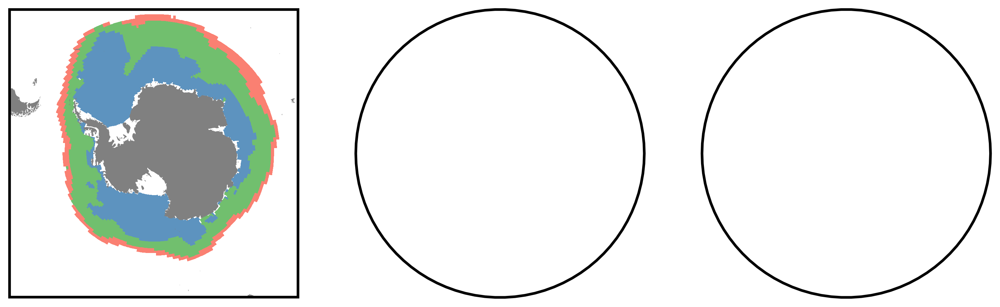

In [11]:
day = 237
# Preparation for maps ---------
filename = '/g/data/ia40/cice-dirs/runs/waves-10/history/iceh.'+str(year)+'-08-25.nc'
ds = xr.open_dataset(filename)
tmask = ds['tmask'][:,:]
# Define the contour levels to use in plt.contourf
clevs=np.arange(0,5,1)
coord_lims = [-180, 180, -50, -90]
# Make a colormap
cmap = mpl.colors.ListedColormap([(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)])
# define the bins and normalize
bounds = np.linspace(0, 3, 4)
tick_labels = ['1', '2', '3']
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
# Make the map
land_50m = cft.NaturalEarthFeature('physical', 'land', '50m',
                        edgecolor='none', facecolor='gray', linewidth=0.5)


fig, axs = plt.subplot_mosaic([['a)','b)','c)']],
                              subplot_kw={'projection': ccrs.SouthPolarStereo()},
                              figsize=(width,height))

for label, ax in axs.items():
    ax.set_extent(coord_lims, ccrs.PlateCarree())
    land_50m = cft.NaturalEarthFeature('physical', 'land', '50m',
                            edgecolor='none', facecolor='gray', linewidth=0.5)
    ax.add_feature(land_50m)
    if label == 'a)':
        readfilename='/g/data/ia40/sea-ice-classification/kmean_2019.nc'
        ds = xr.open_dataset(readfilename)
        # March 1st
        read_data = ds['k'][0,:,:]
        cmaptmp = cmap
    elif label == 'b)':
        readfilename='/g/data/ia40/sea-ice-classification/kmean_3_4_2019.nc'
        ds = xr.open_dataset(readfilename)
        read_data = ds['k'][0,:,:]
        cmaptmp = mpl.colors.ListedColormap([(0.3639, 0.5755, 0.748, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.9805, 0.5000, 0.4453, 1.0)])
    elif label == 'c)':
        readfilename='/g/data/ia40/sea-ice-classification/kmean_nofsd_2019.nc'
        ds = xr.open_dataset(readfilename)
        read_data = ds['k'][0,:,:]
        cmaptmp = cmap
    elif label == 'd)':
        # September 1st
        readfilename='/g/data/ia40/sea-ice-classification/kmean_2019.nc'
        ds = xr.open_dataset(readfilename)
        read_data = ds['k'][day,:,:]
        cmaptmp = cmap
    elif label == 'e)':
        readfilename='/g/data/ia40/sea-ice-classification/kmean_nofsd_2019.nc'
        ds = xr.open_dataset(readfilename)
        read_data = ds['k'][day,:,:]
        cmaptmp = mpl.colors.ListedColormap([(0.3639, 0.5755, 0.748, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.9805, 0.5000, 0.4453, 1.0)])
    elif label == 'f)':
        readfilename='/g/data/ia40/sea-ice-classification/kmean_3_1235_2019.nc'
        ds = xr.open_dataset(readfilename)
        read_data = ds['k'][day,:,:]
        cmaptmp = cmap
    plot_data = ds['k'][day,:,:]
    cs = ax.pcolormesh(ds['LON'][:,:], ds['LAT'][:,:], plot_data,
                transform=ccrs.PlateCarree(),
                cmap=cmaptmp,
                norm=norm,
                shading='auto')
    ax.set_extent(coord_lims, ccrs.PlateCarree())
    add_subplot_label(fig, label)
    
        
pos1 = ax.get_position()
fig.subplots_adjust(right=0.9)
cbar_ax = fig.add_axes([pos1.x0 + pos1.width + 0.01, pos1.y0, 0.01, pos1.height])
cbar = fig.colorbar(cs, cax=cbar_ax,orientation='vertical', label='Cluster number') 
cbar.set_ticks(bounds[0:-1]+0.5)
tick_texts = cbar.ax.set_yticklabels(tick_labels)
#fig.tight_layout()

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'variable_sensitivity.png', dpi = 300, bbox_inches='tight') 
plt.savefig(savepath+'variable_sensitivity.pdf', bbox_inches='tight')  
plt.show()

In [9]:
cmap[1, 0, 2]

TypeError: 'ListedColormap' object is not subscriptable

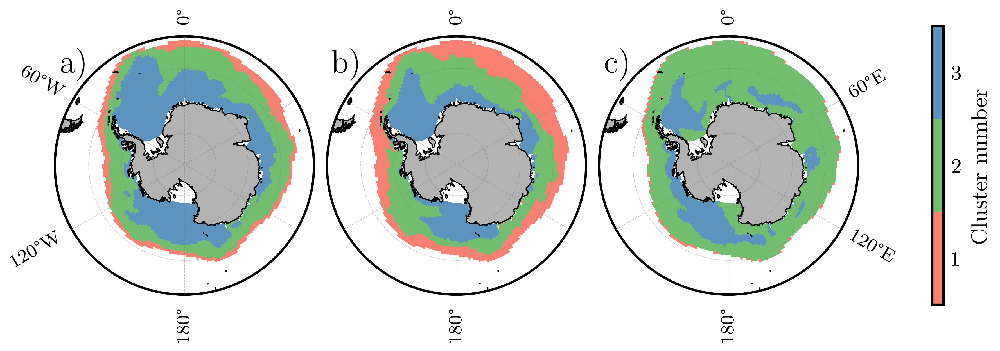

In [12]:
day = 237 # 26 August
# Preparation for maps ---------
filename = '/g/data/ia40/cice-dirs/runs/waves-10/history/iceh.'+str(year)+'-08-25.nc'
ds = xr.open_dataset(filename)
tmask = ds['tmask'][:,:]
# Define the contour levels to use in plt.contourf
clevs=np.arange(0,5,1)
coord_lims = [-180, 180, -50, -90]
# Make a colormap
cmap = mpl.colors.ListedColormap([(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)])
# define the bins and normalize
bounds = np.linspace(0, 3, 4)
tick_labels = ['1', '2', '3']
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
# Make the map
fig = plt.figure(figsize=[width, height])
ax1 = fig.add_subplot(1, 3, 1, projection=ccrs.SouthPolarStereo())
ax2 = fig.add_subplot(1, 3, 2, projection=ccrs.SouthPolarStereo(), sharex=ax1, sharey=ax1)
ax3 = fig.add_subplot(1, 3, 3, projection=ccrs.SouthPolarStereo(), sharex=ax1, sharey=ax1)
ax1 = create_map_axis(ax=ax1, LN=LN, LT=LT, land_mask=land_mask, draw_labels="left")
ax2 = create_map_axis(ax=ax2, LN=LN, LT=LT, land_mask=land_mask, draw_labels="middle")
ax3 = create_map_axis(ax=ax3, LN=LN, LT=LT, land_mask=land_mask, draw_labels="right")
#fig.subplots_adjust(bottom=0.05, top=0.95, left=0.04, right=0.95, wspace=0.02)
fig.subplots_adjust(wspace=0.05)


# Panel a)

# September 1st
readfilename='/g/data/ia40/sea-ice-classification/kmean_2019.nc'
ds = xr.open_dataset(readfilename)
read_data = ds['k'][day,:,:]
cmaptmp = cmap
plot_data = ds['k'][day,:,:]
cs = ax1.pcolormesh(ds['LON'][:,:], ds['LAT'][:,:], plot_data,
            transform=ccrs.PlateCarree(),
            cmap=cmaptmp,
            norm=norm,
            shading='auto')
ax1.set_extent(coord_lims, ccrs.PlateCarree())


# Panel b)
readfilename='/g/data/ia40/sea-ice-classification/kmean_3_just_floesize_2019.nc'
ds = xr.open_dataset(readfilename)
read_data = ds['k'][day,:,:]
cmaptmp = mpl.colors.ListedColormap([(0.3639, 0.5755, 0.748, 1.0), (0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0)])
plot_data = ds['k'][day,:,:]
cs = ax2.pcolormesh(ds['LON'][:,:], ds['LAT'][:,:], plot_data,
            transform=ccrs.PlateCarree(),
            cmap=cmap,
            norm=norm,
            shading='auto')
ax2.set_extent(coord_lims, ccrs.PlateCarree())


# Panel c)
readfilename='/g/data/ia40/sea-ice-classification/kmean_3_exclude_floesize_2019.nc'
ds = xr.open_dataset(readfilename)
read_data = ds['k'][day,:,:]
cmaptmp = mpl.colors.ListedColormap([(0.3639, 0.5755, 0.748, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.9805, 0.5000, 0.4453, 1.0)])
plot_data = ds['k'][day,:,:]
cs = ax3.pcolormesh(ds['LON'][:,:], ds['LAT'][:,:], plot_data,
            transform=ccrs.PlateCarree(),
            cmap=cmap,
            norm=norm,
            shading='auto')

trans = mtransforms.ScaledTranslation(2.5/72, -5/72, fig.dpi_scale_trans)
ax1.text(0.0, 1.0, 'a)', transform=ax1.transAxes + trans,
               fontsize='medium', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
trans = mtransforms.ScaledTranslation(2.0/72, -5/72, fig.dpi_scale_trans)
ax2.text(0.0, 1.0, 'b)', transform=ax2.transAxes + trans,
               fontsize='medium', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
trans = mtransforms.ScaledTranslation(2.5/72, -5/72, fig.dpi_scale_trans)
ax3.text(0.0, 1.0, 'c)', transform=ax3.transAxes + trans,
               fontsize='medium', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
        
pos1 = ax3.get_position()
fig.subplots_adjust(right=1-10/64)
cbar_ax = fig.add_axes([pos1.x0 + pos1.width + 0.01, pos1.y0, 0.01, pos1.height])
cbar = fig.colorbar(cs, cax=cbar_ax,orientation='vertical', label='Cluster number') 
cbar.set_ticks(bounds[0:-1]+0.5)
cbar.ax.tick_params(size=0)
tick_texts = cbar.ax.set_yticklabels(tick_labels)
cbar.ax.minorticks_off()
#fig.tight_layout()

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'variable_sensitivity.png', dpi = 300, bbox_inches='tight') 
plt.savefig(savepath+'variable_sensitivity.pdf', bbox_inches='tight')  
plt.show()

# Figure 4: Sea ice regions over time (maps and timeseries)

In [3]:
# Initialise arrays
n_days = 365
year_range = range(2010,2020)
SIE_MIZ = np.empty((len(year_range), n_days))
SIE_YOUNG = np.empty((len(year_range), n_days))
SIE_OLD = np.empty((len(year_range), n_days))
SIE_total = np.empty((len(year_range), n_days))

day_vec = range(0,n_days,1)

# Circumpolar for each day
for i,year in tqdm(enumerate(year_range), total = len(year_range), desc = "Reading in SIE data"):
    filename = '/g/data/ia40/sea-ice-classification/kmean_'+str(year)+'.nc'
    ds = xr.open_dataset(filename)
    for day_idx in day_vec:
        # Calculate MIZ area
        SIE_MIZ[i, day_idx] = np.multiply(ds['tarea'][:,:].data, ds['k'][day_idx,:,:].data == 0).sum()
        SIE_YOUNG[i, day_idx] = np.multiply(ds['tarea'][:,:].data, ds['k'][day_idx,:,:].data == 1).sum()
        SIE_OLD[i, day_idx] = np.multiply(ds['tarea'][:,:].data, ds['k'][day_idx,:,:].data == 2).sum()
        #SIE_total[i,day_idx] = np.multiply(ds['tarea'][:,:].data, ds['aice'][day_idx,:,:].data > 0.15).sum()*(1/len(year_range))
del ds

df_miz_ts = pd.DataFrame({"date": pd.date_range(start="2019-01-01",end="2019-12-31"),
                          "1": SIE_MIZ.mean(axis=0)*(0.000000000001),
                          "2": SIE_YOUNG.mean(axis=0)*(0.000000000001),
                          "3": SIE_OLD.mean(axis=0)*(0.000000000001)})
pd.DataFrame(df_miz_ts).to_csv('/g/data/ia40/sea-ice-classification/dataframes/sea_ice_extent_kmeans' + '.csv')

Reading in SIE data: 100%|██████████| 10/10 [00:33<00:00,  3.34s/it]


In [3]:
year = 2019
#readfilename='/g/data/ia40/sea-ice-classification/plot_maps.nc'
readfilename='/g/data/ia40/sea-ice-classification/kmean_2019.nc'
ds = xr.open_dataset(readfilename)
plot_data = ds['k'][200,:,:]
# cs = ax1.pcolormesh(ds['LON'][:,:], ds['LAT'][:,:], plot_data,
#             transform=ccrs.PlateCarree(),
#             cmap=cmap,
#             norm=norm,
#             shading='auto')
#del ds

In [14]:
dt.datetime(2019, 2, 14)

df_miz_ts['date'][44]

'2019-02-14'

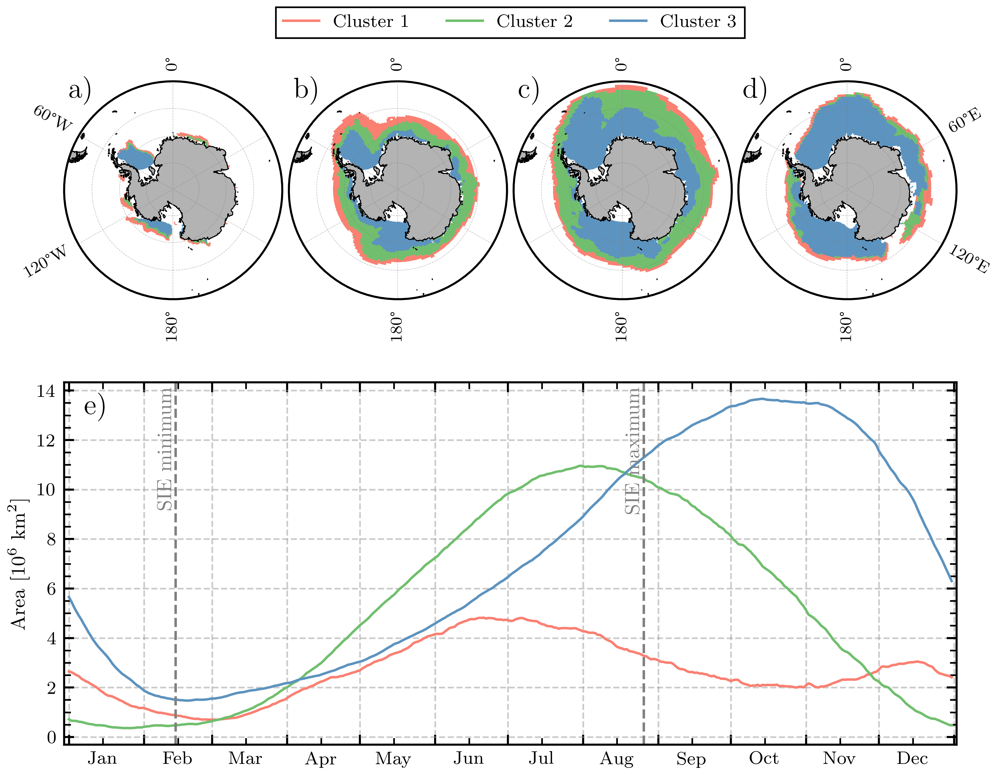

In [15]:
# -----
#readfilename='/g/data/ia40/sea-ice-classification/kmean_2019.nc'
#ds = xr.open_dataset(readfilename)
#LT = ds['LAT']
#LN = ds['LON']
df_miz_ts = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/sea_ice_extent_kmeans.csv')

fig = plt.figure(figsize=[width, height])

ax1 = fig.add_subplot(2, 4, 1, projection=ccrs.SouthPolarStereo())
ax2 = fig.add_subplot(2, 4, 2, projection=ccrs.SouthPolarStereo(), sharex=ax1, sharey=ax1)
ax3 = fig.add_subplot(2, 4, 3, projection=ccrs.SouthPolarStereo(), sharex=ax1, sharey=ax1)
ax4 = fig.add_subplot(2, 4, 4, projection=ccrs.SouthPolarStereo(), sharex=ax1, sharey=ax1)
ax5 = fig.add_subplot(2, 1, 2)

ax1 = create_map_axis(ax=ax1, LN=LN, LT=LT, land_mask=land_mask, draw_labels="left")
ax2 = create_map_axis(ax=ax2, LN=LN, LT=LT, land_mask=land_mask, draw_labels="middle")
ax3 = create_map_axis(ax=ax3, LN=LN, LT=LT, land_mask=land_mask, draw_labels="middle")
ax4 = create_map_axis(ax=ax4, LN=LN, LT=LT, land_mask=land_mask, draw_labels="right")

coord_lims = [-180, 180, -45, -90]

# Make a colormap
cmap = mpl.colors.ListedColormap([(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)])

bounds = [44, 51, 53, 56]
tick_labels = ['1', '2', '3']
# define the bins and normalize
bounds = np.linspace(0, 3, 4)

norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

p = ax1.pcolormesh(LN, LT, ds['k'][31+28,:,:], # March 1st
            transform=ccrs.PlateCarree(),
            cmap=cmap,
            norm=norm,
            shading='auto')

p = ax2.pcolormesh(LN, LT, ds['k'][31+28+31+30+31,:,:], # June 1st
            transform=ccrs.PlateCarree(),
            cmap=cmap,
            norm=norm,
            shading='auto')

p = ax3.pcolormesh(LN, LT, ds['k'][31+28+31+30+31+30+30+31,:,:], # September 1st
            transform=ccrs.PlateCarree(),
            cmap=cmap,
            norm=norm,
            shading='auto')

p = ax4.pcolormesh(LN, LT, ds['k'][31+28+31+30+31+30+30+31+30+31+30,:,:], # December 1st
            transform=ccrs.PlateCarree(),
            cmap=cmap,
            norm=norm,
            shading='auto')

#fig.subplots_adjust(bottom=0.05, top=0.95,
               # left=0.04, right=0.95, wspace=0.03, hspace=0.03)
fig.subplots_adjust(bottom=0.0, top=1.0,
               left=0.04, right=0.95, wspace=0.03, hspace=0.03)

sns.lineplot(ax=ax5, x=df_miz_ts['date'], y=df_miz_ts['1'], color = (0.9805, 0.5000, 0.4453, 1.0),errorbar=None)
sns.lineplot(ax=ax5, x=df_miz_ts['date'], y=df_miz_ts['2'], color = (0.4416, 0.7490, 0.4322, 1.0),errorbar=None)
sns.lineplot(ax=ax5, x=df_miz_ts['date'], y=df_miz_ts['3'], color = (0.3639, 0.5755, 0.748, 1.0),errorbar=None)

ax5.set_xlim((np.round(ax5.get_xlim()[0]+16),np.round(ax5.get_xlim()[-1]-16)))
ax5.set_ylabel('Area [$10^6$ km$^2$]')
ax5.set_xlabel('')
#ax4.set_ylim((0,14))
#ax.axhline(y = 0.0, color = 'gray', linestyle = '-',alpha=1.0)

set_ax_date(ax5, plot_type="clim")
plt.legend(['Cluster 1','Cluster 2','Cluster 3'], fancybox=False, edgecolor="black")
sns.move_legend(ax5, "upper center", bbox_to_anchor=(.5, 2.06), ncol=3, title=None, frameon=True, fancybox=False, edgecolor='black')
import datetime as dt

plt.axvline(df_miz_ts['date'][44], label = 'SIE minimum', linestyle = '--', color='gray')
plt.axvline(df_miz_ts['date'][237], label = 'SIE maximum', linestyle = '--', color='gray')
ax5.text(df_miz_ts['date'][44], 0.99, 'SIE minimum', color='gray', ha='right', va='top', rotation=90, fontsize = 10,
            transform=ax5.get_xaxis_transform())
ax5.text(df_miz_ts['date'][237], 0.99, 'SIE maximum', color='gray', ha='right', va='top', rotation=90, fontsize = 10,
            transform=ax5.get_xaxis_transform())

#plt.axvline(dt.datetime(2019, 2, 14), label = 'SIE minimum', linestyle = '--', color='gray')
#plt.axvline(dt.datetime(2019, 8, 26), label = 'SIE maximum', linestyle = '--', color='gray')
#ax5.text(dt.datetime(2019, 2, 14), 0.99, 'SIE minimum', color='gray', ha='right', va='top', rotation=90, fontsize = 10,
#            transform=ax5.get_xaxis_transform())
#ax5.text(dt.datetime(2019, 8, 26), 0.99, 'SIE maximum', color='gray', ha='right', va='top', rotation=90, fontsize = 10,
#            transform=ax5.get_xaxis_transform())

trans = mtransforms.ScaledTranslation(2.5/72, 2.5/72, fig.dpi_scale_trans)
ax1.text(0.0, 1.0, 'a)', transform=ax1.transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax2.text(0.0, 1.0, 'b)', transform=ax2.transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax3.text(0.0, 1.0, 'c)', transform=ax3.transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax4.text(0.0, 1.0, 'd)', transform=ax4.transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
ax5.text(0.0, 1.0, 'e)', transform=ax5.transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'SIE_ts_maps.png', dpi = 300, bbox_inches='tight') 
plt.savefig(savepath+'SIE_ts_maps.pdf', bbox_inches='tight')  
plt.show()

In [ ]:
df_miz_ts = pd.DataFrame({"date": pd.date_range(start="2019-01-01",end="2019-12-31"),
                          "1": SIE_MIZ.mean(axis=0),
                          "2": SIE_YOUNG.mean(axis=0),
                          "3": SIE_OLD.mean(axis=0)})

# Preparation for maps ---------
filename = '/g/data/ia40/cice-dirs/runs/waves-10/history/iceh.'+str(year)+'-08-25.nc'
ds = xr.open_dataset(filename)
tmask = ds['tmask'][:,:]
# Define the contour levels to use in plt.contourf
clevs=np.arange(0,5,1)
coord_lims = [-180, 180, -50, -90]
# Make a colormap
cmap = mpl.colors.ListedColormap([(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)])
# define the bins and normalize
bounds = np.linspace(0, 3, 4)
tick_labels = ['1', '2', '3']
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
# Make the map
land_50m = cft.NaturalEarthFeature('physical', 'land', '50m',
                        edgecolor='none', facecolor='gray', linewidth=0.5)


fig, axs = plt.subplot_mosaic([['a)','b)','c)','d)']],
                              subplot_kw={'projection': ccrs.SouthPolarStereo()},
                              figsize=(width,height))
readfilename='/g/data/ia40/sea-ice-classification/kmean_2019.nc'
ds = xr.open_dataset(readfilename)
    
for label, ax in axs.items():
    ax.set_extent(coord_lims, ccrs.PlateCarree())
    land_50m = cft.NaturalEarthFeature('physical', 'land', '50m',
                            edgecolor='none', facecolor='gray', linewidth=0.5)
    ax.add_feature(land_50m)
    if label == 'a)':
        # March 1st
        ax1 = ax
        plot_data = ds['k'][31+28,:,:] # March 1st
        cmaptmp = cmap
    elif label == 'b)':
        plot_data = ds['k'][31+28+31+30+31,:,:] # June 1st
        cmaptmp = cmap
    elif label == 'c)':
        plot_data = ds['k'][31+28+31+30+31+30+30+31,:,:] # September 1st
        cmaptmp = cmap
    elif label == 'd)':
        plot_data = ds['k'][31+28+31+30+31+30+30+31+30+31+30,:,:] # December 1st
        cmaptmp = cmap
    cs = ax.pcolormesh(ds['LON'][:,:], ds['LAT'][:,:], plot_data,
                transform=ccrs.PlateCarree(),
                cmap=cmaptmp,
                norm=norm,
                shading='auto')
    ax.set_extent(coord_lims, ccrs.PlateCarree())
    add_subplot_label(fig, label)
    
        
pos1 = ax1.get_position()
pos2 = ax.get_position()
fig.subplots_adjust(bottom=pos1.height)
ax = fig.add_axes([pos1.x0, pos1.y0-pos1.height, pos2.x0+pos2.width-pos1.x0, pos1.height])

ax.set_ylim((0, 14))
trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
ax.text(0.0, 1.0, 'e)', transform=ax.transAxes + trans,
           fontsize='large', verticalalignment='top', fontfamily='serif',
           bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
df_miz_ts = pd.DataFrame({"date": pd.date_range(start="2019-01-01",end="2019-12-31"),
                          "1": SIE_MIZ.mean(axis=0)*(0.000000000001),
                          "2": SIE_YOUNG.mean(axis=0)*(0.000000000001),
                          "3": SIE_OLD.mean(axis=0)*(0.000000000001)})

sns.lineplot(ax=ax, x=df_miz_ts['date'], y=df_miz_ts['1'], color = (0.9805, 0.5000, 0.4453, 1.0),errorbar=None)
sns.lineplot(ax=ax, x=df_miz_ts['date'], y=df_miz_ts['2'], color = (0.4416, 0.7490, 0.4322, 1.0),errorbar=None)
sns.lineplot(ax=ax, x=df_miz_ts['date'], y=df_miz_ts['3'], color = (0.3639, 0.5755, 0.748, 1.0),errorbar=None)

ax.set_xlim((np.round(ax.get_xlim()[0]+16),np.round(ax.get_xlim()[-1]-16)))
ax.set_ylabel('Sea ice extent [$10^6$ km$^2$]')
ax.set_xlabel('')
ax.set_ylim((0,14))
#ax.axhline(y = 0.0, color = 'gray', linestyle = '-',alpha=1.0)
set_ax_date(ax, plot_type="clim")
plt.legend(['Cluster 1','Cluster 2','Cluster 3'], fancybox=False, edgecolor="black")
#sns.move_legend(ax, "lower center", bbox_to_anchor=(.5, 0.96), ncol=3, title=None, frameon=False)
sns.move_legend(ax, "lower center", bbox_to_anchor=(.5, 1.96), ncol=3, title=None, frameon=False)
#add_subplot_label(fig, 'e)')

# cbar_ax = fig.add_axes([pos1.x0 + pos1.width + 0.01, pos1.y0, 0.01, pos1.height])
# cbar = fig.colorbar(cs, cax=cbar_ax,orientation='vertical', label='Cluster number') 
# cbar.set_ticks(bounds[0:-1]+0.5)
# tick_texts = cbar.ax.set_yticklabels(tick_labels)
#fig.tight_layout()

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'SIE_ts_maps.png', dpi = 300, bbox_inches='tight') 
plt.savefig(savepath+'SIE_ts_maps.pdf', bbox_inches='tight')  
plt.show()

In [21]:
#pos2.x0+pos2.width

pos2.x0

0.7315217391304348

In [1]:
df_miz_ts = pd.DataFrame({"date": pd.date_range(start="2019-01-01",end="2019-12-31"),
                          "1": SIE_MIZ.mean(axis=0)*(0.000000000001),
                          "2": SIE_YOUNG.mean(axis=0)*(0.000000000001),
                          "3": SIE_OLD.mean(axis=0)*(0.000000000001)})
fig,axes = plt.subplot_mosaic([['a)']], layout='constrained', sharex=False, figsize=(width,height/2))
for label, ax in axes.items():
    sns.lineplot(ax=ax, x=df_miz_ts['date'], y=df_miz_ts['1'], color = (0.9805, 0.5000, 0.4453, 1.0),errorbar=None)
    sns.lineplot(ax=ax, x=df_miz_ts['date'], y=df_miz_ts['2'], color = (0.4416, 0.7490, 0.4322, 1.0),errorbar=None)
    sns.lineplot(ax=ax, x=df_miz_ts['date'], y=df_miz_ts['3'], color = (0.3639, 0.5755, 0.748, 1.0),errorbar=None)
    ax.set_xlim((np.round(ax.get_xlim()[0]+16),np.round(ax.get_xlim()[-1]-16)))
    ax.set_ylabel('Sea ice extent [$10^6$ km$^2$]')
    ax.set_xlabel('')
    ax.set_ylim((0,14))
    plt.legend(['Cluster 1','Cluster 2','Cluster 3'], fancybox=False, edgecolor="black" )#,bbox_to_anchor=(1.05, 1), loc=3, borderaxespad=0.)
    # ax.legend(['Cluster 1','Cluster 2','Cluster 3'], fancybox=False, edgecolor="black")
    # leg = ax.get_legend()
    # leg.legendHandles[0].set_color((0.9805, 0.5000, 0.4453, 1.0))
    # leg.legendHandles[1].set_color((0.4416, 0.7490, 0.4322, 1.0))
    # leg.legendHandles[2].set_color((0.3639, 0.5755, 0.748, 1.0))
    #ax.axhline(y = 0.0, color = 'gray', linestyle = '-',alpha=1.0)
    pos1 = ax.get_position()
    sns.move_legend(ax, "lower center", bbox_to_anchor=(.5, 1), ncol=3, title=None, frameon=False)
#    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    set_ax_date(ax, plot_type="clim")
plt.show()

NameError: name 'pd' is not defined

In [40]:
pos1.height

0.755

# Figure 5: MIZ width

In [40]:
# ds = xr.open_dataset('/g/data/ia40/sea-ice-classification/kmean_' + str(year) + '.nc')
# ds.k

# #print(hte_south.shape)
# #print(aice_1580.shape)
# #aice_1580

# np.empty((n_days,n_lon))
# effective_sic_mizwidth_array = np.empty((n_days,n_lon))
# effective_sic_mizwidth_array[:,:] = np.nan
# effective_sic_mizwidth_array

In [41]:
# Parameters
#year = 2019
for year in range(2010,2020):
    ds = xr.open_dataset('/g/data/ia40/sea-ice-classification/kmean_' + str(year) + '.nc')
    #tmask = ds['tmask'][:,:]
    LN = ds.LON.values
    LT = ds.LAT.values
    lat = ds.LAT
    hte = ds.HTE
    
    #lat_idx = LT[:,0] < 0
    # Initialise arrays
    n_days, n_lat,n_lon = ds.k.shape
    
    kmean_mizwidth_array = np.empty((n_days,n_lon))
    effective_kmean_mizwidth_array = np.empty((n_days,n_lon))
    effective_kmean_mizwidth_array[:,:] = np.nan
    
    sic_mizwidth_array = np.empty((n_days,n_lon))
    effective_sic_mizwidth_array = np.empty((n_days,n_lon))
    
    
    
    # Open the file
    for idx in tqdm(range(n_days)):
        #print(file)
        ones_array = xr.DataArray(np.ones((ds.HTE.shape)), dims=["nj", "ni"])
    
        kmean = ds.k[idx,:,:].squeeze()
        aice = ds.aice[idx,:,:].squeeze()
        
        # 1. Take the MIZ (cluster number = 0)
        
        hte_miz = ds.HTE.where(kmean == 0, drop=False).squeeze() 
        aice_miz = aice.where(kmean == 0, drop=False).squeeze() 
    
    
        # Determine if any ice is in each transect
        hte_south = ds.HTE.where(lat < 0, drop=True).squeeze() 
        aice_south = aice.where(lat < 0, drop=True).squeeze() 
    
        effective_icepack_width = np.multiply(aice_south, hte_south)
    
        idx_aice = effective_icepack_width.sum(dim='nj') < 0.0001
    

    
        # SIC MIZ width
        aice_15 = aice_south.where(aice_south > 0.15, drop=False).squeeze() 
        aice_1580 = aice_15.where(aice_15 < 0.8, drop=False).squeeze() 
        hte_1580 = hte_south.where(aice_1580 > 0.0, drop=False).squeeze() 
        sic_mizwidth_array[idx,:] = hte_1580.sum(dim='nj')
        sic_mizwidth_array[idx, idx_aice] = np.nan
    
        # effective SIC MIZ width
        effective_sic_mizwidth_array[idx,:] = np.multiply(hte_1580, aice_1580).sum(dim='nj')
        effective_sic_mizwidth_array[idx, idx_aice] = np.nan

        # k-mean MIZ width
        kmean_mizwidth_array[idx,:] = hte_miz.sum(dim='nj')
        kmean_mizwidth_array[idx, idx_aice] = np.nan
    
        # effective k-mean MIZ width
        effective_kmean_mizwidth_array[idx,:] = np.multiply(hte_miz, aice_miz).sum(dim='nj')
        effective_kmean_mizwidth_array[idx, idx_aice] = np.nan
    
    
    # Save to NetCDF
    filename="/g/data/ia40/sea-ice-classification/mizWidth_"+str(year)+".nc"
    d_vars = {"effective_k" : (['time','nj'],effective_kmean_mizwidth_array,
                                  {'long_name' :"Effective width",
                                   'units'     :"m",
                                   '_FillValue':-2e8}),
              "k" : (['time','nj'],kmean_mizwidth_array,
                                  {'long_name' :"MIZ width",
                                   'units'     :"m",
                                   '_FillValue':-2e8}),
              "effective_sic" : (['time','nj'],effective_sic_mizwidth_array,
                                  {'long_name' :"Effective sea ice concentration width [0.15, 0.8]",
                                   'units'     :"m",
                                   '_FillValue':-2e8}),
              "sic" : (['time','nj'],sic_mizwidth_array,
                                  {'long_name' :"Sea ice concentration width [0.15, 0.8]",
                                   'units'     :"m",
                                   '_FillValue':-2e8}),
             #  "upper_location" : (['time','nj'],miz_upper_boundary,
             #                  {'long_name':"Northern MIZ boundary",
             #                   'units'    :"m",
             #                   '_FillValue':-2e8}),
             # "lower_location" : (['time','nj'],miz_lower_boundary,
             #                      {'long_name' :"Southern MIZ boundary",
             #                       'units'     :"degrees",
             #                       '_FillValue':-2e8})
             }
              
    coords = {"LON"  : (["nj"],LN[0,:].data,{'units':'degrees_east'}),
              "time" : (["time"],range(n_days))}
    attrs = {'creation_date': datetime.now().strftime('%Y-%m-%d'), #"2023-10-10",#datetime.now().strftime('%Y-%m-%d %H'),
             'conventions'  : "",
             'title'        : "MIZ width for CICE-WIM standalone 1-degree data",
             'source'       : ", ",
             'comment'      : "",
             'author'       : 'Noah Day',
             'email'        : 'noah.day@adelaide.edu.au'}
    enc_dict  = {'shuffle':True,'zlib':True,'complevel':5} 
    nc_out = xr.Dataset(data_vars=d_vars,coords=coords,attrs=attrs)
    write_job = nc_out.to_netcdf(filename,unlimited_dims=['time'],compute=False)#,encoding={'glbrad':enc_dict})



 24%|██▎       | 86/365 [00:03<00:11, 24.79it/s]

KeyboardInterrupt



In [42]:
#np.nanmean(effective_kmean_mizwidth_array, dim='nj')

ds.effective_k.mean(dim='time')/1000
#ds.effective_k
ds.effective_k.min()/1000
(ds.effective_k == 0).sum()
idx = ds.effective_k == 0
#ds.effective_k[idx] = np.nan


valid = ds.effective_k > 0#date_by_items.notnull()
positive = ds.effective_k# > 0
positive = positive
result = positive.fillna(0.).where(valid)
result
#(result == 0).sum()

AttributeError: 'Dataset' object has no attribute 'effective_k'

In [43]:
miz_width_2019 = xr.open_dataset('/g/data/ia40/sea-ice-classification/mizWidth_2019.nc')
#miz_width_2019.plot(ax=ax, legend=True, colormap='viridis', figsize=(12,7),x='date', linestyle='solid')


sns.lineplot(result.mean(dim='nj')/1000, #x="date_idx", y="MIZ_vec",
             #errorbar=("sd", 1), 
             #estimator=np.mean,
             #errorbar=("pi",0.5), 
             legend=False, color=COLOR_MIZ, label = "Unsupervised MIZ", zorder=3,)

NameError: name 'result' is not defined

(0.0, 500.0)

findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'serif' not found because none of the following families were found: Computer Modern Roman
findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'serif' not found because none of the following families were found: Computer Modern Roman


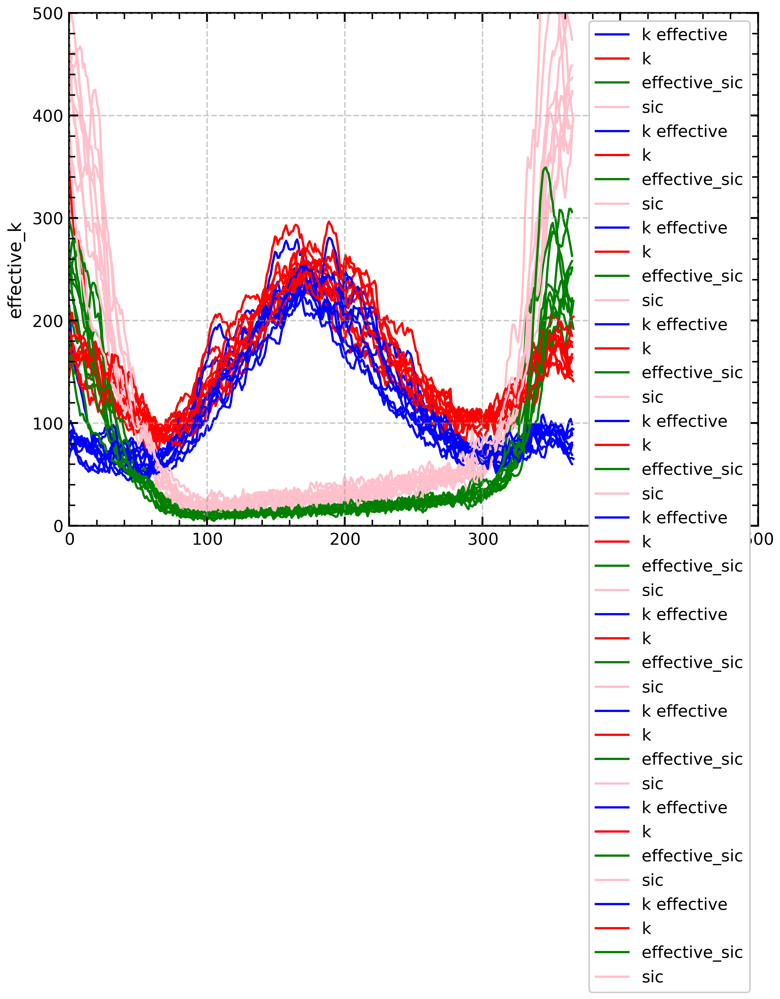

In [25]:
#sns.lineplot(x=x_dates, y=mean_sic_tmp[9,])
##mean_sic_tmp
rc('text', usetex=False)



fig, ax = plt.subplots(figsize=(width, height))

for year in range(2010,2020):
    ds = xr.open_dataset("/g/data/ia40/sea-ice-classification/mizWidth_"+str(year)+".nc")
    ndays, nlon = ds.effective_sic.shape
    x_dates = np.linspace(0, ndays,ndays)

    sns.lineplot(ax = ax, x = x_dates, y = ds.effective_k.mean(dim='nj')/1000, color='b', label = 'k effective')
    sns.lineplot(ax = ax, x = x_dates, y = ds.k.mean(dim='nj')/1000, color='r', label = 'k')
    sns.lineplot(ax = ax, x = x_dates, y = ds.effective_sic.mean(dim='nj')/1000, color='g', label = 'effective_sic')
    sns.lineplot(ax = ax, x = x_dates, y = ds.sic.mean(dim='nj')/1000, color='pink', label = 'sic')
ax.set_ylim((0,500))
ax.set_xlim((0,500))

In [44]:
filename = "/g/data/ia40/sea-ice-classification/mizWidth_2019.nc"
ds = xr.open_dataset(filename)

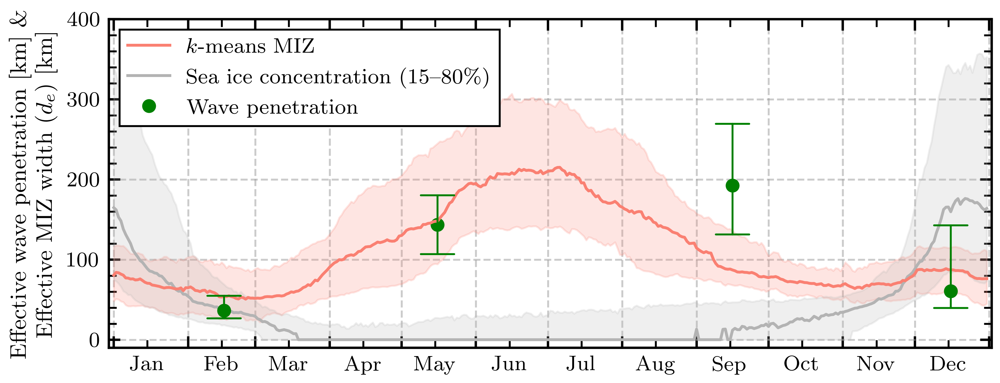

In [6]:
rc('text', usetex=True)
year_vec = range(2010,2020) #[2019] # [2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019]
COLOR_GREY = [0.7, 0.7, 0.7, 1.0]
# Loop over the files in that year

date = np.empty((365,1))
date[:,0] = np.arange(365)
for year_idx, year in enumerate(year_vec):
    #progressBar = "\rProgress: " + ProgressBar(len(year_vec), year_idx+1, 20, '#', '.')
    #ShowBar(progressBar)
    # Open the file
    filename = "/g/data/ia40/sea-ice-classification/mizWidth_"+str(year)+".nc"
    ds = xr.open_dataset(filename)
    
    effective_miz_width_array = np.asarray(ds['effective_k'])
    absolute_miz_width_array = np.asarray(ds['k'])
    sic_array = np.asarray(ds['effective_sic'])
    
    length_mat, width_mat = effective_miz_width_array.shape
    if length_mat == 366:
        #print('Leap year!')
        effective_miz_width_array = effective_miz_width_array[0:-1,:]
        sic_array = sic_array[0:-1,:]
    if year_idx == 0: 
        # First file, then initialise X_temp
        MIZ_vec = effective_miz_width_array.reshape(-1)
        SIC_vec = sic_array.reshape(-1)
        date_vec = np.tile(date, [1,width_mat]).reshape(-1)
    else:
        # Else just concatenate the new data on
        MIZ_vec = np.concatenate([MIZ_vec, effective_miz_width_array.reshape(-1)],axis=0)
        SIC_vec = np.concatenate([SIC_vec, sic_array.reshape(-1)],axis=0)
        date_vec = np.concatenate([date_vec, np.tile(date, [1,width_mat]).reshape(-1)],axis=0)


df_plot = pd.DataFrame({'date_idx': date_vec, 
                        'MIZ_vec': MIZ_vec/1000,
                        'SIC_vec': SIC_vec/1000,
                       }
                      )

# filename = "/g/data/ia40/sea-ice-classification/mizWidth_nofsd_2019.nc"
# ds_nofsd = xr.open_dataset(filename)
# absolute_miz_width_array = np.asarray(ds_nofsd['absolute'])
# MIZ_vec = absolute_miz_width_array.reshape(-1)
# length_mat, width_mat = absolute_miz_width_array.shape
# date_vec = np.tile(date, [1,width_mat]).reshape(-1)
# df_plot_nofsd = pd.DataFrame({'date_idx': date_vec, 
#                         'MIZ_vec': MIZ_vec/1000,
#                        }
#                       )

# Plot the MIZ widths
fig, ax = plt.subplots(figsize=(width, height/2))

brouwer_dates = [31+15,31+28+31+30+15,31+28+31+30+31+30+31+31+15,31+28+31+30+31+30+31+31+30+31+30+15]
brouwer_linear_centre = [36.187, 143.457, 192.569, 60.743]
brouwer_linear_lower = [20.679, 100.808, 125.363, 33.603]
brouwer_linear_upper = [60.743, 186.107, 275.283, 148.627]

COLOR_BROUWER = 'green'

# sns.lineplot(ax=ax, x="date_idx", y="MIZ_vec", data = df_plot, 
#              #errorbar=("sd", 1), 
#              estimator=np.nanmean,
#              errorbar=("sd",1), 
#              legend=False, color=COLOR_MIZ, label = "$k$-means MIZ", zorder=3,)

sns.lineplot(ax=ax, x="date_idx", y="MIZ_vec", data = df_plot, 
             #errorbar=("sd", 1), 
             estimator=np.median,
             errorbar=("pi", 50), 
             linestyle = '-',
             legend=False, color=COLOR_MIZ, label = "$k$-means MIZ", zorder=3,)

# sns.lineplot(ax=ax, x="date_idx", y="SIC_vec", data = df_plot, 
#              #errorbar=("sd", 1), 
#              estimator=np.nanmean,
#              errorbar=("sd",1),
#              legend=False, 
#              color=COLOR_GREY, label = "Sea ice concentration (15--80\%)", )
sns.lineplot(ax=ax, x="date_idx", y="SIC_vec", data = df_plot, 
             #errorbar=("sd", 1), 
             estimator=np.median,
             linestyle = '-',
             errorbar=("pi", 50), 
             legend=False, 
             color=COLOR_GREY, label = "Sea ice concentration (15--80\%)", )

#sns.lineplot(ax=ax, x="date_idx", y="MIZ_vec", data = df_plot_nofsd, errorbar=("sd", 1), legend=False, color="blue", label = "Unsupervised MIZ (no FSD) 2019")

plt.plot(brouwer_dates,brouwer_linear_centre, 'o',color=COLOR_BROUWER, label = 'Wave penetration') # , markersize=12
for day_idx in range(len(brouwer_dates)):
    ax.annotate('', 
                (brouwer_dates[day_idx], brouwer_linear_lower[day_idx]), (brouwer_dates[day_idx], brouwer_linear_upper[day_idx]),
                arrowprops=dict(arrowstyle='|-|, widthA=0.5, widthB=0.5', color=COLOR_BROUWER)
               )

set_ax_date(ax, plot_type="clim")
ax.set_xlim((np.round(ax.get_xlim()[0]+16),np.round(ax.get_xlim()[-1]-16)))
plt.ylabel("Effective wave penetration [km] \&\n Effective MIZ width ($d_{e}$) [km]")
ax.set_ylim([-10, 400])
ax.set_xlabel('')
plt.legend(fancybox=False, edgecolor="black", loc='upper left')
# ax.legend(['Unsupervised MIZ','Sea ice concentration 15--80\%', 'Waves-in-ice measurements'], fancybox=False, edgecolor="black")
# leg = ax.get_legend()
# leg.legendHandles[0].set_color(COLOR_MIZ)
# leg.legendHandles[1].set_color('gray')
# leg.legendHandles[2].set_color(COLOR_BROUWER)
#import tikzplotlib
#tikzplotlib.save(savepath+"miz_width.tex")

plt.show()

#fig.autofmt_xdate()
savepath = '/home/566/nd0349/notebooks/'
fig.savefig(savepath+'miz_width_2010_2019.png', dpi = 300) 
fig.savefig(savepath+'miz_width_2010_2019.pdf') 


In [51]:
df_plot.groupby('date_idx').mean().max()
df_plot.groupby('date_idx').mean().loc[90:(9*30),:].max()#.max()

MIZ_vec    236.456130
SIC_vec     25.823848
dtype: float64

Progress: [##..................] 10% 2010
(365, 360)
Progress: [####................] 20% 2011
(365, 360)
Progress: [######..............] 30% 2012
(366, 360)
Leap year!
Progress: [########............] 40% 2013
(365, 360)
Progress: [##########..........] 50% 2014
(365, 360)
Progress: [############........] 60% 2015
(365, 360)
Progress: [##############......] 70% 2016
(366, 360)
Leap year!
Progress: [################....] 80% 2017
(365, 360)
Progress: [##################..] 90% 2018
(365, 360)
Progress: [####################] 100% 
2019
(365, 360)


(0.0, 200.0)

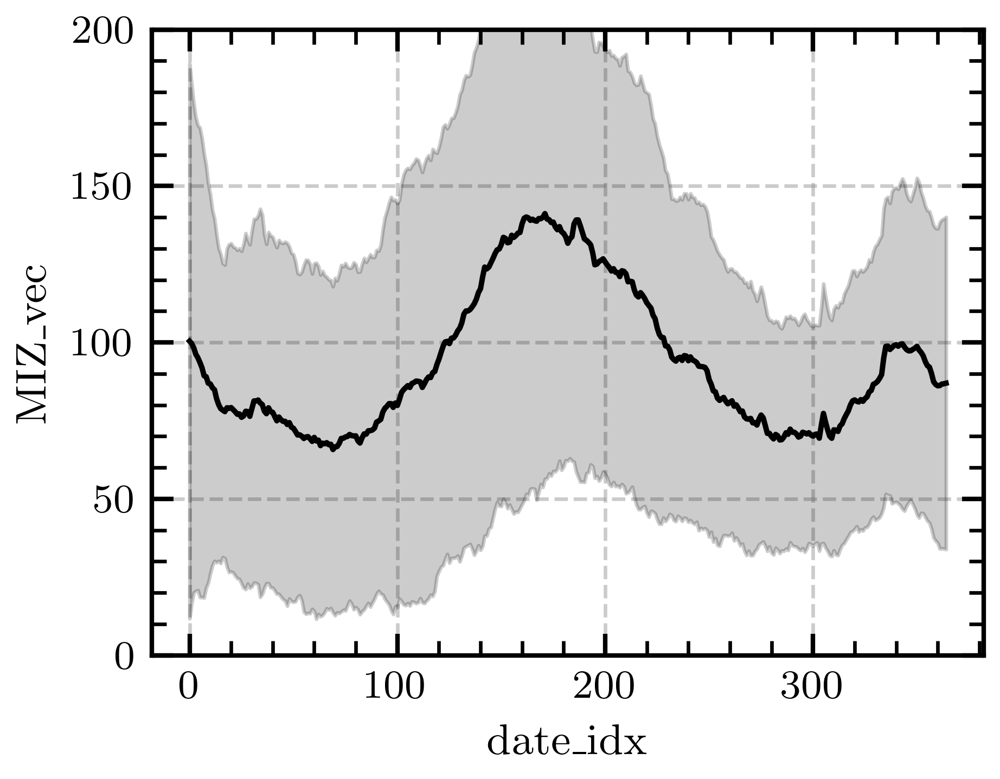

In [9]:
year_vec = range(2010,2020) #[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019]

# Loop over the files in that year
for year_idx, year in enumerate(year_vec):
    progressBar = "\rProgress: " + ProgressBar(len(year_vec), year_idx+1, 20, '#', '.')
    ShowBar(progressBar)

    # Open the file
    filename = "/g/data/ia40/sea-ice-classification/mizWidth_"+str(year)+".nc"
    ds = xr.open_dataset(filename)
    effective_miz_width_array = np.asarray(ds['effective_k'])
    length_array, width_array = effective_miz_width_array.shape
    print(year)
    print(effective_miz_width_array.shape)
    if length_array == 366:
        print('Leap year!')
        effective_miz_width_array = effective_miz_width_array[0:-1,:]
    date = np.empty((365,1))
    date[:,0] = np.arange(365)

    if year_idx == 0: 
        # First file, then initialise X_temp
        MIZ_vec = effective_miz_width_array.reshape(-1)
        length_array, width_array = effective_miz_width_array.shape
        date_vec = np.tile(date, [1,width_array]).reshape(-1)
    else:
        # Else just concatenate the new data on
        MIZ_vec = np.concatenate([MIZ_vec, effective_miz_width_array.reshape(-1)],axis=0)
        date_vec = np.concatenate([date_vec, np.tile(date, [1,width_array]).reshape(-1)],axis=0)
df_plot = pd.DataFrame({'date_idx': date_vec, 
                            'MIZ_vec': MIZ_vec/1000})
sns.lineplot(x="date_idx", y="MIZ_vec", errorbar=("sd", 1),
             data=df_plot)
plt.ylim((0,200))

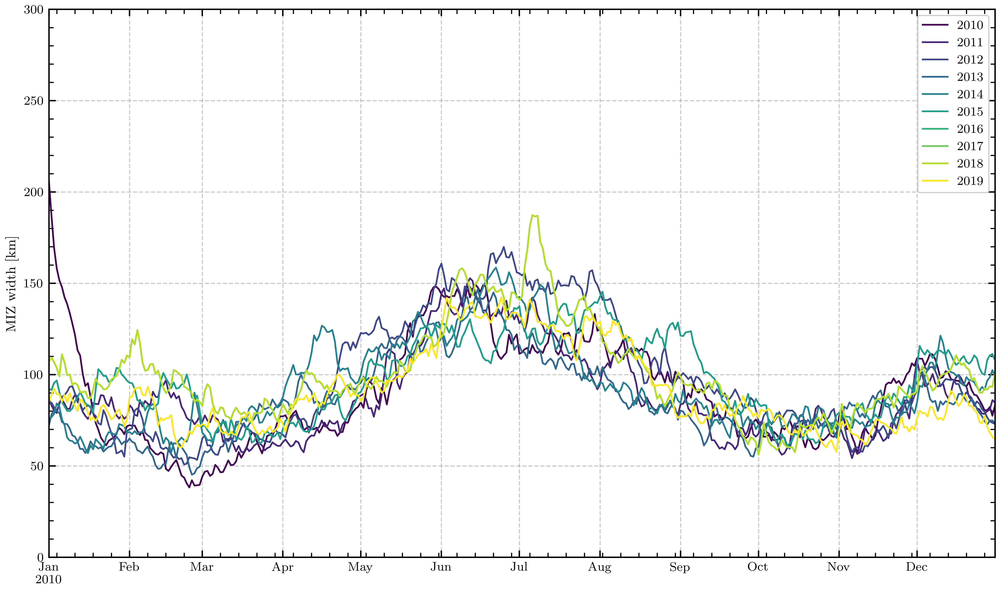

In [10]:
# MIZ width over a few years

miz_width_2010 = xr.open_dataset('/g/data/ia40/sea-ice-classification/mizWidth_2010.nc')
miz_width_2011 = xr.open_dataset('/g/data/ia40/sea-ice-classification/mizWidth_2011.nc')
miz_width_2012 = xr.open_dataset('/g/data/ia40/sea-ice-classification/mizWidth_2012.nc')
miz_width_2013 = xr.open_dataset('/g/data/ia40/sea-ice-classification/mizWidth_2013.nc')
miz_width_2014 = xr.open_dataset('/g/data/ia40/sea-ice-classification/mizWidth_2014.nc')
miz_width_2015 = xr.open_dataset('/g/data/ia40/sea-ice-classification/mizWidth_2015.nc')
miz_width_2016 = xr.open_dataset('/g/data/ia40/sea-ice-classification/mizWidth_2016.nc')
miz_width_2017 = xr.open_dataset('/g/data/ia40/sea-ice-classification/mizWidth_2017.nc')
miz_width_2018 = xr.open_dataset('/g/data/ia40/sea-ice-classification/mizWidth_2018.nc')
miz_width_2019 = xr.open_dataset('/g/data/ia40/sea-ice-classification/mizWidth_2019.nc')

# Create a dataframe
day_vec = range(0,365,1)
dates = pd.date_range(start="2010-01-01",end="2010-12-31",periods=len(day_vec))
idx = day_vec
d = {'2010':miz_width_2010['effective_k'][idx,:].mean(axis=1)/1000,
     '2011':miz_width_2011['effective_k'][idx,:].mean(axis=1)/1000,
     '2012':miz_width_2012['effective_k'][idx,:].mean(axis=1)/1000,
     '2013':miz_width_2013['effective_k'][idx,:].mean(axis=1)/1000,
     '2014':miz_width_2014['effective_k'][idx,:].mean(axis=1)/1000,
     '2015':miz_width_2015['effective_k'][idx,:].mean(axis=1)/1000,
     '2016':miz_width_2016['effective_k'][idx,:].mean(axis=1)/1000,
     '2017':miz_width_2016['effective_k'][idx,:].mean(axis=1)/1000,
     '2018':miz_width_2016['effective_k'][idx,:].mean(axis=1)/1000,
     '2019': miz_width_2019['effective_k'][idx,:].mean(axis=1)/1000,
    'date':dates}
df = pd.DataFrame(data=d)

fig, ax = plt.subplots(figsize=(width, height))

x_dates = np.linspace(0, 365,365)
df.plot(ax=ax, legend=True, colormap='viridis', figsize=(12,7),x='date', linestyle='solid')

#plt.plot(ax=ax, x=brouwer_dates, y=brouwer_linear_centre, 'o',color=COLOR_BROUWER, label = 'Waves-in-ice observations') # , markersize=12
# for day_idx in range(len(brouwer_dates)):
#     ax.annotate('', 
#                 (brouwer_dates[day_idx], brouwer_linear_lower[day_idx]), (brouwer_dates[day_idx], brouwer_linear_upper[day_idx]),
#                 arrowprops=dict(arrowstyle='|-|, widthA=0.5, widthB=0.5', color=COLOR_BROUWER)
#                )
plt.ylim((0,300)) 
plt.ylabel('MIZ width [km]')
plt.xlabel('')
plt.show()
del miz_width_2010, miz_width_2011, miz_width_2012, miz_width_2013, miz_width_2014, miz_width_2015, miz_width_2016, miz_width_2017, miz_width_2018, miz_width_2019

<xarray.DataArray 'effective_k' (time: 365)>
array([ 88543.62376774,  93937.66949525,  96909.88953952,  94080.89785285,
        94696.26876738,  91117.71141406,  92796.30980193,  88994.25274963,
        94831.26309974,  89549.06014493,  86503.40900735,  83236.46614164,
        89868.99808236,  88615.06438315,  86239.11075643,  82302.44370676,
        77322.89285796,  79516.77996504,  77699.52268365,  80291.57876309,
        86005.31571291,  88958.8008751 ,  86443.68437533,  83509.97681062,
        79887.13714225,  82301.14398649,  85040.99481612,  85603.06772572,
        80387.98856393,  75348.50642677,  78932.9329839 ,  89815.62561969,
        91279.80965338,  95703.27081267,  97005.31183843,  97188.51465351,
        93632.51181437,  94356.82609821,  99897.80651599,  94343.68471389,
        92905.36896464,  87620.57737209,  78436.26747058,  82178.55015188,
        82035.99976079,  82231.15436736,  81601.85170835,  84293.52733683,
        77399.5217759 ,  71651.94075041,  66960.77321696,  65040.75645369,
        68402.14101481,  70353.90756773,  73886.70766775,  76677.7554359 ,
        79651.51166672,  80921.32288678,  79085.27858215,  78253.1986311 ,
        78010.34926515,  77132.40947081,  85828.46117588,  87514.87519597,
        80654.03495005,  78943.37338726,  76792.83813916,  74495.56496916,
        77468.40323672,  77883.15220801,  78799.50391251,  74074.26075106,
        73474.41245984,  81939.47335915,  85533.23542445,  87294.51600776,
        88376.61215725,  88173.73346016,  85118.22794503,  82547.16355822,
...
        76828.25308133,  79176.95197016,  75813.3751545 ,  76340.17286134,
        76357.17135055,  74569.21539233,  78999.76594818,  76336.6816151 ,
        72635.26828643,  71280.41935607,  68922.44158284,  68729.02560534,
        68354.47098393,  71112.77558065,  69788.37235241,  65467.75242681,
        72639.01305745,  76285.93808522,  73922.54491398,  76219.7340335 ,
        73381.97329917,  72071.04475971,  71745.09554486,  71447.86219364,
        67268.50425905,  66513.36638999,  64040.52425519,  66256.56491237,
        70361.26766185,  72602.04711394,  77080.04164764,  77556.04564125,
        75951.92229777,  76891.24795263,  77347.05184828,  74080.56223549,
        72470.54757248,  70446.6645387 ,  70827.22595448,  75044.38976266,
        78956.93081464,  73455.88607411,  74381.74562532,  71679.69352777,
        73911.63123462,  73513.11407689,  78940.18624961,  83282.04760162,
        81968.51488946,  81293.17478781,  79265.98396992,  83969.02294059,
        83548.67102079,  79205.88534852,  76958.47012882,  77974.26584839,
        77106.81105826,  81502.25753401,  89528.01977265,  95702.27314633,
        93762.60807773,  89255.4307948 ,  86423.64189486,  89023.42063315,
        93601.39854129,  90324.09678877,  88204.28281199,  86077.84800915,
        84699.62792102,  82825.27082286,  79187.97848273,  79571.08373328,
        83413.17863652,  77356.29899333,  72159.24649861,  68438.44944872,
        68958.22477744])
Coordinates:
  * time     (time) int64 0 1 2 3 4 5 6 7 8 ... 357 358 359 360 361 362 363 364

<AxesSubplot:>

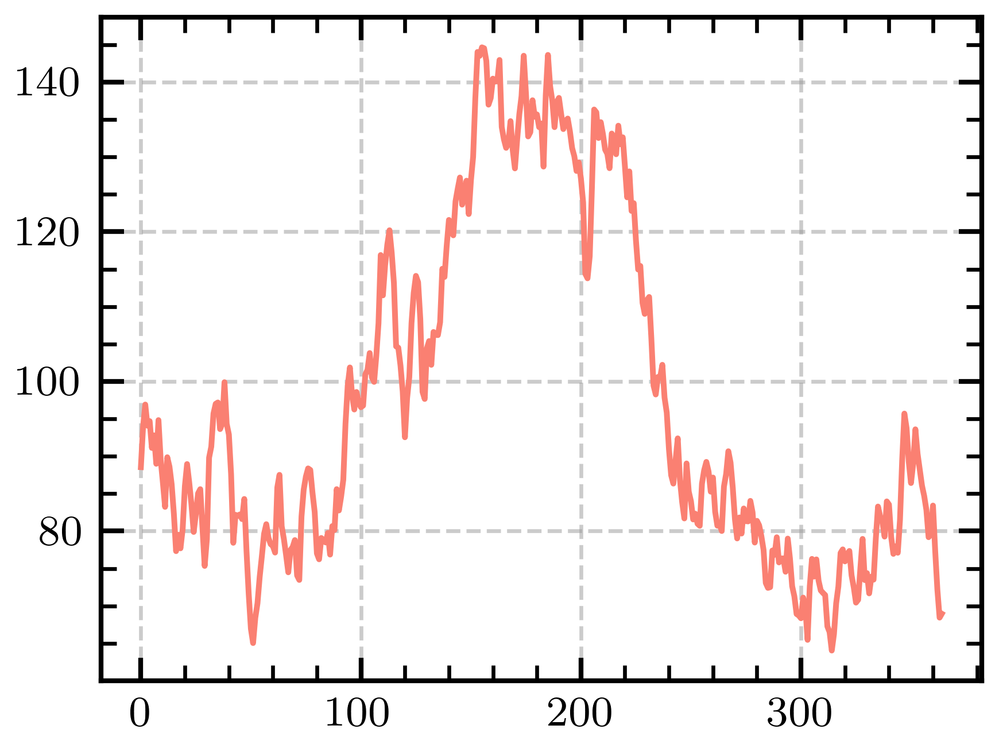

In [19]:
miz_width_2019['effective_k'].min()

<xarray.DataArray 'effective_k' ()>
array(0.)

### Without floe size data

In [31]:
sns.color_palette("colorblind",15)[4]

(0.8, 0.47058823529411764, 0.7372549019607844)

In [7]:

ds = xr.open_dataset('/g/data/ia40/sea-ice-classification/kmean_3_exclude_floesize_2019.nc')
#tmask = ds['tmask'][:,:]
LN = ds.LON.values
LT = ds.LAT.values
lat = ds.LAT
hte = ds.HTE

#lat_idx = LT[:,0] < 0
# Initialise arrays
n_days, n_lat,n_lon = ds.k.shape

kmean_mizwidth_array = np.empty((n_days,n_lon))
effective_kmean_mizwidth_array = np.empty((n_days,n_lon))
effective_kmean_mizwidth_array[:,:] = np.nan

sic_mizwidth_array = np.empty((n_days,n_lon))
effective_sic_mizwidth_array = np.empty((n_days,n_lon))



# Open the file
for idx in tqdm(range(n_days)):
    #print(file)
    ones_array = xr.DataArray(np.ones((ds.HTE.shape)), dims=["nj", "ni"])

    kmean = ds.k[idx,:,:].squeeze()
    aice = ds.aice[idx,:,:].squeeze()
    
    # 1. Take the MIZ (cluster number = 0)
    
    hte_miz = ds.HTE.where(kmean == 0, drop=False).squeeze() 
    aice_miz = aice.where(kmean == 0, drop=False).squeeze() 


    # Determine if any ice is in each transect
    hte_south = ds.HTE.where(lat < 0, drop=True).squeeze() 
    aice_south = aice.where(lat < 0, drop=True).squeeze() 

    effective_icepack_width = np.multiply(aice_south, hte_south)

    idx_aice = effective_icepack_width.sum(dim='nj') < 0.0001



    # SIC MIZ width
    aice_15 = aice_south.where(aice_south > 0.15, drop=False).squeeze() 
    aice_1580 = aice_15.where(aice_15 < 0.8, drop=False).squeeze() 
    hte_1580 = hte_south.where(aice_1580 > 0.0, drop=False).squeeze() 
    sic_mizwidth_array[idx,:] = hte_1580.sum(dim='nj')
    sic_mizwidth_array[idx, idx_aice] = np.nan

    # effective SIC MIZ width
    effective_sic_mizwidth_array[idx,:] = np.multiply(hte_1580, aice_1580).sum(dim='nj')
    effective_sic_mizwidth_array[idx, idx_aice] = np.nan

    # k-mean MIZ width
    kmean_mizwidth_array[idx,:] = hte_miz.sum(dim='nj')
    kmean_mizwidth_array[idx, idx_aice] = np.nan

    # effective k-mean MIZ width
    effective_kmean_mizwidth_array[idx,:] = np.multiply(hte_miz, aice_miz).sum(dim='nj')
    effective_kmean_mizwidth_array[idx, idx_aice] = np.nan


# Save to NetCDF
filename="/g/data/ia40/sea-ice-classification/mizWidth_nofsd"+str(year)+".nc"
d_vars = {"effective_k" : (['time','nj'],effective_kmean_mizwidth_array,
                              {'long_name' :"Effective width",
                               'units'     :"m",
                               '_FillValue':-2e8}),
          "k" : (['time','nj'],kmean_mizwidth_array,
                              {'long_name' :"MIZ width",
                               'units'     :"m",
                               '_FillValue':-2e8}),
          "effective_sic" : (['time','nj'],effective_sic_mizwidth_array,
                              {'long_name' :"Effective sea ice concentration width [0.15, 0.8]",
                               'units'     :"m",
                               '_FillValue':-2e8}),
          "sic" : (['time','nj'],sic_mizwidth_array,
                              {'long_name' :"Sea ice concentration width [0.15, 0.8]",
                               'units'     :"m",
                               '_FillValue':-2e8}),
         #  "upper_location" : (['time','nj'],miz_upper_boundary,
         #                  {'long_name':"Northern MIZ boundary",
         #                   'units'    :"m",
         #                   '_FillValue':-2e8}),
         # "lower_location" : (['time','nj'],miz_lower_boundary,
         #                      {'long_name' :"Southern MIZ boundary",
         #                       'units'     :"degrees",
         #                       '_FillValue':-2e8})
         }
          
coords = {"LON"  : (["nj"],LN[0,:].data,{'units':'degrees_east'}),
          "time" : (["time"],range(n_days))}
attrs = {'creation_date': datetime.now().strftime('%Y-%m-%d'), #"2023-10-10",#datetime.now().strftime('%Y-%m-%d %H'),
         'conventions'  : "",
         'title'        : "MIZ width for CICE-WIM standalone 1-degree data",
         'source'       : ", ",
         'comment'      : "",
         'author'       : 'Noah Day',
         'email'        : 'noah.day@adelaide.edu.au'}
enc_dict  = {'shuffle':True,'zlib':True,'complevel':5} 
nc_out = xr.Dataset(data_vars=d_vars,coords=coords,attrs=attrs)
write_job = nc_out.to_netcdf(filename,unlimited_dims=['time'],compute=False)#,encoding={'glbrad':enc_dict})



100%|██████████| 365/365 [00:10<00:00, 33.53it/s]


In [24]:
MIZ_vec

array([75582.48464304, 12995.50654679, 24806.61814742, ...,
       55028.49942302, 51592.42324099, 20963.13848376])

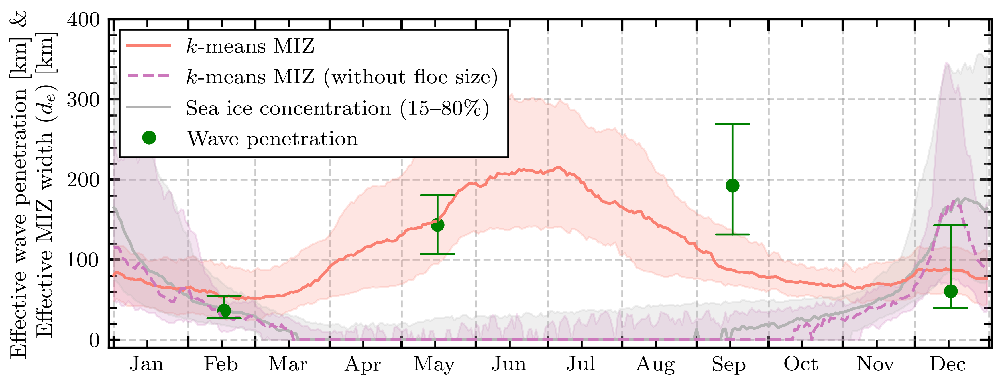

In [32]:
rc('text', usetex=True)
year_vec = range(2010,2020) #[2019] # [2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019]
COLOR_GREY = [0.7, 0.7, 0.7, 1.0]
# Loop over the files in that year

date = np.empty((365,1))
date[:,0] = np.arange(365)
for year_idx, year in enumerate(year_vec):
    #progressBar = "\rProgress: " + ProgressBar(len(year_vec), year_idx+1, 20, '#', '.')
    #ShowBar(progressBar)
    # Open the file
    filename = "/g/data/ia40/sea-ice-classification/mizWidth_"+str(year)+".nc"
    ds = xr.open_dataset(filename)
    
    effective_miz_width_array = np.asarray(ds['effective_k'])
    absolute_miz_width_array = np.asarray(ds['k'])
    sic_array = np.asarray(ds['effective_sic'])
    
    length_mat, width_mat = effective_miz_width_array.shape
    if length_mat == 366:
        #print('Leap year!')
        effective_miz_width_array = effective_miz_width_array[0:-1,:]
        sic_array = sic_array[0:-1,:]
    if year_idx == 0: 
        # First file, then initialise X_temp
        MIZ_vec = effective_miz_width_array.reshape(-1)
        SIC_vec = sic_array.reshape(-1)
        date_vec = np.tile(date, [1,width_mat]).reshape(-1)
    else:
        # Else just concatenate the new data on
        MIZ_vec = np.concatenate([MIZ_vec, effective_miz_width_array.reshape(-1)],axis=0)
        SIC_vec = np.concatenate([SIC_vec, sic_array.reshape(-1)],axis=0)
        date_vec = np.concatenate([date_vec, np.tile(date, [1,width_mat]).reshape(-1)],axis=0)


df_plot = pd.DataFrame({'date_idx': date_vec, 
                        'MIZ_vec': MIZ_vec/1000,
                        'SIC_vec': SIC_vec/1000,
                       }
                      )

#filename = "/g/data/ia40/sea-ice-classification/mizWidth_nofsd2019.nc"
#ds = xr.open_dataset(filename)
#effective_miz_width_array = np.asarray(ds['effective_k'])
#absolute_miz_width_array = np.asarray(ds['k'])
#sic_array = np.asarray(ds['effective_sic'])
#date_vec = pd.date_range(start="2019-01-01",end="2019-12-31")

filename = "/g/data/ia40/sea-ice-classification/mizWidth_nofsd2019.nc"
ds_nofsd = xr.open_dataset(filename)

effective_miz_width_array_nofsd = np.asarray(ds_nofsd['effective_k'])
absolute_miz_width_array_nofsd = np.asarray(ds_nofsd['k'])
sic_array_nofsd = np.asarray(ds_nofsd['effective_sic'])
date = np.empty((365,1))
date[:,0] = np.arange(365)

length_mat, width_mat = effective_miz_width_array_nofsd.shape
year_idx == 0
#if length_mat == 366:
    #print('Leap year!')
    #effective_miz_width_array_nofsd = effective_miz_width_array_nofsd[0:-1,:]
    #sic_array = sic_array[0:-1,:]
#if year_idx == 0: 
    # First file, then initialise X_temp
MIZ_vec_nofsd = effective_miz_width_array_nofsd.reshape(-1)
SIC_vec_nofsd = sic_array_nofsd.reshape(-1)
date_vec = np.tile(date, [1,width_mat]).reshape(-1)
# else:
#     # Else just concatenate the new data on
#     MIZ_vec = np.concatenate([MIZ_vec, effective_miz_width_array.reshape(-1)],axis=0)
#     SIC_vec = np.concatenate([SIC_vec, sic_array.reshape(-1)],axis=0)
#     date_vec = np.concatenate([date_vec, np.tile(date, [1,width_mat]).reshape(-1)],axis=0)


df_plot_nofsd = pd.DataFrame({'date_idx': date_vec, #range(365),#date_vec, 
                        'MIZ_vec': MIZ_vec_nofsd/1000, #np.nanmean(effective_miz_width_array,axis=1)/1000,
                        'SIC_vec': SIC_vec_nofsd/1000,#np.nanmean(sic_array,axis=1)/1000,
                       }
                      )

# filename = "/g/data/ia40/sea-ice-classification/mizWidth_nofsd_2019.nc"
# ds_nofsd = xr.open_dataset(filename)
# absolute_miz_width_array = np.asarray(ds_nofsd['absolute'])
# MIZ_vec = absolute_miz_width_array.reshape(-1)
# length_mat, width_mat = absolute_miz_width_array.shape
# date_vec = np.tile(date, [1,width_mat]).reshape(-1)
# df_plot_nofsd = pd.DataFrame({'date_idx': date_vec, 
#                         'MIZ_vec': MIZ_vec/1000,
#                        }
#                       )

# Plot the MIZ widths
fig, ax = plt.subplots(figsize=(width, height/2))

brouwer_dates = [31+15,31+28+31+30+15,31+28+31+30+31+30+31+31+15,31+28+31+30+31+30+31+31+30+31+30+15]
brouwer_linear_centre = [36.187, 143.457, 192.569, 60.743]
brouwer_linear_lower = [20.679, 100.808, 125.363, 33.603]
brouwer_linear_upper = [60.743, 186.107, 275.283, 148.627]

COLOR_BROUWER = 'green'

# sns.lineplot(ax=ax, x="date_idx", y="MIZ_vec", data = df_plot, 
#              #errorbar=("sd", 1), 
#              estimator=np.nanmean,
#              errorbar=("sd",1), 
#              legend=False, color=COLOR_MIZ, label = "$k$-means MIZ", zorder=3,)

sns.lineplot(ax=ax, x="date_idx", y="MIZ_vec", data = df_plot, 
             #errorbar=("sd", 1), 
             estimator=np.median,
             errorbar=("pi", 50), 
             linestyle = '-',
             legend=False, color=COLOR_MIZ, label = "$k$-means MIZ", zorder=3,)

sns.lineplot(ax=ax, x="date_idx", y="MIZ_vec", data = df_plot_nofsd, 
             #errorbar=("sd", 1), 
             estimator=np.median,
             errorbar=("pi", 50), 
             linestyle = '--',
             legend=False, color=sns.color_palette("colorblind",15)[4], label = "$k$-means MIZ (without floe size)", zorder=3,)

# sns.lineplot(ax=ax, x="date_idx", y="SIC_vec", data = df_plot, 
#              #errorbar=("sd", 1), 
#              estimator=np.nanmean,
#              errorbar=("sd",1),
#              legend=False, 
#              color=COLOR_GREY, label = "Sea ice concentration (15--80\%)", )
sns.lineplot(ax=ax, x="date_idx", y="SIC_vec", data = df_plot, 
             #errorbar=("sd", 1), 
             estimator=np.median,
             linestyle = '-',
             errorbar=("pi", 50), 
             legend=False, 
             color=COLOR_GREY, label = "Sea ice concentration (15--80\%)", )

#sns.lineplot(ax=ax, x="date_idx", y="MIZ_vec", data = df_plot_nofsd, errorbar=("sd", 1), legend=False, color="blue", label = "Unsupervised MIZ (no FSD) 2019")

plt.plot(brouwer_dates,brouwer_linear_centre, 'o',color=COLOR_BROUWER, label = 'Wave penetration') # , markersize=12
for day_idx in range(len(brouwer_dates)):
    ax.annotate('', 
                (brouwer_dates[day_idx], brouwer_linear_lower[day_idx]), (brouwer_dates[day_idx], brouwer_linear_upper[day_idx]),
                arrowprops=dict(arrowstyle='|-|, widthA=0.5, widthB=0.5', color=COLOR_BROUWER)
               )

set_ax_date(ax, plot_type="clim")
ax.set_xlim((np.round(ax.get_xlim()[0]+16),np.round(ax.get_xlim()[-1]-16)))
plt.ylabel("Effective wave penetration [km] \&\n Effective MIZ width ($d_{e}$) [km]")
ax.set_ylim([-10, 400])
ax.set_xlabel('')
plt.legend(fancybox=False, edgecolor="black", loc='upper left')
# ax.legend(['Unsupervised MIZ','Sea ice concentration 15--80\%', 'Waves-in-ice measurements'], fancybox=False, edgecolor="black")
# leg = ax.get_legend()
# leg.legendHandles[0].set_color(COLOR_MIZ)
# leg.legendHandles[1].set_color('gray')
# leg.legendHandles[2].set_color(COLOR_BROUWER)
#import tikzplotlib
#tikzplotlib.save(savepath+"miz_width.tex")

plt.show()

#fig.autofmt_xdate()
savepath = '/home/566/nd0349/notebooks/'
fig.savefig(savepath+'miz_width_2010_2019_nofsd.png', dpi = 300) 
fig.savefig(savepath+'miz_width_2010_2019_nofsd.pdf') 


# Figure 6: FSD processes and melt rates

In [ ]:
year_range = range(2010,2020)

df = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/forcing_analysis_'+str(year)+'.csv') 
                for year in tqdm(year_range, total = len(year_range), desc = "Reading in forcing analysis data")),
                ignore_index=True)
df_fsd = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/analysis_fsd_raw_'+str(year)+'.csv') 
                for year in tqdm(year_range, total = len(year_range), desc = "Reading in FSD analysis data")),
                ignore_index=True)
df_kmeans = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/kmeans_'+str(year)+'.csv') 
                for year in tqdm(year_range, total = len(year_range), desc = "Reading in kmeans data")),
                ignore_index=True)

df['k'] = df_kmeans['k']
df_fsd['k'] = df_kmeans['k']
unique_dates = df_fsd['date'].unique()
df.groupby('k').describe()


Reading in kmeans data: 100%|██████████| 10/10 [00:32<00:00,  3.25s/it]


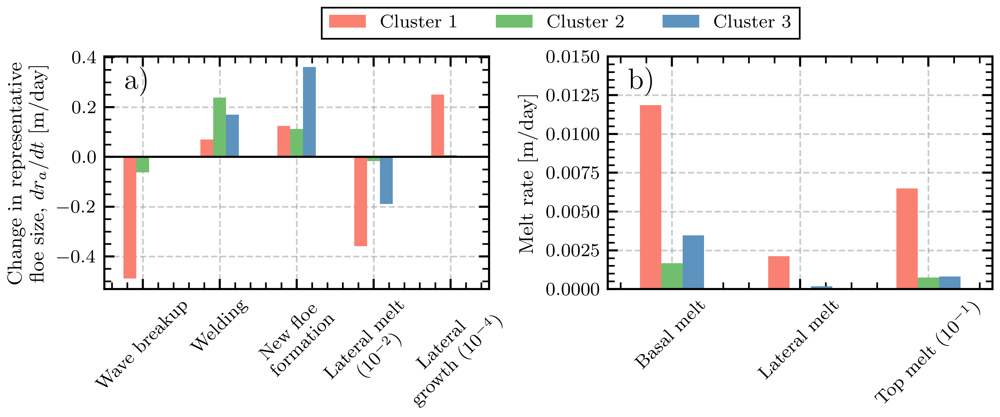

In [7]:
# df = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/forcing_analysis_'+str(year)+'.csv')
# df_fsd = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/analysis_fsd_raw_'+str(year)+'.csv')
# df_kmeans = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/kmeans_'+str(year)+'.csv')
# df['k'] = df_kmeans['k']
# df_fsd['k'] = df_kmeans['k']
# unique_dates = df_fsd['date'].unique()
# df.groupby('k').describe()

#fig, axes = plt.subplot_mosaic([['a)'], ['b)']], layout='constrained', sharex=False, figsize=(width/2,height))

fig, axes = plt.subplots(1, 2, figsize=(width,height/2), sharex=False)
ax1 = axes[0]
ax2 = axes[1]
# Get the FSD processes into a plotting dataframe
df_grouped = df_fsd[["dafsd_wave", "dafsd_weld", "dafsd_newi", "dafsd_latm", "dafsd_latg", "k"]].groupby('k').mean(numeric_only=True)
df_grouped["dafsd_latm"] = df_grouped["dafsd_latm"]*100#.values*(10^5)
df_grouped["dafsd_latg"] = df_grouped["dafsd_latg"]*10000
# , "dafsd_latm", "dafsd_latg"
xtick_labels_fsd = ['Wave breakup', 'Welding', 'New floe\nformation', 'Lateral melt\n($10^{-2}$)', 'Lateral\ngrowth ($10^{-4}$)']
df_plot_fsd = pd.DataFrame({'1': df_grouped.iloc[0,:].values,
                            '2': df_grouped.iloc[1,:].values,
                            '3': df_grouped.iloc[2,:].values},
                            index=xtick_labels_fsd)


# Get the melting processes into a plotting dataframe
df_melt = pd.DataFrame({'k': df["k"].values,
                             "date": df["date"].values,
                             "meltt": df["meltt"].values*10,
                             "meltl": df["meltl"].values,
                             "meltb": df["meltb"].values,
                            })
df_grouped = df_melt[["meltb", "meltl", "meltt", "k"]].groupby('k').mean(numeric_only=True)
df_plot_melt = pd.DataFrame({'1': df_grouped.iloc[0,:].values,
                             '2': df_grouped.iloc[1,:].values,
                             '3': df_grouped.iloc[2,:].values},
                              index=['Basal melt', 'Lateral melt', 'Top melt'])


df_plot_fsd.plot(ax = ax1, kind='bar', stacked=False, 
             color=[(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)],
             )

ax1.set_ylabel('Change in representative\nfloe size, $dr_a/dt$ [m/day]')
ax1.set_xticklabels(labels=xtick_labels_fsd, rotation=45)
ax1.axhline(y = 0.0, color = 'black', linestyle = '-', linewidth = 1.0, zorder=3)



df_plot_melt.plot(ax = ax2, kind='bar', stacked=False, 
             color=[(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)],legend=None,
             linewidth=2)


ax2.set_ylabel('Melt rate [$10^-2$ m/day]')
plt.xticks(rotation = 0)
xtick_labels_melt = ['Basal melt', 'Lateral melt', 'Top melt ($10^{-1}$)']
ax2.set_xticklabels(labels=xtick_labels_melt, rotation=45)
plt.ylabel('Melt rate [m/day]')
ax2.legend(['Cluster 1','Cluster 2','Cluster 3'], fancybox=False, edgecolor="black")
ax2.set_ylim((0, 0.015))

ax1.get_legend().remove()
        
#    elif label == 'b)':

#add_subplot_label(fig, label)
trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
ax1.text(0.0, 1.0, 'a)', transform=ax1.transAxes + trans,
               fontsize='medium', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax2.text(0.0, 1.0, 'b)', transform=ax2.transAxes + trans,
               fontsize='medium', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))


#ax_inset = fig.add_axes([pos1.x0, pos1.y0,  pos1.width / 2.0, pos1.height / 2.0])#([left_corner, 0.2, 0.1, 0.2])#,projection='linear')
       

fig.tight_layout(pad=0.25)

pos1 = ax1.get_position()
pos2 = ax2.get_position()
#plt.legend(['Cluster 1','Cluster 2','Cluster 3'], fancybox=False, edgecolor="black")
sns.move_legend(ax2, "upper center", bbox_to_anchor=(-0.1225, 1.25), ncol=3, title=None, frameon=True, fancybox=False, edgecolor='black')
# ((pos1.x0+pos1.width), pos1.y0+pos1.height)


savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'dafsd_melt_bar.png', dpi = 1000, bbox_inches="tight", transparent=True)
plt.savefig(savepath+'dafsd_melt_bar.pdf') #, transparent=True)

In [21]:
((pos1.x0+pos1.width+pos2.x0)/2, pos1.y0+pos1.height)

(0.5125, 0.88)

In [34]:
#sns.barplot(data=df_melt, y="meltl")

In [19]:
df_plot_melt

,1,2,3
Basal melt,1.416142,0.138795,0.364475
Lateral melt,0.464525,0.007777,0.053181
Top melt,0.334860,0.019628,0.059456


# Figure 7: Seasonal shift of the MIZ

### Create new data

In [15]:
year_range = range(2010,2020)
for year in tqdm(year_range, total = len(year_range)):
    df = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/forcing_analysis_'+str(year)+'.csv')
    df_dafsd = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/analysis_fsd_raw_'+str(year)+'.csv')
    df_kmean = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/kmeans_'+str(year)+'.csv')
    df_raw = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/raw_'+str(year)+'.csv')

    df['k'] = df_kmean['k']
    df_dafsd['k'] = df_kmean['k']


    # create DataFrame
    t = pd.to_datetime(df["date"].values, format="%Y-%m-%d")
    df_pancake = pd.DataFrame({'k': df["k"].values,
                             "date": t.strftime('%Y-%m-%d'),
                             "frazil": df["frazil"].values,
                             "congel": df["congel"].values,
                             #"pancake": df_dafsd["pancake"].values,
                             "wave_sig_ht": df["wave_sig_ht"].values,
                             "daidtd": df["daidtd"].values,
                             "daidtt": df["daidtt"].values,
    #                         "dagedtd": df["dagedtd"].values,
    #                         "dagedtt": df["dagedtt"].values,
                             "divu": df["divu"].values,
                             "uatm": df["uatm"].values,
                             "vatm": df["vatm"].values,
                             "uvel": df["uvel"].values,
                             "vvel": df["vvel"].values,
                             "dafsd_wave": df_dafsd["dafsd_wave"].values,
                             "dafsd_latg": df_dafsd["dafsd_latg"].values,
                             "dafsd_latm": df_dafsd["dafsd_latm"].values,
                             "dafsd_weld": df_dafsd["dafsd_weld"].values,
                             "dafsd_newi": df_dafsd["dafsd_newi"].values,
                             "aice": df_raw["aice"].values,
                             "fsdrad": df_raw["fsdrad"].values,
                             "iage": df_raw["iage"].values,
                             "hi": df_raw["hi"].values
                                })
#    df_pancake.drop(df_pancake[df_pancake['date'] == '02-29'].index, inplace = True)
    #('-02-29')


    del df_dafsd, df_raw, df_kmean

    df_pancake['date'] = pd.to_datetime(df_pancake['date'], format="%Y-%m-%d")
#    df_timeseries = df_pancake.groupby(['date', 'k']).rolling(7).mean(numeric_only=True)
    # Get MIZ cluster only
    df_pancake = df_pancake.loc[df_pancake['k'] == 0]
    df_miz_ts = pd.DataFrame({'k': df_pancake["k"].values,
                             "date": df_pancake["date"].values,
                             "frazil": df_pancake["frazil"].values,
                             "congel": df_pancake["congel"].values,
                             #"pancake": df_pancake["pancake"].values,
                             "wave_sig_ht": df_pancake["wave_sig_ht"].values,
                             "daidtd": df_pancake["daidtd"].values,
                             "daidtt": df_pancake["daidtt"].values,
                             "divu": df_pancake["divu"].values,
                             "uatm": df_pancake["uatm"].values,
                             "vatm": df_pancake["vatm"].values,
                             "uvel": df_pancake["uvel"].values,
                             "vvel": df_pancake["vvel"].values,
                             "dafsd_wave": df_pancake["dafsd_wave"].values,
                             "dafsd_latg": df_pancake["dafsd_latg"].values,
                             "dafsd_latm": df_pancake["dafsd_latm"].values,
                             "dafsd_weld": df_pancake["dafsd_weld"].values,
                             "dafsd_newi": df_pancake["dafsd_newi"].values,
                             "aice": df_pancake["aice"].values,
                             "fsdrad": df_pancake["fsdrad"].values,
                             "iage": df_pancake["iage"].values,
                              "hi": df_pancake["hi"].values
                                })
    
    savepath = '/g/data/ia40/sea-ice-classification/dataframes/'
    savefilename = 'miz_ts_'+str(year)+'.csv'
    df_miz_ts.to_csv(savepath+savefilename)

  0%|          | 0/10 [00:04<?, ?it/s]

KeyboardInterrupt



### Read in data

In [8]:
# Read in MIZ timeseries
year_range = range(2010, 2020) # [2019] # [2010, 2011, 2013, 2014, 2015, 2017, 2018, 2019] #range(2010,2020)
df_miz_ts = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/miz_ts_'+str(year)+'.csv') 
                for year in tqdm(year_range, total = len(year_range), desc = "Reading in MIZ time series data")),
                ignore_index=True)
print(df_miz_ts["date"])
    #('-02-29')

Reading in MIZ time series data: 100%|██████████| 10/10 [00:05<00:00,  1.87it/s]

0          2010-01-01
1          2010-01-01
2          2010-01-01
3          2010-01-01
4          2010-01-01
              ...    
2859471    2019-12-31
2859472    2019-12-31
2859473    2019-12-31
2859474    2019-12-31
2859475    2019-12-31
Name: date, Length: 2859476, dtype: object


In [9]:
savepath = '/g/data/ia40/sea-ice-classification/dataframes/'
savefilename = 'miz_ts_'+str(year_range[0]) + '_' + str(year_range[-1])+'.csv'
df_miz_ts.to_csv(savepath+savefilename)

### Read in MIZ data

In [16]:
df_miz_ts = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/miz_ts_2010_2019.csv')
df_miz_ts

,Unnamed: 0.1,Unnamed: 0,k,date,frazil,congel,wave_sig_ht,daidtd,daidtt,divu,...,vvel,dafsd_wave,dafsd_latg,dafsd_latm,dafsd_weld,dafsd_newi,aice,fsdrad,iage,hi
0,0,0,0,2010-01-01,0.0,0.0,3.875628e-09,-0.081370,-5.943118,14.196422,...,0.029616,0.000000,0.0,-0.419963,0.0,0.0,0.156089,104.610700,0.002740,0.227055
1,1,1,0,2010-01-01,0.0,0.0,3.628734e-07,-0.863258,-7.157377,16.227333,...,0.036055,0.000000,0.0,-0.420150,0.0,0.0,0.187919,104.610700,0.002740,0.282529
2,2,2,0,2010-01-01,0.0,0.0,1.957187e-06,-1.588502,-8.415492,17.360514,...,0.039315,0.000000,0.0,-0.419425,0.0,0.0,0.220980,104.610700,0.002740,0.344091
3,3,3,0,2010-01-01,0.0,0.0,4.705838e-06,-1.572631,-9.998869,17.885405,...,0.038400,0.000000,0.0,-0.418390,0.0,0.0,0.262156,104.610700,0.002740,0.413102
4,4,4,0,2010-01-01,0.0,0.0,5.844189e-06,-2.107944,-12.900572,18.104559,...,0.042539,0.000000,0.0,-0.416928,0.0,0.0,0.335207,104.610710,0.002740,0.502513
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2859471,2859471,285719,0,2019-12-31,0.0,0.0,3.756660e-02,-7.156104,-5.649754,0.327845,...,-0.154556,0.000000,0.0,-0.002205,0.0,0.0,0.304871,2.688404,0.544275,0.427833
2859472,2859472,285720,0,2019-12-31,0.0,0.0,6.726630e-02,-7.085719,-5.808246,-0.029439,...,-0.154812,0.000000,0.0,-0.001601,0.0,0.0,0.367087,2.688405,0.543956,0.500297
2859473,2859473,285721,0,2019-12-31,0.0,0.0,1.117058e-01,-6.367944,-5.484228,0.287133,...,-0.154478,0.000000,0.0,-0.001436,0.0,0.0,0.390254,2.688933,0.547685,0.528657
2859474,2859474,285722,0,2019-12-31,0.0,0.0,1.578389e-01,-5.387451,-4.982899,0.490953,...,-0.154351,0.000000,0.0,-0.001680,0.0,0.0,0.362789,2.786246,0.554371,0.504559


In [17]:
df_miz_ts = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/miz_ts_2010_2019.csv')
dates = pd.to_datetime(df_miz_ts['date'].values, format='%Y-%m-%d')
df_miz_ts['month-day'] = dates.strftime('%m-%d')
df_miz_ts.drop(df_miz_ts[df_miz_ts['month-day'] == '02-29'].index, inplace = True)
df_miz_ts['month-day'] = pd.to_datetime(df_miz_ts['month-day'].values, format='%m-%d')
dates = pd.to_datetime(df_miz_ts['date'].values, format='%Y-%m-%d')
df_miz_ts['year'] = dates.strftime('%Y')
df_miz_ts['year'] = pd.to_datetime(df_miz_ts['year'].values, format='%Y')
#df_miz_ts.groupby(['date']).mean().shape

In [18]:
dates = pd.to_datetime(df_miz_ts['date'].values, format='%Y-%m-%d')
dates.strftime('%m-%d')
df_miz_ts['month_day'] = dates.strftime('%m-%d')
df_miz_ts['month_day'] = pd.to_datetime(df_miz_ts['month_day'].values, format='%m-%d')
df_miz_ts['year'] = dates.strftime('%Y')
df_miz_ts['year'] = pd.to_datetime(df_miz_ts['year'].values, format='%Y')
#'month_day': s.strftime('%m-%d')

In [5]:
df_miz_ts.head(5)


,Unnamed: 0,k,date,frazil,congel,wave_sig_ht,daidtd,daidtt,divu,uatm,...,dafsd_latm,dafsd_weld,dafsd_newi,aice,fsdrad,iage,hi,month-day,year,month_day
0,0,0,2019-01-01,0.464535,0.004437,0.082045,-6.493578,3.144886,5.093695,1.264203,...,-0.017066,1.854765,0.182483,0.517613,354.98590,0.602516,1.004333,1900-01-01,2019-01-01,1900-01-01
1,1,0,2019-01-01,0.000000,0.000000,0.003861,-1.702404,-2.253252,-1.628583,-9.250385,...,-0.067815,0.000000,0.000000,0.250453,520.97266,0.790669,0.488070,1900-01-01,2019-01-01,1900-01-01
2,2,0,2019-01-01,0.000000,0.000000,0.003274,-0.944416,-2.448117,-1.225337,-8.977808,...,-0.090852,0.000000,0.000000,0.209869,523.85910,0.758684,0.429761,1900-01-01,2019-01-01,1900-01-01
3,3,0,2019-01-01,0.000000,0.000000,0.002831,-0.013829,-2.468272,-0.498647,-8.642870,...,-0.112813,0.000000,0.000000,0.184536,527.98676,0.734533,0.393745,1900-01-01,2019-01-01,1900-01-01
4,4,0,2019-01-01,0.000000,0.000000,0.002684,1.318415,-2.446587,0.728632,-8.247415,...,-0.121188,0.000000,0.000000,0.179555,532.79830,0.713234,0.396618,1900-01-01,2019-01-01,1900-01-01


In [39]:
year_range = range(2010, 2020) # [2010, 2011, 2013, 2014, 2015, 2017, 2018, 2019] 
# Calculate MIZ area
miz_cluster = 0 # What cluster does the MIZ correspond with?

# Initialise dates
s = pd.date_range(start=str(year_range[0])+"-01-01",end=str(year_range[0])+"-12-31")
for year in year_range[1:]:
    temp = pd.date_range(start=str(year)+"-01-01",end=str(year)+"-12-31")
    s = s.union(temp)

# Initialise arrays
n_days = 365
SIE_MIZ = np.empty(len(s))
SIE_total = np.empty(len(s))

year = s.year[0]
day_counter = 0
filename = '/g/data/ia40/sea-ice-classification/kmean_'+str(year)+'.nc'
ds = xr.open_dataset(filename)
for idx,day in tqdm(enumerate(s), total = len(s), desc = "Calculating areas"):
    if year != s.year[idx]:
        year = s.year[idx]
        filename = '/g/data/ia40/sea-ice-classification/kmean_'+str(year)+'.nc'
        ds = xr.open_dataset(filename)
        day_counter = 0
        # print(filename)
    SIE_MIZ[idx] = np.multiply(ds['tarea'][:,:].data, ds['k'][day_counter,:,:].data == miz_cluster).sum()
    SIE_total[idx] = np.multiply(ds['tarea'][:,:].data, ds['aice'][day_counter,:,:].data > 0.15).sum()
    day_counter += 1

#SIE_MIZ = np.empty((n_days*len(year_range)))
#SIE_total = np.empty((n_days*len(year_range)))
#day_vec = range(0,n_days,1)

#s = pd.date_range(start=str(year_range[0])+"-01-01",end=str(year_range[1])+"-12-31")
#df_miz_ts['month_day'] = np.tile(s.strftime('%m-%d'), [1,len(year_range)])



# for year in year_range:
#     filename = '/g/data/ia40/sea-ice-classification/kmean_'+str(year)+'.nc'
# #    print(filename)
#     ds = xr.open_dataset(filename)
#     # Circumpolar for each day
#     for day_idx in tqdm(day_vec, total = len(day_vec), desc = "Calculating MIZ area"):
#         if year != year_range[0]:
#             day_idx2 = day_idx + 365
#         else:
#             day_idx2 = day_idx
#         SIE_MIZ[day_idx2] = np.multiply(ds['tarea'][:,:].data, ds['k'][day_idx,:,:].data == miz_cluster).sum()
#         SIE_total[day_idx2] = np.multiply(ds['tarea'][:,:].data, ds['aice'][day_idx,:,:].data > 0.15).sum()

# print('Done!')



    
#def is_leap_and_29Feb(s):
#    return (s.year % 4 == 0) & ((s.year % 100 != 0) | (s.year % 400 == 0)) & (s.month == 2) & (s.day == 29)

#mask = is_leap_and_29Feb(s)
#s = s[~mask]
#print(s[~mask].shape)
    
df_tmp = pd.DataFrame({'date': s.strftime('%Y-%m-%d'), # For only month day use %m-%d
                       'month_day': s.strftime('%m-%d'),
                       'year': s.year,
                       'SIE_MIZ': SIE_MIZ,
                       'SIE_TOTAL': SIE_total})

#df_tmp_grp =  df_tmp.groupby(['date']).mean()       
#df_tmp_grp['year'] = df_tmp_grp['year'].astype(int)
df_tmp.drop(df_tmp[df_tmp['month_day'] == '02-29'].index, inplace = True)

savepath = '/g/data/ia40/sea-ice-classification/dataframes/'
savefilename = 'miz_ts_SIE_'+str(year_range[0]) + '_' + str(year_range[-1])+'.csv'
df_tmp.to_csv(savepath+savefilename)

Calculating areas: 100%|██████████| 3652/3652 [01:00<00:00, 60.31it/s]


In [19]:
df_tmp = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/miz_ts_SIE_2010_2019.csv')
dates = pd.to_datetime(df_tmp['date'].values, format='%Y-%m-%d')
df_tmp['month-day'] = dates.strftime('%m-%d')
df_tmp.drop(df_tmp[df_tmp['month-day'] == '02-29'].index, inplace = True)
df_tmp['month-day'] = pd.to_datetime(df_tmp['month-day'].values, format='%m-%d')
dates = pd.to_datetime(df_tmp['date'].values, format='%Y-%m-%d')
df_tmp['year'] = dates.strftime('%Y')
df_tmp['year'] = pd.to_datetime(df_tmp['year'].values, format='%Y')

In [53]:
df_tmp

,Unnamed: 0,date,month_day,year,SIE_MIZ,SIE_TOTAL,month-day
0,0,2010-01-01,01-01,2010-01-01,4.548338e+12,7.066817e+12,1900-01-01
1,1,2010-01-02,01-02,2010-01-01,4.153059e+12,6.838885e+12,1900-01-02
2,2,2010-01-03,01-03,2010-01-01,3.837639e+12,6.624987e+12,1900-01-03
3,3,2010-01-04,01-04,2010-01-01,3.563564e+12,6.355848e+12,1900-01-04
4,4,2010-01-05,01-05,2010-01-01,3.456480e+12,6.148960e+12,1900-01-05
...,...,...,...,...,...,...,...
3645,3647,2019-12-27,12-27,2019-01-01,2.315882e+12,7.124371e+12,1900-12-27
3646,3648,2019-12-28,12-28,2019-01-01,2.100324e+12,6.785695e+12,1900-12-28
3647,3649,2019-12-29,12-29,2019-01-01,2.008852e+12,6.512355e+12,1900-12-29
3648,3650,2019-12-30,12-30,2019-01-01,1.843234e+12,6.152520e+12,1900-12-30


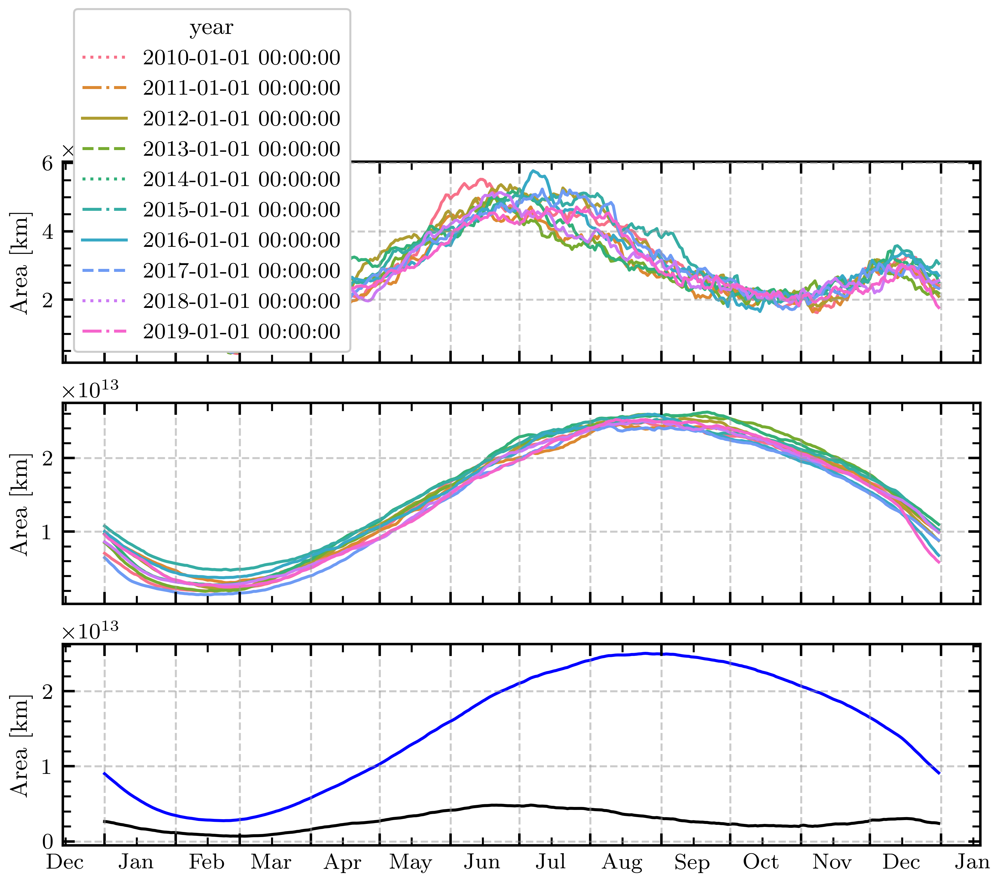

In [41]:
fig, axes = plt.subplots(3, 1, figsize=(width,height), sharex=True)
ax1 = axes[0]
ax2 = axes[1]
ax3 = axes[2]

sns.lineplot(ax=ax1, x="month_day", y='SIE_MIZ', label=None,
              data=df_tmp, errorbar=None, legend=True, hue = 'year')
sns.lineplot(ax=ax2, x="month_day", y='SIE_TOTAL', label=None,
              data=df_tmp, errorbar=None, legend=False, hue = 'year')
sns.lineplot(ax=ax3, x="month_day", y='SIE_MIZ', label=None,
              data=df_tmp, errorbar=None, legend=True)
sns.lineplot(ax=ax3, x="month_day", y='SIE_TOTAL', label=None,
              data=df_tmp, errorbar=None, legend=True)
#sns.lineplot(ax=ax1, x="date", y='SIE_TOTAL', label=None,
#              data=df_tmp_grp, errorbar=None, legend=False)
ax1.set_ylabel('Area [km]',)
ax1.set_xlabel('')
ax2.set_ylabel('Area [km]',)
ax2.set_xlabel('')
ax3.set_ylabel('Area [km]',)
ax3.set_xlabel('')
#ax1.set_ylim((0,10^9))
set_ax_date(ax1, plot_type="clim")

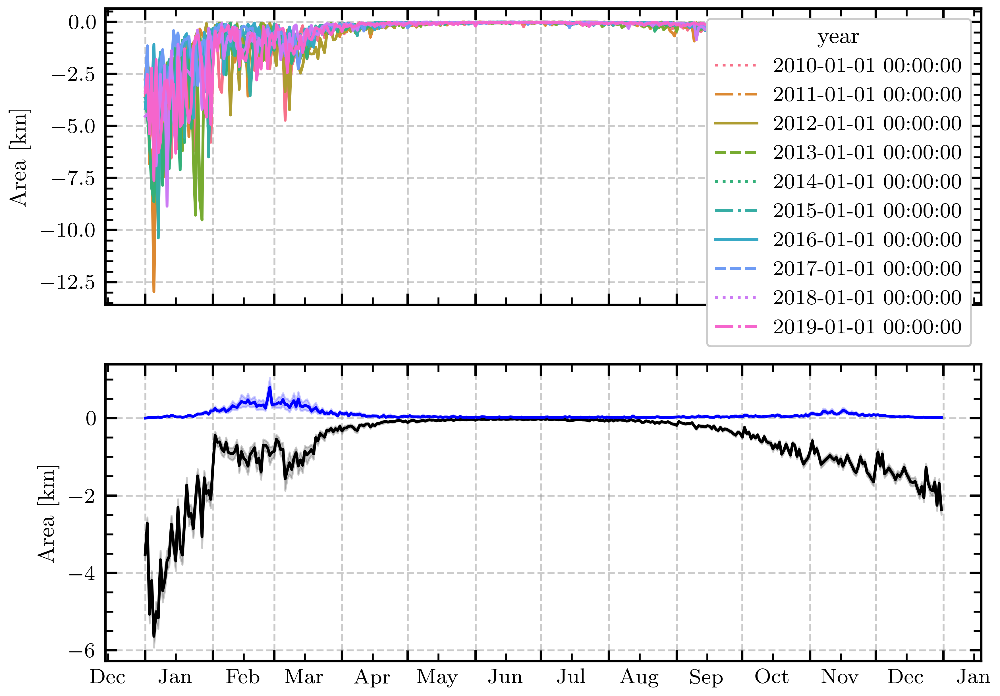

In [8]:
fig, axes = plt.subplots(2, 1, figsize=(width,height), sharex=True)
ax1 = axes[0]
ax2 = axes[1]
#ax3 = axes[2]

sns.lineplot(ax=ax1, x="month_day", y='dafsd_wave', label=None,
              data=df_miz_ts, errorbar=None, legend=True, hue = 'year')
sns.lineplot(ax=ax2, x="month_day", y='dafsd_wave', label=None,
              data=df_miz_ts, errorbar=('ci', 95), legend=True)
sns.lineplot(ax=ax2, x="month_day", y='dafsd_weld', label=None,
              data=df_miz_ts, errorbar=('ci', 95), legend=True)
#sns.lineplot(ax=ax1, x="date", y='SIE_TOTAL', label=None,
#              data=df_tmp_grp, errorbar=None, legend=False)
ax1.set_ylabel('Change in floe size due to breakup [m/day]',)
ax1.set_xlabel('')
ax2.set_ylabel('Change in floe size [m/day]',)
ax2.set_xlabel('')
#ax3.set_ylabel('Area [km]',)
#ax3.set_xlabel('')
#ax1.set_ylim((0,10^9))
set_ax_date(ax1, plot_type="clim")

In [4]:
df_tmp_grp = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/miz_ts_SIE_2010_2019.csv')

In [42]:
year_range = range(2010,2020)
df = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/forcing_analysis_'+str(year)+'.csv') 
                for year in tqdm(year_range, total = len(year_range), desc = "Reading in forcing analysis data")),
                ignore_index=True)
df_kmean = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/kmeans_'+str(year)+'.csv') 
                for year in tqdm(year_range, total = len(year_range), desc = "Reading in forcing analysis data")),
                ignore_index=True)
df_dyn = pd.DataFrame({'k': df_kmean["k"].values,
                             "date": df["date"].values,
                             #"uvel": df["uvel"].values,
                             #"vvel": df["vvel"].values,
                             #"uatm": df["uatm"].values,
                             #"vatm": df["vatm"].values,
                             "atm": np.sqrt(np.square(df["uatm"])+np.square(df["vatm"])),
                             "vel": np.sqrt(np.square(df["uvel"])+np.square(df["vvel"])),
                             #"shear": df["shear"].values,
                             #"divu": df["divu"].values,
                             #"strength": df["strength"].values,
                             "strint": np.sqrt(np.square(df["strintx"])+np.square(df["strinty"])),
                             #"strair": np.sqrt(np.square(df["strairx"])+np.square(df["strairy"])),
                            })
del df, df_kmean

Reading in forcing analysis data: 100%|██████████| 10/10 [00:27<00:00,  2.74s/it]


In [43]:
savepath = '/g/data/ia40/sea-ice-classification/dataframes/'
savefilename = 'velocities_'+str(year_range[0]) + '_' + str(year_range[-1])+'.csv'
df_dyn.to_csv(savepath+savefilename)

In [4]:
df_dyn = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/velocities_2010_2019.csv')
dates = pd.to_datetime(df_dyn['date'].values, format='%Y-%m-%d')
df_dyn['month-day'] = dates.strftime('%m-%d')
df_dyn.drop(df_dyn[df_dyn['month-day'] == '02-29'].index, inplace = True)
df_dyn['month-day'] = pd.to_datetime(df_dyn['month-day'].values, format='%m-%d')
dates = pd.to_datetime(df_dyn['date'].values, format='%Y-%m-%d')
df_dyn['year'] = dates.strftime('%Y')
df_dyn['year'] = pd.to_datetime(df_dyn['year'].values, format='%Y')

In [44]:
# Separate MIZ from the interior ice classes
idx = (df_dyn['k'].values == 0)
df_MIZ = df_dyn.iloc[idx,:].copy()



idx = (df_dyn['k'].values == 2)
temp_vec = df_dyn['k'].values
temp_vec[idx] = 1
df_dyn['k'] = temp_vec

idx = (df_dyn['k'].values == 1)
df_interior = df_dyn.iloc[idx,:].copy()

100%|██████████| 1314720/1314720 [00:03<00:00, 378878.54it/s]


(0.0, 300.0)

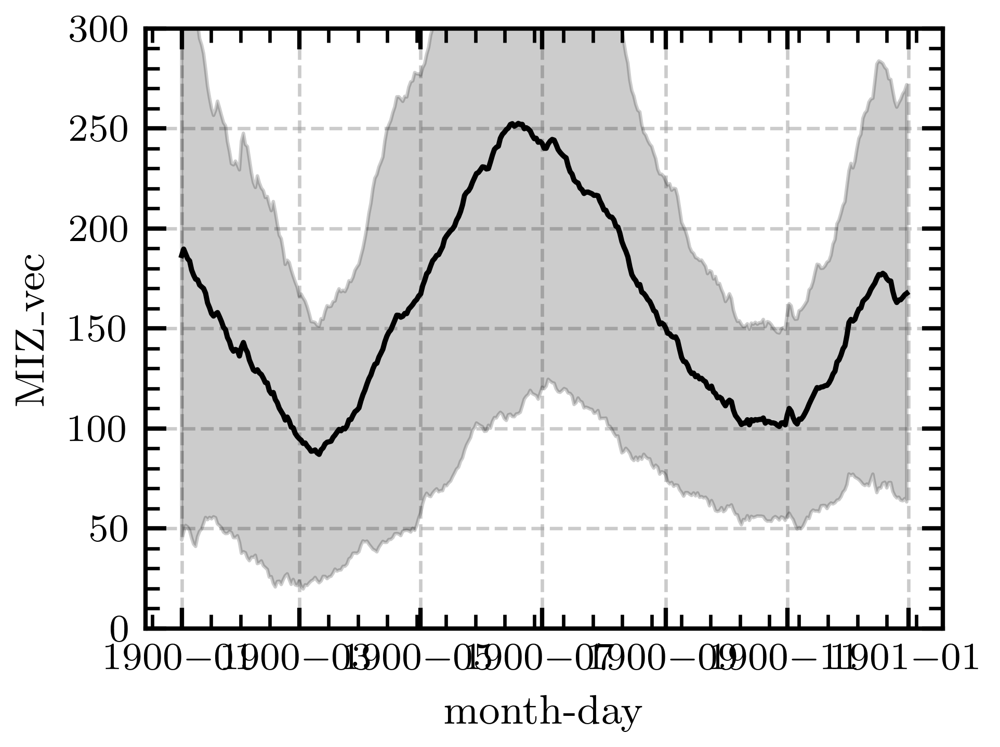

In [24]:
# Read in MIZ width
year_range = range(2010,2020)# = [2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019]

# Loop over the files in that year
for year_idx, year in tqdm(enumerate(year_range), total=len(year_range)):
#    progressBar = "\rProgress: " + ProgressBar(len(year_vec), year_idx+1, 20, '#', '.')
#    ShowBar(progressBar)

    # Open the file
    filename = "/g/data/ia40/sea-ice-classification/mizWidth_"+str(year)+".nc"
    ds = xr.open_dataset(filename)
    effective_miz_width_array = np.asarray(ds['k'])
    length_array, width_array = effective_miz_width_array.shape
#    print(year)
#    print(effective_miz_width_array.shape)
#    if length_array == 366:
#        print('Leap year!')
#        effective_miz_width_array = effective_miz_width_array[0:-1,:]
    date = np.empty((length_array,1))
    date[:,0] = np.arange(length_array)

    if year_idx == 0: 
        # First file, then initialise X_temp
        MIZ_vec = effective_miz_width_array.reshape(-1)
        length_array, width_array = effective_miz_width_array.shape
        date_vec = np.tile(date, [1,width_array]).reshape(-1)
    else:
        # Else just concatenate the new data on
        MIZ_vec = np.concatenate([MIZ_vec, effective_miz_width_array.reshape(-1)],axis=0)
        date_vec = np.concatenate([date_vec, np.tile(date, [1,width_array]).reshape(-1)],axis=0)

s = pd.date_range(start=str(year_range[0])+"-01-01",end=str(year_range[-1])+"-12-31")

from datetime import datetime
test = datetime.fromordinal(int(date_vec[0]+1+693595)) # start on Jan 1st 1900
test.strftime('%Y-%m-%d')
date = []
for i,day_idx in tqdm(enumerate(date_vec), total = len(date_vec)):
    tmp = datetime.fromordinal(int(day_idx+1+693595))
#    print(day_idx)
#    date[i] = test.strftime('%Y-%m-%d')
    date.append(tmp.strftime('%Y-%m-%d'))
    
df_plot = pd.DataFrame({'date': date, # For only month day use %m-%d
                        #'month_day': s.strftime('%m-%d'),
                        #'year': s.year,
                        'MIZ_vec': MIZ_vec/1000})

df_plot 
dates = pd.to_datetime(df_plot['date'].values, format='%Y-%m-%d')
df_plot['month-day'] = dates.strftime('%m-%d')
df_plot.drop(df_plot[df_plot['month-day'] == '02-29'].index, inplace = True)
df_plot['month-day'] = pd.to_datetime(df_plot['month-day'].values, format='%m-%d')
dates = pd.to_datetime(df_plot['date'].values, format='%Y-%m-%d')
df_plot['year'] = dates.strftime('%Y')
df_plot['year'] = pd.to_datetime(df_plot['year'].values, format='%Y')


sns.lineplot(x="month-day", y="MIZ_vec", errorbar=("sd", 1),
             data=df_plot)
plt.ylim((0,300))

In [26]:
# Statistics for paper
df_ts = df_plot.groupby('month-day').mean()
df_ts
# Annual maximum
print(df_ts.loc[df_ts['MIZ_vec'].idxmax()])


df_ts_december = df_ts[-31:]
# Summer maximum
print(df_ts_december.loc[df_ts_december['MIZ_vec'].idxmax()])

MIZ_vec    252.508669
Name: 1900-06-19 00:00:00, dtype: float64
MIZ_vec    177.554454
Name: 1900-12-19 00:00:00, dtype: float64


/jobfs/98288662.gadi-pbs/ipykernel_3763092/2074877290.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_ts = df_plot.groupby('month-day').mean()


### Plotting

In [20]:
import matplotlib.offsetbox
from matplotlib.lines import Line2D 

class AnchoredHScaleBar(matplotlib.offsetbox.AnchoredOffsetbox):
    """ size: length of bar in data units
        extent : height of bar ends in axes units """
    def __init__(self, size=1, extent = 0.03, label="", loc=2, ax=None,
                 pad=0.4, borderpad=0.5, ppad = 0, sep=2, prop=None, 
                 frameon=True, linekw={}, **kwargs):
        if not ax:
            ax = plt.gca()
        trans = ax.get_yaxis_transform()
        size_bar = matplotlib.offsetbox.AuxTransformBox(trans)
        line = Line2D([0,0],[size,0], **linekw)
        hline1 = Line2D([-extent/2.,extent/2.],[0,0], **linekw)
        hline2 = Line2D([-extent/2.,extent/2.],[size,size], **linekw)
        size_bar.add_artist(line)
        size_bar.add_artist(hline1)
        size_bar.add_artist(hline2)


        txt = matplotlib.offsetbox.TextArea(label, minimumdescent=False)
        self.vpac = matplotlib.offsetbox.VPacker(children=[size_bar,txt],  
                                 align="center", pad=ppad, sep=sep) 
        matplotlib.offsetbox.AnchoredOffsetbox.__init__(self, loc, pad=pad, 
                 borderpad=borderpad, child=self.vpac, prop=prop, frameon=frameon,
                 **kwargs)
file = '/g/data/ia40/cice-dirs/runs/waves-10/history/iceh.2010-09-01.nc'

ds = xr.open_dataset(file)
aice = ds.aice
lat = ds.TLAT
dA = ds.HTE
dA_south = dA.where(lat<0, drop=True)
# First take only the southern hemisphere
aice_south = (ds.aice.where(lat<0, drop=True)).squeeze() 
# Then take all ice exceeding the ice edge
aice_only= aice_south.where(aice_south>0.15, drop=True) 

hte_south = (ds.HTE.where(lat<0, drop=True))
hte_aice_only = hte_south.where(aice_south>0.15, drop=True)
print(hte_aice_only.mean()/1000)
hte_south.mean()/1000

<xarray.DataArray 'HTE' ()>
array(57.82819922)
Coordinates:
    time     datetime64[ns] 2010-09-02


<xarray.DataArray 'HTE' ()>
array(63.30805859)

In [ ]:
# import numpy as np
# import matplotlib.pyplot as plt
# from matplotlib_scalebar.scalebar import ScaleBar
# import matplotlib.image as mpimg

# %config InlineBackend.figure_format='retina'
# %config InlineBackend.print_figure_kwargs = {'pad_inches':0}


# def imshow_bar(im, scalebar):
#     fig, ax = plt.subplots(figsize=(2, 2), dpi=60)
#     ax.axis("off")
#     ax.imshow(im)
#     ax.add_artist(scalebar)


# img = mpimg.imread("green.png")
# scalebar = ScaleBar(0.3, "mm", sep=10)
# imshow_bar(img, scalebar)

In [26]:
#df_miz_ts['year']
df_miz_ts = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/miz_ts_2010_2019.csv')
dates = pd.to_datetime(df_miz_ts['date'].values, format='%Y-%m-%d')
df_miz_ts['month-day'] = dates.strftime('%m-%d')
df_miz_ts.drop(df_miz_ts[df_miz_ts['month-day'] == '02-29'].index, inplace = True)
df_miz_ts['month-day'] = pd.to_datetime(df_miz_ts['month-day'].values, format='%m-%d')
dates = pd.to_datetime(df_miz_ts['date'].values, format='%Y-%m-%d')
df_miz_ts['year'] = dates.strftime('%Y')
df_miz_ts['year'] = pd.to_datetime(df_miz_ts['year'].values, format='%Y')

#mask = (df_miz_ts['date'] >= '2010-03-01') & (df_miz_ts['date'] < '2019-12-01')
#df_miz_ts = df_miz_ts.loc[mask]

In [27]:
df_ts = df_miz_ts.groupby('month-day').mean(numeric_only=True)
df_ts
# Annual minimum
print(df_ts.loc[df_ts['fsdrad'].idxmin()])

# Annual maximum
print(df_ts.loc[df_ts['fsdrad'].idxmax()])

df_ts['iage'].describe()
# df_ts_december = df_ts[-31:]
# # Summer maximum
# print(df_ts_december.loc[df_ts_december['MIZ_vec'].idxmax()])

# Annual minimum
print(df_ts.loc[df_ts['iage'].idxmin()])

Unnamed: 0.1    1.366911e+06
Unnamed: 0      8.187281e+04
k               0.000000e+00
frazil          5.662326e-01
congel          6.755907e-01
wave_sig_ht     5.724998e-01
daidtd         -2.046238e+00
daidtt          6.750545e+00
divu            2.347518e-02
uatm            5.846356e-01
vatm            5.436978e-01
uvel            1.603373e-02
vvel            2.454673e-02
dafsd_wave     -4.447448e-02
dafsd_latg      1.003002e-05
dafsd_latm     -4.014248e-04
dafsd_weld      3.811468e-02
dafsd_newi      4.223956e-02
aice            9.306213e-01
fsdrad          1.153867e+01
iage            9.767169e-02
hi              2.177534e-01
Name: 1900-05-03 00:00:00, dtype: float64
Unnamed: 0.1    1.127135e+06
Unnamed: 0      5.761747e+02
k               0.000000e+00
frazil          8.730271e-02
congel          8.685033e-04
wave_sig_ht     2.942119e-01
daidtd         -3.781180e-01
daidtt         -3.021946e+00
divu           -2.883265e-01
uatm           -3.917744e-01
vatm           -1.007014e-01
u

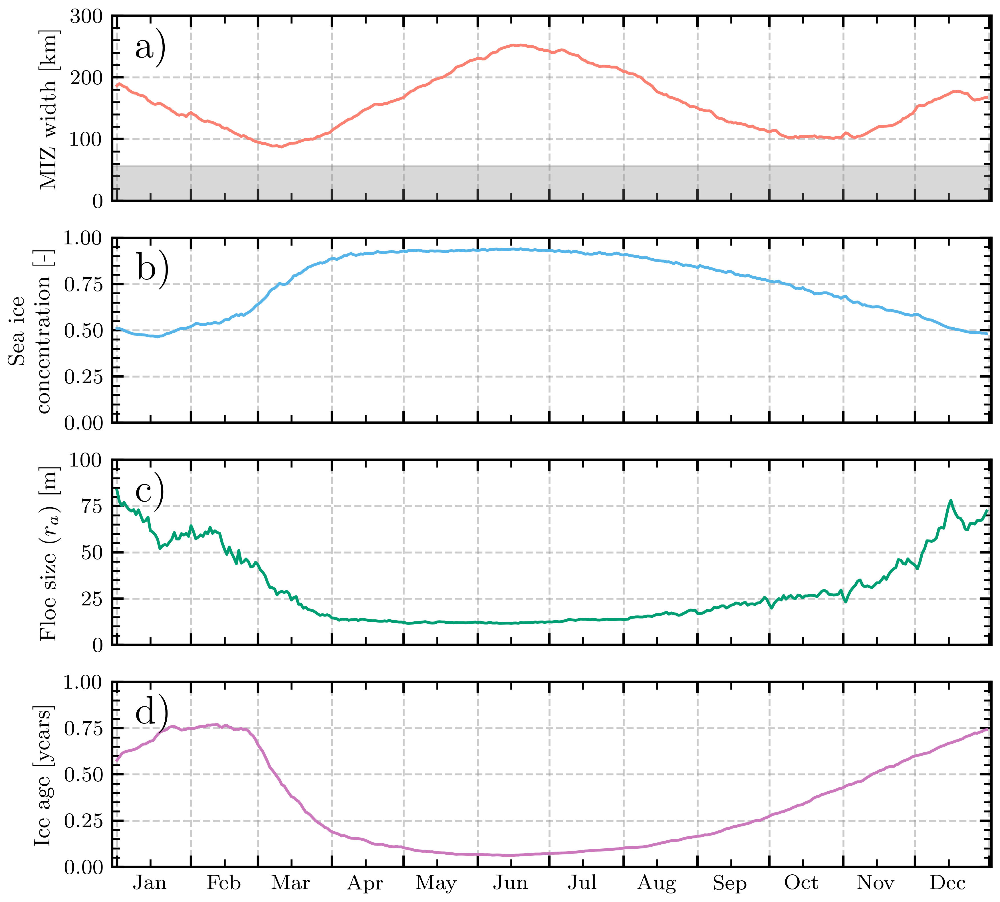

In [34]:
import textwrap
max_chars = 24

fig, axes = plt.subplots(4, 1, figsize=(width,height*1.3), sharex=True)
ax1 = axes[0]
ax2 = axes[1]
ax3 = axes[2]
ax4 = axes[3]

x = "month-day"
#"date" #"month-day"

# MIZ width (uncorrected) ----------------------------------------------------------------------------
sns.lineplot(ax=ax1, x=x, y="MIZ_vec", data=df_plot, label=None,
              errorbar=None, legend=False, color=COLOR_MIZ)#, hue = 'year')

ax1.set_ylabel(textwrap.fill('MIZ width [km]', max_chars))
#ax1.set_xlim((np.round(ax1.get_xlim()[0]+16),np.round(ax1.get_xlim()[-1]-16)))
#set_ax_date(ax1, plot_type="clim")
ax1.set_xticklabels([])
monthly_locator = mdates.MonthLocator()
ax1.xaxis.set_major_locator(mdates.MonthLocator())
ax1.xaxis.set_minor_locator(mdates.MonthLocator(bymonthday=15))
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.set_xlabel('')

#font = {'family':'serif','size':6}
#scalebar = ScaleBar(0.3/56.75457813, rotation="vertical", sep = 1, location="lower right", height_fraction=0.002, font_properties = font,
#                    scale_formatter=lambda value, unit: f"", label = "Cell width", label_loc="right", box_alpha=0.0, border_pad=0.5)
#ax1.add_artist(scalebar)
ax1.axhspan(0.0,56.75457813, color='gray', alpha=0.3, linestyle ='-')
ax1.set_ylim((0,300))
#label_loc="right",

# SIC ----------------------------------------------------------------------------
sns.lineplot(ax=ax2, x=x, y='aice', label=None,
              data=df_miz_ts, errorbar=None, color=sns.color_palette("colorblind",15)[9])
ax2.set_ylabel("Sea ice\n concentration [-]", color='black')
#ax2.set_ylabel(textwrap.fill('Sea ice\n concentration [-]', max_chars))
ax2.set_xlabel("")
ax2.set_xticklabels([])
ax2.set_ylim((0,1))
#ax2.set_xlim((np.round(ax2.get_xlim()[0]+16),np.round(ax2.get_xlim()[-1]-16)))

#axtmp.set_xlim((np.round(axtmp.get_xlim()[0]+16),np.round(axtmp.get_xlim()[-1]-16)))
#axtmp.set_ylim((0, 100))
#legend = ax2.legend(['Floe size', 'SIC', 'Age'], fancybox=False, edgecolor="black", loc = 'lower center')# loc='upper right', ncol=1, fancybox=True, edgecolor="black")
#from matplotlib.lines import Line2D
#custom_lines = [Line2D([0], [0], color=COLOR_FSD, lw=1),
#                Line2D([0], [0], color=sns.color_palette("colorblind",15)[9], lw=1),
#                Line2D([0], [0], color=sns.color_palette("colorblind",15)[-1], lw=1)]
#ax2.legend(custom_lines, ['Floe size', 'SIC', 'Age'], fancybox=False, edgecolor="black", loc = 'center')
#set_ax_date(ax2, plot_type="clim")

ax2.set_xticklabels([])
#month_year_formatter = mdates.DateFormatter('%b') 
monthly_locator = mdates.MonthLocator()
ax2.xaxis.set_major_locator(mdates.MonthLocator())
ax2.xaxis.set_minor_locator(mdates.MonthLocator(bymonthday=15))
ax2.xaxis.set_major_formatter(NullFormatter())
#ax1.xaxis.set_minor_formatter(mdates.DateFormatter('%b'))
ax2.set_xlabel('')




# Floe size ----------------------------------------------------------------------------
sns.lineplot(ax=ax3, x=df_miz_ts[x], y=df_miz_ts['fsdrad'], label=None, legend=False,
               errorbar=None, color= COLOR_FSD)#, legend=True)
#sns.lineplot(ax=ax3, x="month-day", y='dafsd_weld', label='Welding',
#              data=df_miz_ts, errorbar=None)#, legend=True)
#sns.lineplot(ax=ax3, x="month-day", y='dafsd_newi', label='New ice formation',
#              data=df_miz_ts, errorbar=None)#, legend=True)
#ax3.set_ylabel("Representive floe size\n [m/day]")
ax3.set_xlabel("")
ax3.set_xticklabels([])
ax3.set_ylabel(textwrap.fill('Floe size ($r_a$) [m]', max_chars))
ax3.set_ylim((0,100))
#ax3.set_xlim((np.round(ax3.get_xlim()[0]+16),np.round(ax3.get_xlim()[-1]-16)))

#month_year_formatter = mdates.DateFormatter('%b') 
monthly_locator = mdates.MonthLocator()
ax3.xaxis.set_major_locator(mdates.MonthLocator())
ax3.xaxis.set_minor_locator(mdates.MonthLocator(bymonthday=15))
ax3.xaxis.set_major_formatter(NullFormatter())
#ax1.xaxis.set_minor_formatter(mdates.DateFormatter('%b'))
ax3.set_xlabel('')

# custom_lines = [Line2D([0], [0], color=sns.color_palette("colorblind",15)[0], lw=1),
#                 Line2D([0], [0], color=sns.color_palette("colorblind",15)[1], lw=1)]
# axtmp3.legend(custom_lines, ['Wave breakup', 'Ice speed'], fancybox=False, edgecolor="black", loc = 'upper right')


# Ice age ----------------------------------------------------------------------------
sns.lineplot(ax=ax4, x=df_miz_ts[x], y=df_miz_ts['iage'], label=None, legend=False,
               errorbar=None, color= sns.color_palette("colorblind",15)[4])
ax4.set_xlim((np.round(ax4.get_xlim()[0]+16),np.round(ax4.get_xlim()[-1]-16)))
set_ax_date(ax4, plot_type="clim")
ax4.set(ylabel = "Ice age [years]", xlabel="", ylim=(0,1.0))
#ax4.set_ylabel(textwrap.fill('Ice age [years]', max_chars))


trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
ax1.text(0.0, 1.0, 'a)', transform=ax1.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax2.text(0.0, 1.0, 'b)', transform=ax2.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax3.text(0.0, 1.0, 'c)', transform=ax3.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax4.text(0.0, 1.0, 'd)', transform=ax4.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
    

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'seasonal_MIZ.png', dpi = 600, bbox_inches="tight")
plt.savefig(savepath+'seasonal_MIZ.pdf')
plt.show()

In [8]:
df_miz_ts['date'] = pd.to_datetime(df_miz_ts['date'], format="%Y-%m-%d")



#df_timeseries_MIZ = df_miz_ts.groupby(['date']).rolling(7).mean(numeric_only=True)
df_timeseries_MIZ = df_miz_ts.groupby(['date']).mean()
df_timeseries_MIZ['MIZ_extent'] = df_tmp_grp['SIE_MIZ'].values
ma_period = 7
df_timeseries_MIZ['dafsd_wave'] = -cyclic_moving_av(np.array(df_timeseries_MIZ['dafsd_wave']), n = ma_period)
df_timeseries_MIZ['dafsd_weld'] = cyclic_moving_av(np.array(df_timeseries_MIZ['dafsd_weld']), n = ma_period)
df_timeseries_MIZ['dafsd_newi'] = cyclic_moving_av(np.array(df_timeseries_MIZ['dafsd_newi']), n = ma_period)

df_timeseries_MIZ['MIZ_extent'] = cyclic_moving_av(np.array(df_timeseries_MIZ['MIZ_extent']), n = ma_period)*10**(-12)
df_timeseries_MIZ['dMIZ_extentdt'] = df_timeseries_MIZ['MIZ_extent'].diff()
df_timeseries_MIZ['dMIZ_extentdt'] = cyclic_moving_av(np.array(df_timeseries_MIZ['dMIZ_extentdt']), n = ma_period)#*10**(-12)
df_timeseries_MIZ['divu'] = cyclic_moving_av(np.array(df_timeseries_MIZ['divu']), n = ma_period)
df_timeseries_MIZ['neg_daidtd'] = -cyclic_moving_av(np.array(df_timeseries_MIZ['daidtd']), n = ma_period)
df_timeseries_MIZ['daidtt'] = cyclic_moving_av(np.array(df_timeseries_MIZ['daidtt']), n = ma_period)
df_timeseries_MIZ['frazil'] = cyclic_moving_av(np.array(df_timeseries_MIZ['frazil']), n = ma_period)
df_timeseries_MIZ['fsdrad_ma'] = cyclic_moving_av(np.array(df_timeseries_MIZ['fsdrad']), n = ma_period)
df_timeseries_MIZ['iage_ma'] = cyclic_moving_av(np.array(df_timeseries_MIZ['iage']), n = ma_period)
df_timeseries_MIZ['aice_ma'] = cyclic_moving_av(np.array(df_timeseries_MIZ['aice']), n = ma_period)
df_timeseries_MIZ['hi_ma'] = cyclic_moving_av(np.array(df_timeseries_MIZ['hi']), n = ma_period)

df_timeseries_MIZ['divu_norm'] = df_timeseries_MIZ['divu']/(df_timeseries_MIZ['divu'].abs().max())
df_timeseries_MIZ['neg_daidtd_norm'] = df_timeseries_MIZ['neg_daidtd']/(df_timeseries_MIZ['neg_daidtd'].abs().max())
df_timeseries_MIZ['daidtt_norm'] = df_timeseries_MIZ['daidtt']/(df_timeseries_MIZ['daidtt'].abs().max())
df_timeseries_MIZ['frazil_norm'] = df_timeseries_MIZ['frazil']/(df_timeseries_MIZ['frazil'].abs().max())

In [ ]:
#df_tmp_grp['SIE_MIZ'].values
df_timeseries_MIZ['date']

Reading in FSD analysis data: 100%|██████████| 10/10 [00:19<00:00,  1.92s/it]


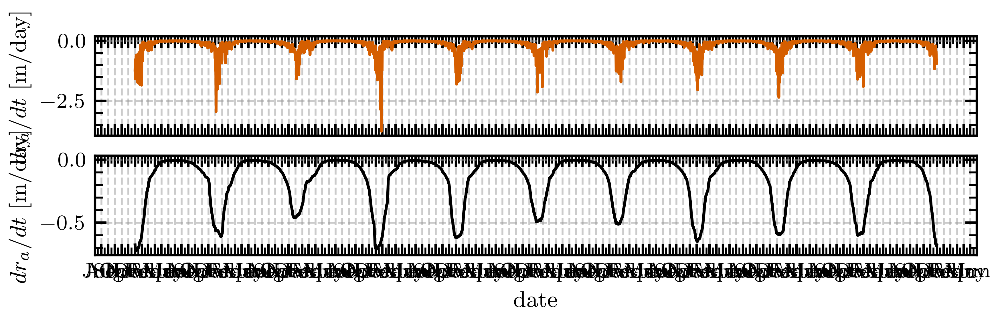

In [29]:
year_range = range(2010, 2020) # [2010, 2011, 2013, 2014, 2015, 2017, 2018, 2019] #range(2010,2020)
# df_miz_ts = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/miz_ts_'+str(year)+'.csv') 
#                 for year in tqdm(year_range, total = len(year_range), desc = "Reading in MIZ time series data")),
#                 ignore_index=True)

df_miz_ts = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/analysis_fsd_raw_'+str(year)+'.csv') 
                for year in tqdm(year_range, total = len(year_range), desc = "Reading in FSD analysis data")),
                ignore_index=True)
ma_period = 60
df_timeseries_MIZ = df_miz_ts.groupby(['date']).mean()
df_timeseries_MIZ['dafsd_wave_ma'] = cyclic_moving_av(np.array(df_timeseries_MIZ['dafsd_wave']), n = ma_period)

fig, axes = plt.subplots(2, 1, figsize=(width,height/3), sharex=True)
ax1 = axes[0]
ax2 = axes[1]
sns.lineplot(ax=ax1, x="date", y='dafsd_wave', label=None,
              data=df_miz_ts, errorbar=None, legend=False,
              color=COLOR_WAVE)

sns.lineplot(ax=ax2, x="date", y='dafsd_wave_ma', label=None,
              data=df_timeseries_MIZ, errorbar=None, legend=False)
ax1.set_ylabel('$dr_{a}/dt$ [m/day]',)
ax2.set_ylabel('$dr_{a}/dt$ [m/day]',)
set_ax_date(ax1, plot_type="clim")

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'dafsd_wave_decade.png', dpi = 600, bbox_inches="tight")
plt.show()

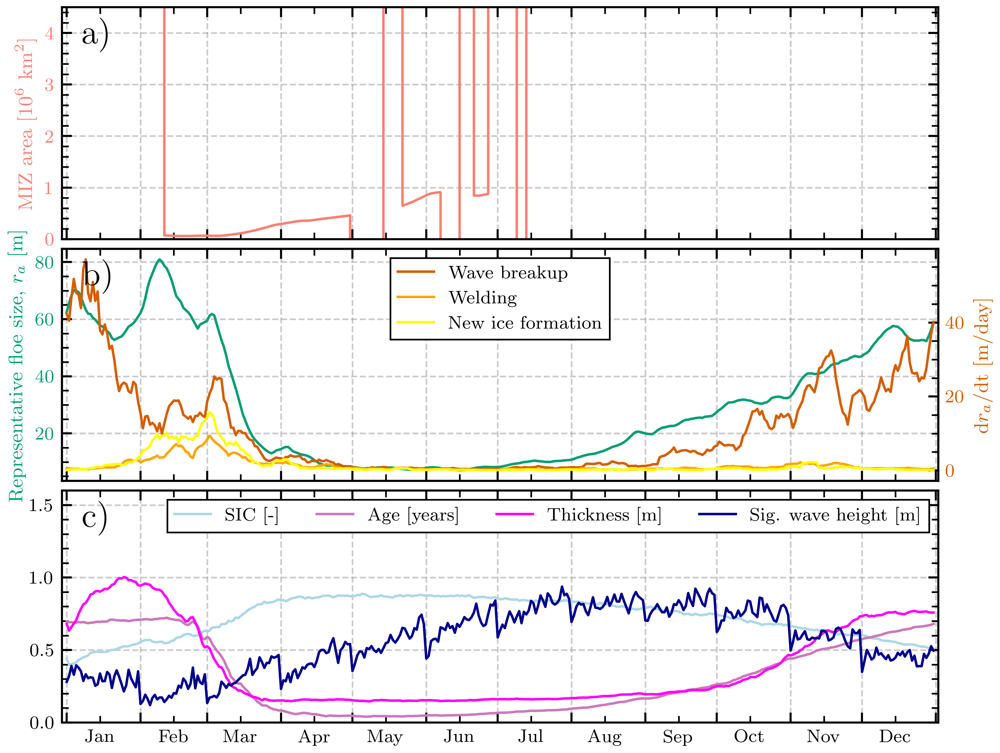

In [18]:
fig, axes = plt.subplots(3, 1, figsize=(width,height), sharex=True)
ax1 = axes[0]
ax2 = axes[1]
ax3 = axes[2]

sns.lineplot(ax=ax1, x="date", y="MIZ_extent",
            data=df_timeseries_MIZ, errorbar=None, legend=False,
              color=COLOR_MIZ)
ax1.set_ylabel('MIZ area [$10^6$ km$^2$]', color=COLOR_MIZ)
ax1.tick_params(axis="y", labelcolor=COLOR_MIZ)
ax1.set_ylim((0, 4.5))
ax1.set_xlabel("")
ax1.set_xticklabels([])




# Floe size stuff
sns.lineplot(ax=ax2, x="date", y="fsdrad_ma",
            data=df_timeseries_MIZ, errorbar=None, legend=False,
              color=COLOR_FSD)
ax2.set_ylabel("Representative floe size, $r_a$ [m]", color=COLOR_FSD)
ax2.tick_params(axis="y", labelcolor=COLOR_FSD)
#ax1.set_ylim((0, 4))

axtmp = ax2.twinx()
sns.lineplot(ax=axtmp, x="date", y="dafsd_wave",
              data=df_timeseries_MIZ, errorbar=None, legend=False,
              color=COLOR_WAVE)
sns.lineplot(ax=axtmp, x="date", y="dafsd_weld",
              data=df_timeseries_MIZ, errorbar=None, legend=False,
              color='orange')
sns.lineplot(ax=axtmp, x="date", y="dafsd_newi",
              data=df_timeseries_MIZ, errorbar=None, legend=False,
              color='yellow')

legend = axtmp.legend(['Wave breakup', 'Welding', 'New ice formation'], fancybox=False, edgecolor="black", loc = 'upper center')# loc='upper right', ncol=1, fancybox=True, edgecolor="black")

axtmp.set_ylabel('d$r_a$/dt [m/day]', color=COLOR_WAVE)
axtmp.tick_params(axis="y", labelcolor=COLOR_WAVE)
##axtmp.set_yticks([0, 20, 40, 60, 80])
#axtmp.set_ylim((0.0, 3.0))
#axtmp.set_yticks([0, 0.4, 0.8, 1.2, 1.6, 2.0])

axtmp.grid(False)
#axtmp.set_ylim((0, 100))
set_ax_date(ax1, plot_type="clim")
ax2.set_xlabel("")
ax2.set_xlim((np.round(ax2.get_xlim()[0]+16),np.round(ax2.get_xlim()[-1]-16)))
#ax1.set_xticklabels([])


    
# Other variables
sns.lineplot(ax=ax3, x="date", y="aice",
            data=df_timeseries_MIZ, errorbar=None, legend=False, color='lightblue')
sns.lineplot(ax=ax3, x="date", y="iage",
            data=df_timeseries_MIZ, errorbar=None, legend=False, color=COLOR_IAGE)
sns.lineplot(ax=ax3, x="date", y="hi",
            data=df_timeseries_MIZ, errorbar=None, legend=False, color='magenta')
sns.lineplot(ax=ax3, x="date", y="wave_sig_ht",
            data=df_timeseries_MIZ, errorbar=None, legend=False, color='darkblue')
legend = ax3.legend(['SIC [-]', 'Age [years]', 'Thickness [m]', 'Sig. wave height [m]'], fancybox=False, edgecolor="black", loc = 'upper right', ncol=4)# loc='upper right', ncol=1, fancybox=True, edgecolor="black")
ax3.set_ylabel('')
ax3.set_ylim((0, 1.6))
#ax2.set_ylabel("Representative floe size, $r_a$ [m]", color=COLOR_FSD)
    
    
    
    
    
    
#axtmp = ax1.twinx()
#sns.lineplot(ax=axtmp, x="date", y="iage",
#                     data=df_timeseries_MIZ, errorbar=None, legend=False,color=COLOR_IAGE)
#axtmp.set_ylabel("Age of ice [years]", color=COLOR_IAGE)
#
#axtmp.tick_params(axis="y", labelcolor=COLOR_IAGE)
#axtmp.grid(False)
#axtmp.set_ylim((0, 1.0))
#axtmp.set_yticks([0, 0.25, 0.5, 0.75, 1.0])


        
set_ax_date(ax3, plot_type="clim")
ax3.set_xlabel('')
    
    
trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
ax1.text(0.0, 1.0, 'a)', transform=ax1.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
axtmp.text(0.0, 1.0, 'b)', transform=ax2.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax3.text(0.0, 1.0, 'c)', transform=ax3.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))

    
fig.tight_layout(pad=0.0)

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'MIZ_evolution_ts.png', dpi = 600, bbox_inches="tight")
plt.savefig(savepath+'MIZ_evolution_ts.pdf', bbox_inches="tight")

plt.show()

# Figure 8: FINAL

In [3]:
year_range = range(2010,2020)


df_fsd = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/analysis_fsd_raw_'+str(year)+'.csv') 
                for year in tqdm(year_range, total = len(year_range), desc = "Reading in FSD analysis data")),
                ignore_index=True)
df_kmeans = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/kmeans_'+str(year)+'.csv') 
                for year in tqdm(year_range, total = len(year_range), desc = "Reading in kmeans data")),
                ignore_index=True)

df['k'] = df_kmeans['k']
df_fsd['k'] = df_kmeans['k']
unique_dates = df_fsd['date'].unique()
df.groupby('k').describe()

Reading in kmeans data:  40%|████      | 4/10 [00:26<00:42,  7.05s/it]
KeyboardInterrupt



In [16]:
year_range =  [2016] # [2018] 
#[2010, 2011, 2013, 2014, 2015, 2017, 2018, 2019] #range(2017,2020)
year = year_range[0]
year_range = range(2010,2011)
for year in tqdm(year_range, total = len(year_range)):
    df = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/forcing_analysis_'+str(year)+'.csv')
    df_dafsd = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/analysis_fsd_raw_'+str(year)+'.csv')
    df_kmean = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/kmeans_'+str(year)+'.csv')
    df_raw = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/raw_'+str(year)+'.csv')

    df['k'] = df_kmean['k']
    df_dafsd['k'] = df_kmean['k']


    # create DataFrame
    t = pd.to_datetime(df["date"].values, format="%Y-%m-%d")
    df_pancake = pd.DataFrame({'k': df["k"].values,
                             "date": t.strftime('%Y-%m-%d'),
                             "frazil": df["frazil"].values,
                             "congel": df["congel"].values,
                             #"pancake": df_dafsd["pancake"].values,
                             "wave_sig_ht": df["wave_sig_ht"].values,
                             "daidtd": df["daidtd"].values,
                             "daidtt": df["daidtt"].values,
    #                         "dagedtd": df["dagedtd"].values,
    #                         "dagedtt": df["dagedtt"].values,
                             "divu": df["divu"].values,
                             "uatm": df["uatm"].values,
                             "vatm": df["vatm"].values,
                             "uvel": df["uvel"].values,
                             "vvel": df["vvel"].values,
                             "dafsd_wave": df_dafsd["dafsd_wave"].values,
                             "dafsd_latg": df_dafsd["dafsd_latg"].values,
                             "dafsd_latm": df_dafsd["dafsd_latm"].values,
                             "dafsd_weld": df_dafsd["dafsd_weld"].values,
                             "dafsd_newi": df_dafsd["dafsd_newi"].values,
                             "aice": df_raw["aice"].values,
                             "fsdrad": df_raw["fsdrad"].values,
                             "iage": df_raw["iage"].values,
                             "hi": df_raw["hi"].values
                                })
#    df_pancake.drop(df_pancake[df_pancake['date'] == '02-29'].index, inplace = True)
    #('-02-29')


    del df_dafsd, df_raw, df_kmean

    df_pancake['date'] = pd.to_datetime(df_pancake['date'], format="%Y-%m-%d")
#    df_timeseries = df_pancake.groupby(['date', 'k']).rolling(7).mean(numeric_only=True)
    # Get MIZ cluster only
    df_pancake = df_pancake.loc[df_pancake['k'] == 0]
    df_miz_ts = pd.DataFrame({'k': df_pancake["k"].values,
                             "date": df_pancake["date"].values,
                             "frazil": df_pancake["frazil"].values,
                             "congel": df_pancake["congel"].values,
                             #"pancake": df_pancake["pancake"].values,
                             "wave_sig_ht": df_pancake["wave_sig_ht"].values,
                             "daidtd": df_pancake["daidtd"].values,
                             "daidtt": df_pancake["daidtt"].values,
                             "divu": df_pancake["divu"].values,
                             "uatm": df_pancake["uatm"].values,
                             "vatm": df_pancake["vatm"].values,
                             "uvel": df_pancake["uvel"].values,
                             "vvel": df_pancake["vvel"].values,
                             "atm": np.sqrt(np.square(df_pancake["uatm"])+np.square(df_pancake["vatm"])),
                             "vel": np.sqrt(np.square(df_pancake["uvel"])+np.square(df_pancake["vvel"])),
                             "dafsd_wave": df_pancake["dafsd_wave"].values,
                             "dafsd_latg": df_pancake["dafsd_latg"].values,
                             "dafsd_latm": df_pancake["dafsd_latm"].values,
                             "dafsd_weld": df_pancake["dafsd_weld"].values,
                             "dafsd_newi": df_pancake["dafsd_newi"].values,
                             "aice": df_pancake["aice"].values,
                             "fsdrad": df_pancake["fsdrad"].values,
                             "iage": df_pancake["iage"].values,
                              "hi": df_pancake["hi"].values
                                })
    savepath = '/g/data/ia40/sea-ice-classification/dataframes/'
    savefilename = 'miz_ts_'+str(year)+'.csv'
    df_miz_ts.to_csv(savepath+savefilename)

100%|██████████| 1/1 [00:56<00:00, 56.52s/it]


In [17]:
#year_range = range(2010,2020)

for year in tqdm(year_range):
    df_miz_ts = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/miz_ts_'+str(year)+'.csv')
    df_fsd = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/analysis_fsd_raw_'+str(year)+'.csv')
    df_forcing = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/forcing_analysis_'+str(year)+'.csv')
    df_kmean = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/kmeans_'+str(year)+'.csv')


    df_out = df_fsd.copy()
    df_out['k'] = df_kmean['k']
    df_out['vel'] = np.sqrt(np.square(df_forcing["uvel"])+np.square(df_forcing["vvel"]))
    df_out['meltl'] = df_forcing["meltl"]
    df_out['meltt'] = df_forcing["meltt"]
    df_out['meltb'] = df_forcing["meltb"]
    
    savepath = '/g/data/ia40/sea-ice-classification/dataframes/'
    savefilename = 'dynamics_'+str(year)+'.csv'
    df_out.to_csv(savepath+savefilename)


100%|██████████| 1/1 [01:32<00:00, 92.70s/it]


In [87]:
df.head()

,Unnamed: 0.1,Unnamed: 0,k,date,frazil,congel,wave_sig_ht,daidtd,daidtt,divu,...,vvel,dafsd_wave,dafsd_latg,dafsd_latm,dafsd_weld,dafsd_newi,aice,fsdrad,iage,hi
0,0,0,0,2019-01-01,0.0,0.001707,0.310028,-0.324340,-13.975185,1.231888,...,0.005366,-30.671341,0.0,-0.412037,0.0,0.0,0.367741,295.44437,0.482966,0.770539
1,1,1,0,2019-01-01,0.0,0.000000,0.341252,0.260103,-5.880522,-2.817638,...,-0.004166,-23.867299,0.0,-0.228838,0.0,0.0,0.775908,146.99808,0.525981,1.970840
2,2,2,0,2019-01-01,0.0,0.000000,0.406859,-1.518448,-7.593342,-4.054571,...,-0.011832,-22.467117,0.0,-0.256482,0.0,0.0,0.652595,135.86893,0.536262,1.520660
3,3,3,0,2019-01-01,0.0,0.000000,0.461997,-2.361890,-11.832830,-3.657929,...,-0.011846,-21.041107,0.0,-0.327965,0.0,0.0,0.304681,137.52397,0.546301,0.608408
4,4,4,0,2019-01-01,0.0,0.000000,0.015624,-1.772373,-5.924854,2.956196,...,-0.058957,0.000000,0.0,-1.438594,0.0,0.0,0.180092,523.14200,0.636005,0.348520


In [18]:
# Separate MIZ from the interior
#year_range = range(2010,2020)
df = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/dynamics_'+str(year)+'.csv') 
                for year in tqdm(year_range, total = len(year_range), desc = "Reading in forcing analysis data")),
                ignore_index=True)
df.describe()
df['date'] = pd.to_datetime(df['date'], format="%Y-%m-%d")
dates = pd.to_datetime(df['date'].values, format='%Y-%m-%d')
df['month-day'] = dates.strftime('%m-%d')
df.drop(df[df['month-day'] == '02-29'].index, inplace = True)
df['month-day'] = pd.to_datetime(df['month-day'].values, format='%m-%d')
dates = pd.to_datetime(df['date'].values, format='%Y-%m-%d')
df['year'] = dates.strftime('%Y')
df['year'] = pd.to_datetime(df['year'].values, format='%Y')

idx2 = (df['k'].values == 2)

df_temp = df
temp_vec = df_temp['k'].values
temp_vec[idx2] = 1
df_temp['k'] = temp_vec

idx0 = (df_temp['k'].values == 0)
df_MIZ = df_temp.iloc[idx0,:]


idx1 = (df_temp['k'].values == 1)
df_interior = df_temp.iloc[idx1,:]

del df, idx0, idx1, dates, df_temp, temp_vec

savepath = '/g/data/ia40/sea-ice-classification/dataframes/'
savefilename = 'dynamics_MIZ_2010_2019.csv'
df_MIZ.to_csv(savepath+savefilename)
savefilename = 'dynamics_Interior_2010_2019.csv'
df_interior.to_csv(savepath+savefilename)

Reading in forcing analysis data: 100%|██████████| 1/1 [00:16<00:00, 16.50s/it]


### Read in data

In [9]:
df_MIZ = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/dynamics_MIZ_2010_2019.csv') 
df_interior = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/dynamics_Interior_2010_2019.csv') 

def movingAverages(seq, k):
    circle = seq + seq[:k]
    for j in range(len(seq)):
        yield sum(circle[j:j+k])/k

index = df_MIZ[(df_MIZ['month-day'] == df_MIZ['month-day'].values[0])].index
df_MIZ['meltl'][index] = df_MIZ[(df_MIZ['month-day'] == df_MIZ['month-day'].values[-1])]['meltl'].mean()


index = df_interior[(df_interior['month-day'] == df_interior['month-day'].values[0])].index
df_interior['meltl'][index] = df_interior[(df_interior['month-day'] == df_interior['month-day'].values[-1])]['meltl'].mean()


df_interior_grouped = df_interior.groupby(by=["month-day"], dropna=False)['dafsd_wave', 'vel', 'meltb', 'meltl', 'meltt'].mean()
df_MIZ_grouped = df_MIZ.groupby(by=["month-day"], dropna=False)['dafsd_wave', 'vel', 'meltb', 'meltl', 'meltt'].mean()

/jobfs/98717756.gadi-pbs/ipykernel_1779848/1584977417.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_MIZ['meltl'][index] = df_MIZ[(df_MIZ['month-day'] == df_MIZ['month-day'].values[-1])]['meltl'].mean()
/jobfs/98717756.gadi-pbs/ipykernel_1779848/1584977417.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_interior['meltl'][index] = df_interior[(df_interior['month-day'] == df_interior['month-day'].values[-1])]['meltl'].mean()
/jobfs/98717756.gadi-pbs/ipykernel_1779848/1584977417.py:17: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list inste

In [10]:
#test = movingAverages(df_MIZ_grouped['dafsd_wave'].values, 30)
#test
# Statistics for paper
ma_period = 1
dafsd_wave_MIZ = cyclic_moving_av(np.array(df_MIZ_grouped['dafsd_wave'].values), n = ma_period)
(-dafsd_wave_MIZ).max()

vel_MIZ = cyclic_moving_av(np.array(df_MIZ_grouped['vel'].values), n = ma_period)
vel_Interior = cyclic_moving_av(np.array(df_interior_grouped['vel'].values), n = ma_period)
#np.idxmax(vel_MIZ)
np.argmax(vel_MIZ)
#print(df_ts.loc[df_ts['MIZ_vec'].idxmax()])
#dafsd_wave_MIZ
#df_MIZ
#df_MIZ_grouped['dafsd_wave'].values
print('Velocity')
print(vel_MIZ.max())
print(vel_Interior.max())
print(vel_MIZ.max()/vel_Interior.max())


melt_MIZ = cyclic_moving_av(np.array(df_MIZ_grouped['meltt'].values + df_MIZ_grouped['meltb'].values + df_MIZ_grouped['meltl'].values)/100, n = ma_period)
melt_Interior = cyclic_moving_av(np.array(df_interior_grouped['meltt'].values + df_interior_grouped['meltb'].values + df_interior_grouped['meltl'].values)/100, n = ma_period)
print('Melt')
print(melt_MIZ.max())
print(melt_Interior.max())

print(melt_MIZ.max()/melt_Interior.max())

Velocity
0.3274513363994711
0.2327106270875531
1.4071181041348557
Melt
0.046326914982944445
0.018556258357204418
2.4965655301386844


### Scale bar

In [52]:
from matplotlib.offsetbox import AnchoredOffsetbox
class AnchoredScaleBar(AnchoredOffsetbox):
    def __init__(self, transform, sizex=0, sizey=0, labelx=None, labely=None, loc=4,
                 pad=0.1, borderpad=0.1, sep=2, prop=None, barcolor="black", barwidth=None, 
                 **kwargs):
        """
        Draw a horizontal and/or vertical  bar with the size in data coordinate
        of the give axes. A label will be drawn underneath (center-aligned).
        - transform : the coordinate frame (typically axes.transData)
        - sizex,sizey : width of x,y bar, in data units. 0 to omit
        - labelx,labely : labels for x,y bars; None to omit
        - loc : position in containing axes
        - pad, borderpad : padding, in fraction of the legend font size (or prop)
        - sep : separation between labels and bars in points.
        - **kwargs : additional arguments passed to base class constructor
        """
        from matplotlib.patches import Rectangle
        from matplotlib.offsetbox import AuxTransformBox, VPacker, HPacker, TextArea, DrawingArea
        bars = AuxTransformBox(transform)
        if sizex:
            bars.add_artist(Rectangle((0,0), sizex, 0, ec=barcolor, lw=barwidth, fc="none"))
        if sizey:
            bars.add_artist(Rectangle((0,0), 0, sizey, ec=barcolor, lw=barwidth, fc="none"))

        if sizex and labelx:
            self.xlabel = TextArea(labelx)
            bars = VPacker(children=[bars, self.xlabel], align="center", pad=0, sep=sep)
        if sizey and labely:
            self.ylabel = TextArea(labely)
            bars = HPacker(children=[self.ylabel, bars], align="center", pad=0, sep=sep)

        AnchoredOffsetbox.__init__(self, loc, pad=pad, borderpad=borderpad,
                                   child=bars, prop=prop, frameon=False, **kwargs)

        
def add_scalebar(ax, matchx=True, matchy=True, hidex=True, hidey=True, **kwargs):
    """ Add scalebars to axes
    Adds a set of scale bars to *ax*, matching the size to the ticks of the plot
    and optionally hiding the x and y axes
    - ax : the axis to attach ticks to
    - matchx,matchy : if True, set size of scale bars to spacing between ticks
                    if False, size should be set using sizex and sizey params
    - hidex,hidey : if True, hide x-axis and y-axis of parent
    - **kwargs : additional arguments passed to AnchoredScaleBars
    Returns created scalebar object
    """
    def f(axis):
        l = axis.get_majorticklocs()
        return len(l)>1 and (l[1] - l[0])
    
    if matchx:
        kwargs['sizex'] = f(ax.xaxis)
        kwargs['labelx'] = str(kwargs['sizex'])
    if matchy:
        kwargs['sizey'] = f(ax.yaxis)
        kwargs['labely'] = str(kwargs['sizey'])
        
    sb = AnchoredScaleBar(ax.transData, **kwargs)
    ax.add_artist(sb)

    if hidex : ax.xaxis.set_visible(False)
    if hidey : ax.yaxis.set_visible(False)
    if hidex and hidey: ax.set_frame_on(False)

    return sb

### Make figure

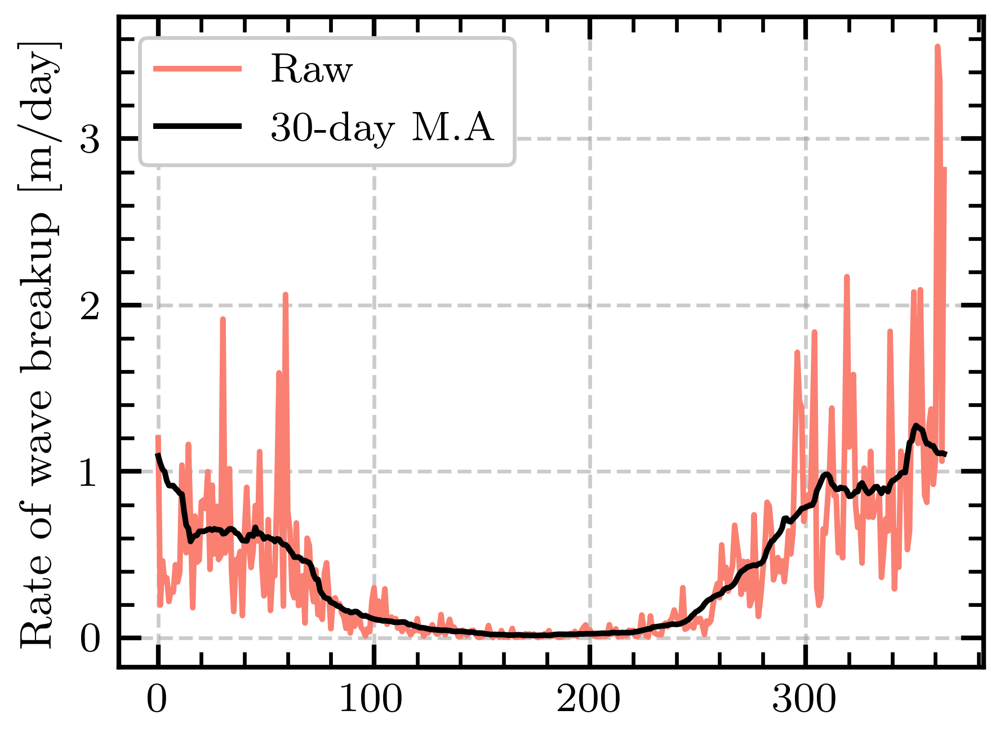

In [12]:
temp_vec = np.array(df_interior_grouped['meltl'].values)
temp_vec[0:10] = temp_vec[0:10]/2#temp_vec[-1:9]
#temp_vec[0] = temp_vec[1]
test = cyclic_moving_av(-dafsd_wave_MIZ, 30)



ax = sns.lineplot(-dafsd_wave_MIZ, #x=dates, y=dafsd_wave_MIZ,
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 100
              )
ax = sns.lineplot(test, #x=dates, y=dafsd_wave_MIZ,
             errorbar=None, legend=False, label = "MIZ", color = 'black', zorder = 100, 
              )
plt.legend(loc='upper left', labels=['Raw', '30-day M.A'])
ax.set(ylabel = 'Rate of wave breakup [m/day]')
savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'wavebreakup_1day.pdf')

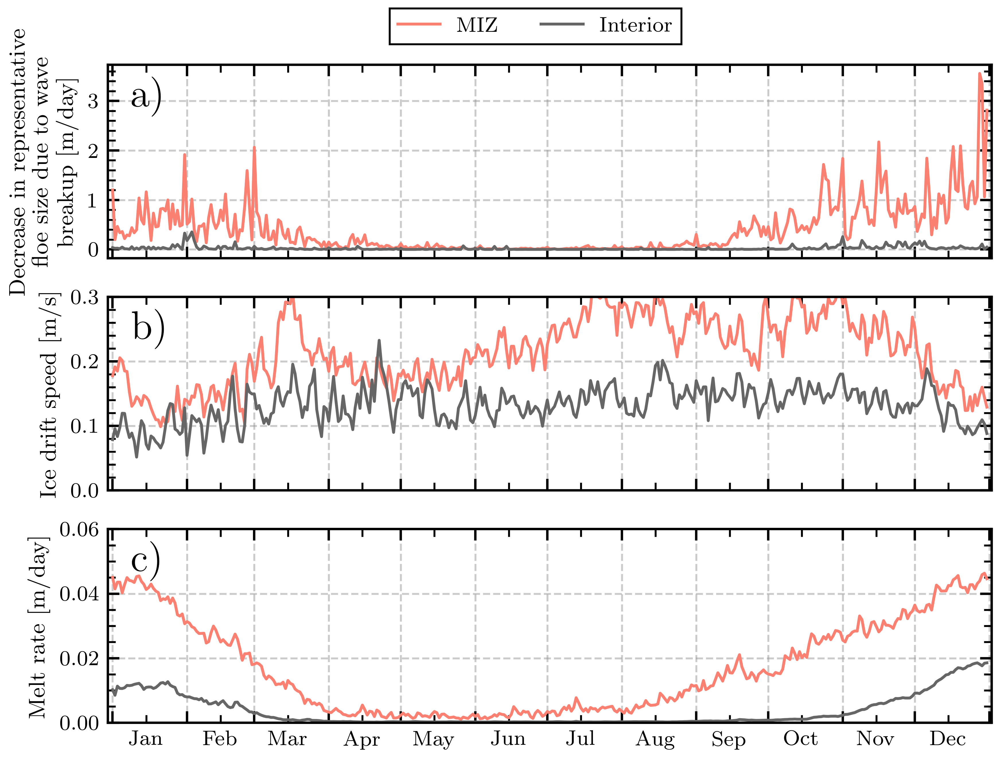

In [6]:
fig, axes = plt.subplots(3, 1, figsize=(width,height), sharex=True)
ax1 = axes[0]
ax2 = axes[1]
ax3 = axes[2]

ma_period = 1
dates = pd.date_range(start="2010-01-01",end="2010-12-31")

COLOR_GREY = [0.4, 0.4, 0.4, 1.0]
# Wave breakup ------------------------------------------------------
sns.lineplot(ax=ax1, x=dates, y=-cyclic_moving_av(np.array(df_MIZ_grouped['dafsd_wave'].values), n = ma_period),
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 1
              )
sns.lineplot(ax=ax1, x=dates, y=-cyclic_moving_av(np.array(df_interior_grouped['dafsd_wave'].values), n = ma_period),
             errorbar=None, legend=False, label = "Interior", color = COLOR_GREY
              )
ax1.set_ylabel('Decrease in representative\n floe size due to wave\n breakup [m/day]',)
#ax1.legend(['MIZ', 'not MIZ'],fancybox=False, edgecolor="black", loc='upper right')


# Ice speed ------------------------------------------------------
sns.lineplot(ax=ax2, x=dates, y=cyclic_moving_av(np.array(df_MIZ_grouped['vel'].values), n = ma_period),
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 1
              )
sns.lineplot(ax=ax2, x=dates, y=cyclic_moving_av(np.array(df_interior_grouped['vel'].values), n = ma_period),
             errorbar=None, legend=False, label = "interior", color = COLOR_GREY
              )
ax2.set_ylabel('Ice drift speed [m/s]',)
ax2.set_ylim((0, 0.3))


# Total melt ------------------------------------------------------
sns.lineplot(ax=ax3, x=dates, y=cyclic_moving_av(np.array(df_MIZ_grouped['meltt'].values) 
                                                          + np.array(df_MIZ_grouped['meltb'].values )
                                                          + np.array(df_MIZ_grouped['meltl'].values), n = ma_period)/100,
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 1
              )
sns.lineplot(ax=ax3, x=dates, y=cyclic_moving_av(np.array(df_interior_grouped['meltt'].values) 
                                                          + np.array(df_interior_grouped['meltb'].values )
                                                          + np.array(df_interior_grouped['meltl'].values), n = ma_period)/100,
             errorbar=None, legend=False, label = "interior", color = COLOR_GREY
              )
ax3.set_ylabel('Melt rate [m/day]',)
ax3.set_xlabel('')
ax3.set_ylim((0,0.06))
ax3.set_xlim((np.round(ax3.get_xlim()[0]+16),np.round(ax3.get_xlim()[-1]-16)))
set_ax_date(ax3, plot_type="clim")


trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
ax1.text(0.0, 1.0, 'a)', transform=ax1.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax2.text(0.0, 1.0, 'b)', transform=ax2.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax3.text(0.0, 1.0, 'c)', transform=ax3.transAxes + trans, zorder = 3,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))

# Create a legend
from matplotlib.lines import Line2D
import matplotlib.patches as mpatches

# access legend objects automatically created from data
handles, labels = ax1.get_legend_handles_labels()

# create manual symbols for legend
#patch = mpatches.Patch(color='grey', label='manual patch')   
#line = Line2D([0], [0], label='manual line', color='k')
#point = Line2D([0], [0], label='manual point', marker='s', markersize=10, 
#         markeredgecolor='r', markerfacecolor='k', linestyle='')
line1 = Line2D([0], [0], label='MIZ', color=COLOR_MIZ)
line2 = Line2D([0], [0], label='Interior', color=COLOR_GREY)
#line3 = Line2D([0], [0], label='Cluster 3', color=radar_cmap[2])
                                                             

# add manual symbols to auto legend
#handles.extend([line1, line2])
#trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)

plt.legend(handles=handles, ncol=2, fancybox=False, edgecolor="black", loc="center", 
 #          bbox_transform=ax1.transAxes + trans)
           bbox_to_anchor=(0.5, 0.925), bbox_transform=fig.transFigure)

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'MIZ_interior_dynamics_seasonal.pdf')

### FINAL: 3 x 2 plot

In [53]:
FuncFormatter(m_fmt)

Text(0.0, 1.0, 'f)')

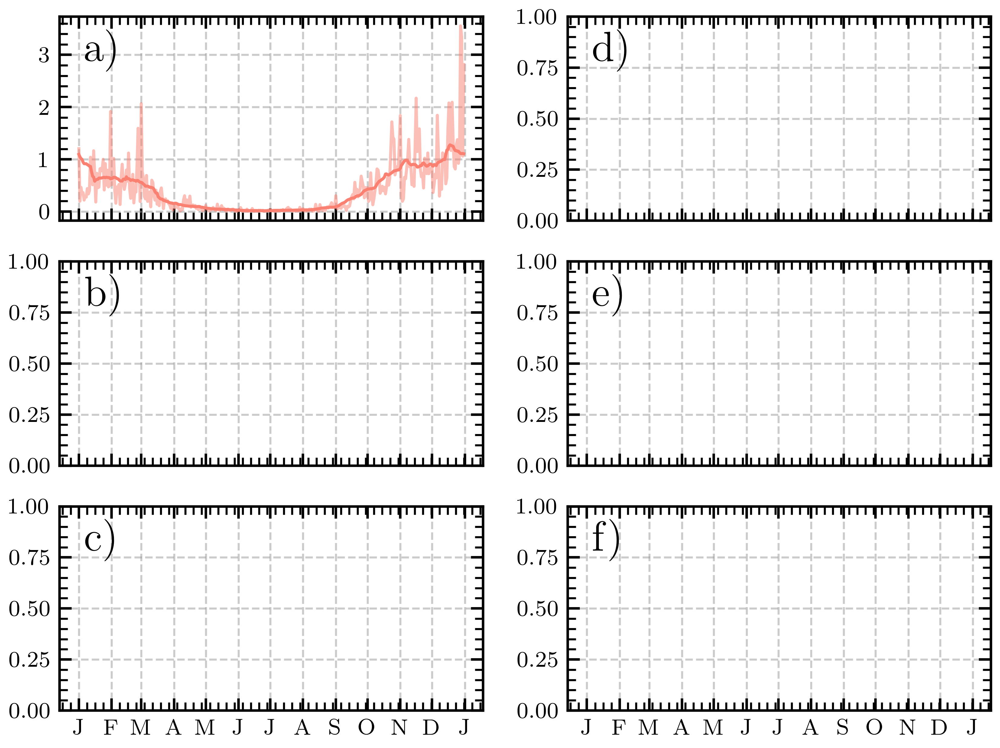

In [13]:
fig, axes = plt.subplots(3, 2, figsize=(width,height), sharex=True)
ax1 = axes[0,0]
ax2 = axes[1,0]
ax3 = axes[2,0]
ax4 = axes[0,1]
ax5 = axes[1,1]
ax6 = axes[2,1]
alpha = 0.5

sns.lineplot(ax=ax1, x=dates, y=-cyclic_moving_av(np.array(df_MIZ_grouped['dafsd_wave'].values), n = ma_period),
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 2
              )
sns.lineplot(ax=ax1, x=dates, y=-df_MIZ_grouped['dafsd_wave'].values,
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 1 , alpha=alpha
              )


#month_year_formatter = mdates.DateFormatter('%m') #mdates.DateFormatter('%b') 
#monthly_locator = mdates.MonthLocator()
#ax1.xaxis.set_major_locator(mdates.MonthLocator())
#ax1.xaxis.set_minor_locator(mdates.MonthLocator(bymonthday=15))
#ax1.xaxis.set_major_formatter(NullFormatter())
#ax1.xaxis.set_minor_formatter(mdates.DateFormatter('%m'))

from matplotlib.ticker import FuncFormatter
month_fmt = mdates.DateFormatter('%b')
def m_fmt(x, pos=None):
    return month_fmt(x)[0]
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.xaxis.set_major_locator(mdates.MonthLocator())
ax1.xaxis.set_major_formatter(FuncFormatter(m_fmt))

# monthly_locator = mdates.MonthLocator()
# ax1.xaxis.set_minor_locator(mdates.MonthLocator(bymonthday=1))
# ax1.xaxis.set_major_formatter(mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
# ax1.xaxis.set_minor_formatter(mdates.DateFormatter('%b'))
# ax1.set_xlabel('')

trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
ax1.text(0.0, 1.0, 'a)', transform=ax1.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax2.text(0.0, 1.0, 'b)', transform=ax2.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax3.text(0.0, 1.0, 'c)', transform=ax3.transAxes + trans, zorder = 3,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax4.text(0.0, 1.0, 'd)', transform=ax4.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax5.text(0.0, 1.0, 'e)', transform=ax5.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax6.text(0.0, 1.0, 'f)', transform=ax6.transAxes + trans, zorder = 3,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))

## 3x1 plot

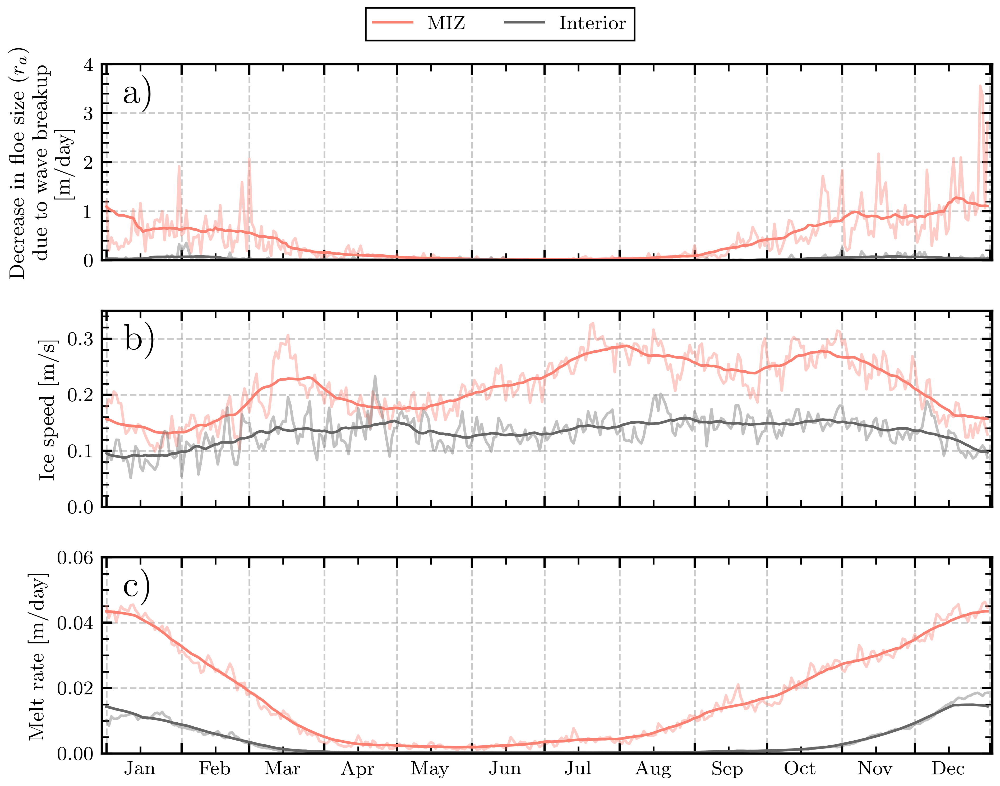

In [29]:
fig, axes = plt.subplots(3, 1, figsize=(width,height), sharex=True)
ax1 = axes[0]
ax2 = axes[1]
ax3 = axes[2]
ax4 = axes[0]
ax5 = axes[1]
ax6 = axes[2]

ma_period = 30
alpha = 0.4
dates = pd.date_range(start="2010-01-01",end="2010-12-31")

COLOR_GREY = [0.4, 0.4, 0.4, 1.0]
# Wave breakup ------------------------------------------------------
sns.lineplot(ax=ax1, x=dates, y=-cyclic_moving_av(np.array(df_MIZ_grouped['dafsd_wave'].values), n = ma_period),
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 2, linestyle = '-'
              )
sns.lineplot(ax=ax1, x=dates, y=-df_MIZ_grouped['dafsd_wave'].values,
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 1 , alpha=alpha
              )




sns.lineplot(ax=ax4, x=dates, y=-cyclic_moving_av(np.array(df_interior_grouped['dafsd_wave'].values), n = ma_period),
             errorbar=None, legend=False, label = "Interior", color = COLOR_GREY, zorder = 2
              )
sns.lineplot(ax=ax4, x=dates, y=-df_interior_grouped['dafsd_wave'].values,
             errorbar=None, legend=False, label = "Interior", color = COLOR_GREY, zorder = 1 , alpha=alpha
              )
ax1.set_ylabel('Decrease in floe size ($r_a$)\n due to wave breakup\n [m/day]',)
#ax1.legend(['MIZ', 'not MIZ'],fancybox=False, edgecolor="black", loc='upper right')
ax1.set_ylim((0, 4))
ax4.set_ylim((0, 4))

# Ice speed ------------------------------------------------------
sns.lineplot(ax=ax2, x=dates, y=cyclic_moving_av(np.array(df_MIZ_grouped['vel'].values), n = ma_period),
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 2
              )
sns.lineplot(ax=ax2, x=dates, y=df_MIZ_grouped['vel'].values,
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 1, alpha=alpha
              )



sns.lineplot(ax=ax5, x=dates, y=cyclic_moving_av(np.array(df_interior_grouped['vel'].values), n = ma_period),
             errorbar=None, legend=False, label = "interior", color = COLOR_GREY, zorder = 2
              )
sns.lineplot(ax=ax5, x=dates, y=df_interior_grouped['vel'].values,
             errorbar=None, legend=False, label = "interior", color = COLOR_GREY, alpha=alpha
              )
ax2.set_ylabel('Ice speed [m/s]',)
ax2.set_ylim((0, 0.35))
ax5.set_ylim((0, 0.35))


# Total melt ------------------------------------------------------
sns.lineplot(ax=ax3, x=dates, y=cyclic_moving_av(np.array(df_MIZ_grouped['meltt'].values) 
                                                          + np.array(df_MIZ_grouped['meltb'].values )
                                                          + np.array(df_MIZ_grouped['meltl'].values), n = ma_period)/100,
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 2, linestyle = '-'
              )
sns.lineplot(ax=ax3, x=dates, y=(np.array(df_MIZ_grouped['meltt'].values) 
                                                          + np.array(df_MIZ_grouped['meltb'].values )
                                                          + np.array(df_MIZ_grouped['meltl'].values))/100,
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 1, alpha=alpha
              )

sns.lineplot(ax=ax6, x=dates, y=cyclic_moving_av(np.array(df_interior_grouped['meltt'].values) 
                                                          + np.array(df_interior_grouped['meltb'].values )
                                                          + np.array(df_interior_grouped['meltl'].values), n = ma_period)/100,
             errorbar=None, legend=False, label = "interior", color = COLOR_GREY, zorder = 2
              )
sns.lineplot(ax=ax6, x=dates, y=(np.array(df_interior_grouped['meltt'].values) 
                                                          + np.array(df_interior_grouped['meltb'].values )
                                                          + np.array(df_interior_grouped['meltl'].values))/100,
             errorbar=None, legend=False, label = "interior", color = COLOR_GREY, alpha=alpha
              )

ax3.set_ylabel('Melt rate [m/day]',)
ax3.set_xlabel('')
ax3.set_ylim((0,0.06))
ax6.set_ylim((0,0.06))
ax3.set_xlim((np.round(ax3.get_xlim()[0]+16),np.round(ax3.get_xlim()[-1]-16)))
set_ax_date(ax3, plot_type="clim")

# from matplotlib.ticker import FuncFormatter
# month_fmt = mdates.DateFormatter('%b')
# def m_fmt(x, pos=None):
#     return month_fmt(x)[0]
# ax1.xaxis.set_major_formatter(NullFormatter())
# ax1.xaxis.set_major_locator(mdates.MonthLocator())
# ax1.xaxis.set_major_formatter(FuncFormatter(m_fmt))


#ax1.set_title('MIZ')
#ax4.set_title('Interior')

trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
ax1.text(0.0, 1.0, 'a)', transform=ax1.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax2.text(0.0, 1.0, 'b)', transform=ax2.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax3.text(0.0, 1.0, 'c)', transform=ax3.transAxes + trans, zorder = 3,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
# ax4.text(0.0, 1.0, 'd)', transform=ax4.transAxes + trans,
#                fontsize='large', verticalalignment='top', fontfamily='serif',
#                bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
# ax5.text(0.0, 1.0, 'e)', transform=ax5.transAxes + trans,
#                fontsize='large', verticalalignment='top', fontfamily='serif',
#                bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
# ax6.text(0.0, 1.0, 'f)', transform=ax6.transAxes + trans, zorder = 3,
#                fontsize='large', verticalalignment='top', fontfamily='serif',
#                bbox=dict(facecolor='none', edgecolor='none', pad=3.0))

# Create a legend
from matplotlib.lines import Line2D
import matplotlib.patches as mpatches

# access legend objects automatically created from data
handles, labels = ax1.get_legend_handles_labels()

# create manual symbols for legend
#patch = mpatches.Patch(color='grey', label='manual patch')   
#line = Line2D([0], [0], label='manual line', color='k')
#point = Line2D([0], [0], label='manual point', marker='s', markersize=10, 
#         markeredgecolor='r', markerfacecolor='k', linestyle='')
line1 = Line2D([0], [0], label='MIZ', color=COLOR_MIZ)
line2 = Line2D([0], [0], label='Interior', color=COLOR_GREY)
#line3 = Line2D([0], [0], label='Cluster 3', color=radar_cmap[2])
                                                             

#ax4.set_yticklabels([])
#ax5.set_yticklabels([])
#ax6.set_yticklabels([])
plt.tight_layout()
# add manual symbols to auto legend
#handles.extend([line1, line2])
#trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)

plt.legend(handles=[handles[0] ,handles[2]], ncol=2, fancybox=False, edgecolor="black", loc="center", 
##            bbox_transform=ax1.transAxes + trans)
             bbox_to_anchor=(0.5, 1.0), bbox_transform=fig.transFigure)
          #  bbox_to_anchor=(0.5, 0.925), bbox_transform=fig.transFigure)

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'MIZ_interior_dynamics_seasonal_3x1.pdf')
plt.savefig(savepath+'MIZ_interior_dynamics_seasonal_3x1.png')




In [25]:
[handles[0] ,handles[2]]
#0:3
#handles[0:2]

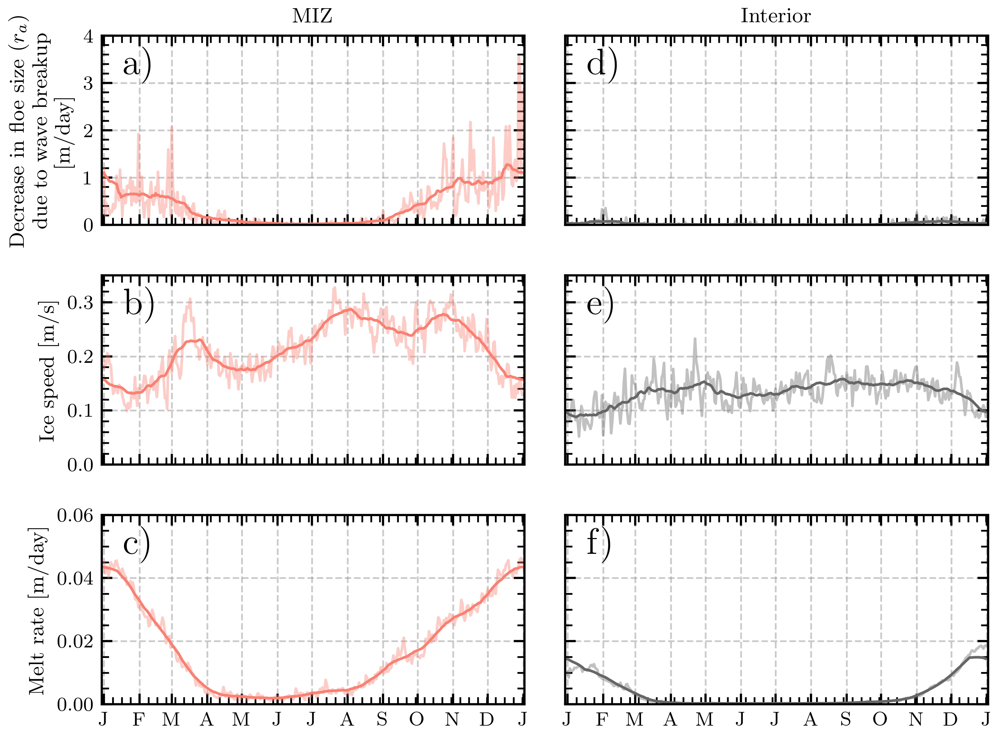

In [30]:
fig, axes = plt.subplots(3, 2, figsize=(width,height), sharex=True)
ax1 = axes[0,0]
ax2 = axes[1,0]
ax3 = axes[2,0]
ax4 = axes[0,1]
ax5 = axes[1,1]
ax6 = axes[2,1]

ma_period = 30
alpha = 0.4
dates = pd.date_range(start="2010-01-01",end="2010-12-31")

COLOR_GREY = [0.4, 0.4, 0.4, 1.0]
# Wave breakup ------------------------------------------------------
sns.lineplot(ax=ax1, x=dates, y=-cyclic_moving_av(np.array(df_MIZ_grouped['dafsd_wave'].values), n = ma_period),
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 2, linestyle = '-'
              )
sns.lineplot(ax=ax1, x=dates, y=-df_MIZ_grouped['dafsd_wave'].values,
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 1 , alpha=alpha
              )




sns.lineplot(ax=ax4, x=dates, y=-cyclic_moving_av(np.array(df_interior_grouped['dafsd_wave'].values), n = ma_period),
             errorbar=None, legend=False, label = "Interior", color = COLOR_GREY, zorder = 2
              )
sns.lineplot(ax=ax4, x=dates, y=-df_interior_grouped['dafsd_wave'].values,
             errorbar=None, legend=False, label = "Interior", color = COLOR_GREY, zorder = 1 , alpha=alpha
              )
ax1.set_ylabel('Decrease in floe size ($r_a$)\n due to wave breakup\n [m/day]',)
#ax1.legend(['MIZ', 'not MIZ'],fancybox=False, edgecolor="black", loc='upper right')
ax1.set_ylim((0, 4))
ax4.set_ylim((0, 4))

# Ice speed ------------------------------------------------------
sns.lineplot(ax=ax2, x=dates, y=cyclic_moving_av(np.array(df_MIZ_grouped['vel'].values), n = ma_period),
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 2
              )
sns.lineplot(ax=ax2, x=dates, y=df_MIZ_grouped['vel'].values,
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 1, alpha=alpha
              )



sns.lineplot(ax=ax5, x=dates, y=cyclic_moving_av(np.array(df_interior_grouped['vel'].values), n = ma_period),
             errorbar=None, legend=False, label = "interior", color = COLOR_GREY, zorder = 2
              )
sns.lineplot(ax=ax5, x=dates, y=df_interior_grouped['vel'].values,
             errorbar=None, legend=False, label = "interior", color = COLOR_GREY, alpha=alpha
              )
ax2.set_ylabel('Ice speed [m/s]',)
ax2.set_ylim((0, 0.35))
ax5.set_ylim((0, 0.35))


# Total melt ------------------------------------------------------
sns.lineplot(ax=ax3, x=dates, y=cyclic_moving_av(np.array(df_MIZ_grouped['meltt'].values) 
                                                          + np.array(df_MIZ_grouped['meltb'].values )
                                                          + np.array(df_MIZ_grouped['meltl'].values), n = ma_period)/100,
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 2, linestyle = '-'
              )
sns.lineplot(ax=ax3, x=dates, y=(np.array(df_MIZ_grouped['meltt'].values) 
                                                          + np.array(df_MIZ_grouped['meltb'].values )
                                                          + np.array(df_MIZ_grouped['meltl'].values))/100,
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 1, alpha=alpha
              )

sns.lineplot(ax=ax6, x=dates, y=cyclic_moving_av(np.array(df_interior_grouped['meltt'].values) 
                                                          + np.array(df_interior_grouped['meltb'].values )
                                                          + np.array(df_interior_grouped['meltl'].values), n = ma_period)/100,
             errorbar=None, legend=False, label = "interior", color = COLOR_GREY, zorder = 2
              )
sns.lineplot(ax=ax6, x=dates, y=(np.array(df_interior_grouped['meltt'].values) 
                                                          + np.array(df_interior_grouped['meltb'].values )
                                                          + np.array(df_interior_grouped['meltl'].values))/100,
             errorbar=None, legend=False, label = "interior", color = COLOR_GREY, alpha=alpha
              )

ax3.set_ylabel('Melt rate [m/day]',)
ax3.set_xlabel('')
ax3.set_ylim((0,0.06))
ax6.set_ylim((0,0.06))
ax3.set_xlim((np.round(ax3.get_xlim()[0]+16),np.round(ax3.get_xlim()[-1]-16)))
#set_ax_date(ax3, plot_type="clim")

from matplotlib.ticker import FuncFormatter
month_fmt = mdates.DateFormatter('%b')
def m_fmt(x, pos=None):
    return month_fmt(x)[0]
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.xaxis.set_major_locator(mdates.MonthLocator())
ax1.xaxis.set_major_formatter(FuncFormatter(m_fmt))


ax1.set_title('MIZ')
ax4.set_title('Interior')

trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
ax1.text(0.0, 1.0, 'a)', transform=ax1.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax2.text(0.0, 1.0, 'b)', transform=ax2.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax3.text(0.0, 1.0, 'c)', transform=ax3.transAxes + trans, zorder = 3,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax4.text(0.0, 1.0, 'd)', transform=ax4.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax5.text(0.0, 1.0, 'e)', transform=ax5.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax6.text(0.0, 1.0, 'f)', transform=ax6.transAxes + trans, zorder = 3,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))

# Create a legend
from matplotlib.lines import Line2D
import matplotlib.patches as mpatches

# access legend objects automatically created from data
handles, labels = ax1.get_legend_handles_labels()

# create manual symbols for legend
#patch = mpatches.Patch(color='grey', label='manual patch')   
#line = Line2D([0], [0], label='manual line', color='k')
#point = Line2D([0], [0], label='manual point', marker='s', markersize=10, 
#         markeredgecolor='r', markerfacecolor='k', linestyle='')
line1 = Line2D([0], [0], label='MIZ', color=COLOR_MIZ)
line2 = Line2D([0], [0], label='Interior', color=COLOR_GREY)
#line3 = Line2D([0], [0], label='Cluster 3', color=radar_cmap[2])
                                                             

ax4.set_yticklabels([])
ax5.set_yticklabels([])
ax6.set_yticklabels([])
plt.tight_layout()
# add manual symbols to auto legend
#handles.extend([line1, line2])
#trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)

# plt.legend(handles=handles, ncol=2, fancybox=False, edgecolor="black", loc="center", 
#  #          bbox_transform=ax1.transAxes + trans)
#            bbox_to_anchor=(0.5, 0.925), bbox_transform=fig.transFigure)

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'MIZ_interior_dynamics_seasonal.pdf')
plt.savefig(savepath+'MIZ_interior_dynamics_seasonal_3x2.png')



In [ ]:
fig, axes = plt.subplots(3, 1, figsize=(width,height), sharex=True)
ax1 = axes[0]
ax2 = axes[1]
ax3 = axes[2]



COLOR_GREY = [0.4, 0.4, 0.4, 1.0]
# Wave breakup ------------------------------------------------------
sns.lineplot(ax=ax1, x=df_MIZ["month-day"], y=-df_MIZ["dafsd_wave"],
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 100
              )
sns.lineplot(ax=ax1, x=df_interior["month-day"], y=-df_interior["dafsd_wave"],
             errorbar=None, legend=False, label = "interior", color = COLOR_GREY
              )
ax1.set_ylabel('Decrease in representative\n floe size due to wave\n breakup [m/day]',)
ax1.legend(['MIZ', 'not MIZ'],fancybox=False, edgecolor="black", loc='upper right')


# Ice speed ------------------------------------------------------
sns.lineplot(ax=ax2, x=df_MIZ["month-day"], y=df_MIZ["vel"],
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 100
              )
sns.lineplot(ax=ax2, x=df_interior["month-day"], y=df_interior["vel"],
             errorbar=None, legend=False, label = "interior", color = COLOR_GREY
              )
ax2.set_ylabel('Ice drift speed [m/s]',)
ax2.set_ylim((0, 0.3))


# Total melt ------------------------------------------------------
sns.lineplot(ax=ax3, x=df_MIZ["month-day"], y=df_MIZ["meltb"]+df_MIZ["meltl"]+df_MIZ["meltt"],
             errorbar=None, legend=False, label = "MIZ", color = COLOR_MIZ, zorder = 100
              )
sns.lineplot(ax=ax3, x=df_interior["month-day"], y=df_interior["meltb"]+df_interior["meltl"]+df_interior["meltt"],
             errorbar=None, legend=False, label = "interior", color = COLOR_GREY
              )
ax3.set_ylabel('Melt rate [cm/day]',)
ax3.set_xlabel('')
ax3.set_ylim((0,10))
ax3.set_xlim((np.round(ax3.get_xlim()[0]+16),np.round(ax3.get_xlim()[-1]-16)))
set_ax_date(ax3, plot_type="clim")


trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
ax1.text(0.0, 1.0, 'a)', transform=ax1.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax2.text(0.0, 1.0, 'b)', transform=ax2.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax3.text(0.0, 1.0, 'c)', transform=ax3.transAxes + trans,
               fontsize='large', verticalalignment='top', fontfamily='serif',
               bbox=dict(facecolor='none', edgecolor='none', pad=3.0))




plt.savefig(savepath+'MIZ_interior_dynamics_seasonal.pdf')

In [41]:
print(df_interior[(df_interior['month-day'] == df_interior['month-day'].values[-1])]['meltl'].mean())
print(df_interior[(df_interior['month-day'] == df_interior['month-day'].values[0])]['meltl'].mean())

0.12591200578210757
6.671471788930771


<AxesSubplot:>

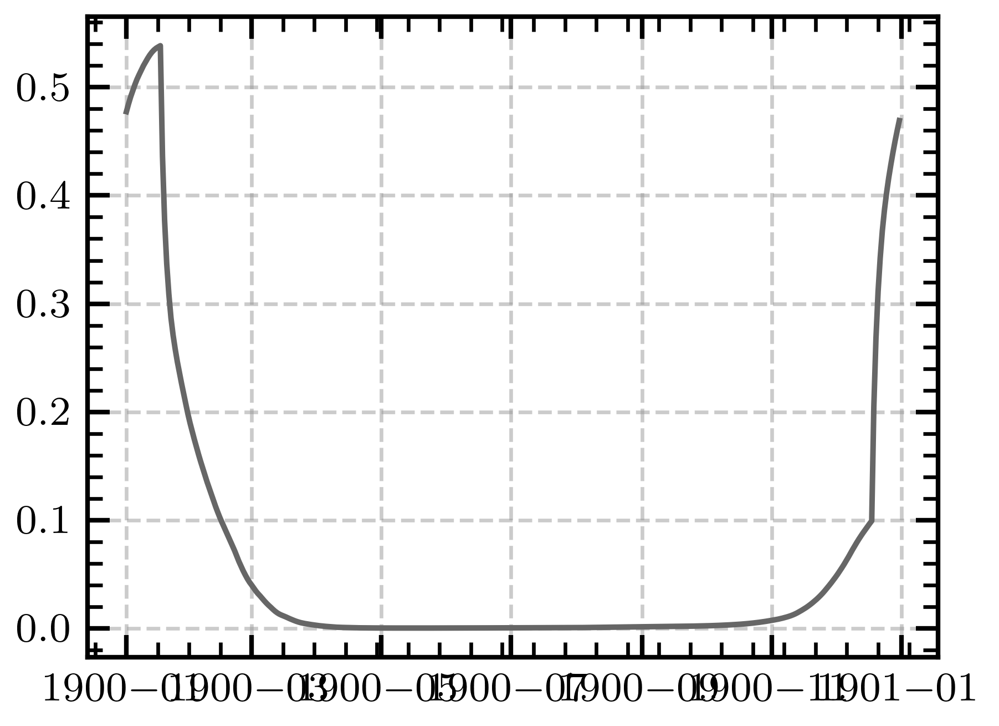

In [71]:
df_tmp = df_interior.groupby(by=["month-day"], dropna=False)['meltl'].mean()#.plot()

#sns.lineplot(y=df_tmp['melt'],
#             errorbar=None, legend=False, label = "interior", color = COLOR_GREY
#              )

ma_period = 30
plot_data = cyclic_moving_av(np.array(df_tmp), n = ma_period)
plot_data
dates_tmp = pd.date_range(start="1900-01-01",end="1900-12-31", freq='d')
sns.lineplot(x=dates_tmp, y=plot_data,
             errorbar=None, legend=False, label = "interior", color = COLOR_GREY
              )

In [62]:
df_tmp.iloc[:,0]

month-day
1900-01-01    1.699754e+03
1900-01-02    5.680389e+03
1900-01-03    9.396550e+03
1900-01-04    1.289774e+04
1900-01-05    1.619183e+04
                  ...     
1900-12-27    2.137086e+06
1900-12-28    2.141401e+06
1900-12-29    2.145773e+06
1900-12-30    2.150229e+06
1900-12-31    2.154407e+06
Name: Unnamed: 0.1, Length: 365, dtype: float64

      Unnamed: 0.1  Unnamed: 0  dafsd_latm  dafsd_latg  dafsd_weld  \
1274          1274        6350   -0.031064         0.0         0.0   
1276          1276        6352   -0.016252         0.0         0.0   
1277          1277        6353   -0.019022         0.0         0.0   
1390          1390        6689   -0.097015         0.0         0.0   
1391          1391        6690   -0.026567         0.0         0.0   

      dafsd_newi  dafsd_wave   pancake  longitude   latitude       date  k  \
1274         0.0         0.0  0.840654      224.5 -72.791801 2010-01-01  0   
1276         0.0         0.0  0.696439      226.5 -72.791801 2010-01-01  0   
1277         0.0         0.0  0.489228      227.5 -72.791801 2010-01-01  0   
1390         0.0         0.0  0.810228      223.5 -72.437401 2010-01-01  0   
1391         0.0         0.0  0.561058      224.5 -72.437401 2010-01-01  0   

           vel     meltl         meltt      meltb  month-day       year  
1274  0.096118  2.984414  1.025924e-

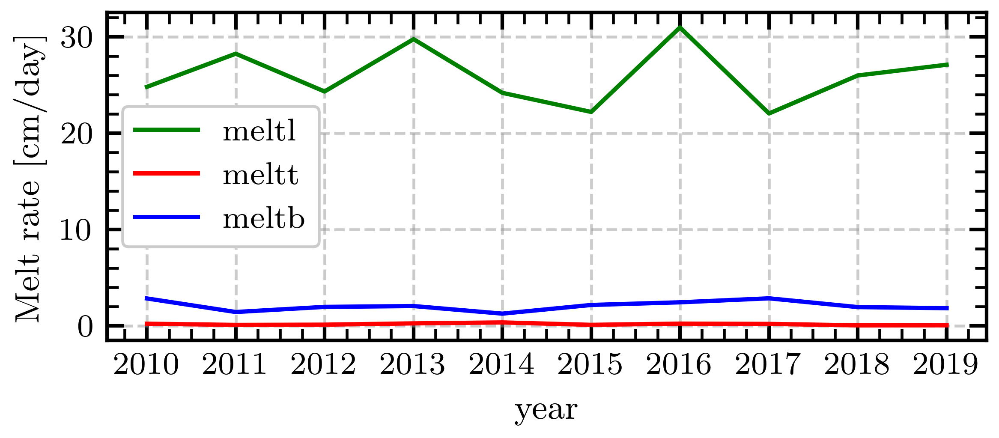

In [51]:
df = df_MIZ.copy()
index = df[(df['month-day'] != df['month-day'].values[0])].index
df.drop(index , inplace=True)
df.head(5)
fig, ax = plt.subplots(1, 1, figsize=(width/1.5,height/3), sharex=True)
sns.lineplot(ax=ax, x=df["year"], y=df["meltl"],
             errorbar=None, legend=True, label = "meltl", color = 'green',# zorder = 100
              )
sns.lineplot(ax=ax, x=df["year"], y=df["meltt"],
             errorbar=None, legend=True, label = "meltt", color = 'red'#, zorder = 100
              )
sns.lineplot(ax=ax, x=df["year"], y=df["meltb"],
             errorbar=None, legend=True, label = "meltb", color = 'blue'#, zorder = 100
              )
ax.set_ylabel('Melt rate [cm/day]')
print(df.head(5))
savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'melt_rates_jan1.png', dpi = 1000, bbox_inches="tight")

      Unnamed: 0.1  Unnamed: 0  dafsd_latm  dafsd_latg  dafsd_weld  \
1274          1274        6350   -0.031064         0.0         0.0   
1276          1276        6352   -0.016252         0.0         0.0   
1277          1277        6353   -0.019022         0.0         0.0   
1390          1390        6689   -0.097015         0.0         0.0   
1391          1391        6690   -0.026567         0.0         0.0   

      dafsd_newi  dafsd_wave   pancake  longitude   latitude       date  k  \
1274         0.0         0.0  0.840654      224.5 -72.791801 2010-01-01  0   
1276         0.0         0.0  0.696439      226.5 -72.791801 2010-01-01  0   
1277         0.0         0.0  0.489228      227.5 -72.791801 2010-01-01  0   
1390         0.0         0.0  0.810228      223.5 -72.437401 2010-01-01  0   
1391         0.0         0.0  0.561058      224.5 -72.437401 2010-01-01  0   

           vel     meltl         meltt      meltb  month-day       year  
1274  0.096118  2.984414  1.025924e-

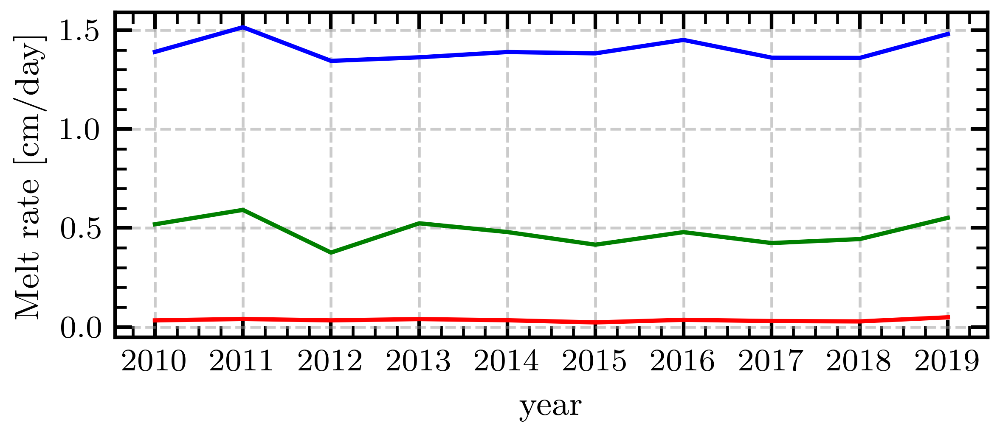

In [50]:
df = df_MIZ.copy()
index = df[(df['month-day'] == df['month-day'].values[-1])].index
df.drop(index , inplace=True)
df.head(5)
fig, ax = plt.subplots(1, 1, figsize=(width/1.5,height/3), sharex=True)
sns.lineplot(ax=ax, x=df["year"], y=df["meltl"],
             errorbar=None, legend=False, label = "meltl", color = 'green',# zorder = 100
              )
sns.lineplot(ax=ax, x=df["year"], y=df["meltt"],
             errorbar=None, legend=False, label = "meltt", color = 'red'#, zorder = 100
              )
sns.lineplot(ax=ax, x=df["year"], y=df["meltb"],
             errorbar=None, legend=False, label = "meltb", color = 'blue'#, zorder = 100
              )
print(df.head(5))
ax.set_ylabel('Melt rate [cm/day]')
savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'melt_rates_dec31.png', dpi = 1000, bbox_inches="tight")

In [32]:
df['month-day'].values[0]

numpy.datetime64('1900-01-01T00:00:00.000000000')

In [19]:
dates_tmp = pd.date_range(start="2018-01-01",end="2018-12-31", freq='d')
dates_tmp

DatetimeIndex(['2018-01-01', '2018-01-02', '2018-01-03', '2018-01-04',
               '2018-01-05', '2018-01-06', '2018-01-07', '2018-01-08',
               '2018-01-09', '2018-01-10',
               ...
               '2018-12-22', '2018-12-23', '2018-12-24', '2018-12-25',
               '2018-12-26', '2018-12-27', '2018-12-28', '2018-12-29',
               '2018-12-30', '2018-12-31'],
              dtype='datetime64[ns]', length=365, freq='D')

# Figure 8: Dynamics of the MIZ (old)

In [36]:
df_timeseries_MIZ.shape
pd.date_range(start=str(year_range[0])+"-01-01",end=str(year_range[0])+"-12-31").shape

(365,)

In [3]:
year_range = range(2010,2011) #[2010, 2011] #range(2010,2020)
df = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/forcing_analysis_'+str(year)+'.csv') 
                for year in tqdm(year_range, total = len(year_range), desc = "Reading in forcing analysis data")),
                ignore_index=True)
df_kmean = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/kmeans_'+str(year)+'.csv') 
                for year in tqdm(year_range, total = len(year_range), desc = "Reading in forcing analysis data")),
                ignore_index=True)
df_dyn = pd.DataFrame({'k': df_kmean["k"].values,
                             "date": df["date"].values,
                             #"uvel": df["uvel"].values,
                             #"vvel": df["vvel"].values,
                             #"uatm": df["uatm"].values,
                             #"vatm": df["vatm"].values,
                             "atm": np.sqrt(np.square(df["uatm"])+np.square(df["vatm"])),
                             "vel": np.sqrt(np.square(df["uvel"])+np.square(df["vvel"])),
                             #"shear": df["shear"].values,
                             #"divu": df["divu"].values,
                             #"strength": df["strength"].values,
                             #"strint": np.sqrt(np.square(df["strintx"])+np.square(df["strinty"])),
                             #"strair": np.sqrt(np.square(df["strairx"])+np.square(df["strairy"])),
                            })

df_dyn['date'] = pd.to_datetime(df_dyn['date'], format="%Y-%m-%d")
df_timeseries = df_dyn.groupby(['date', 'k']).rolling(7).mean(numeric_only=True)

df_dyn['date'] = pd.to_datetime(df_dyn['date'], format="%Y-%m-%d")
idx = (df_dyn['k'].values == 2)
df_temp = df_dyn

temp_vec = df_temp['k'].values
temp_vec[idx] = 1
df_temp['k'] = temp_vec


idx = (df_temp['k'].values == 0)
df_MIZ = df_temp.iloc[idx,:]
#print(df_MIZ)

idx = (df_temp['k'].values == 1)
df_interior = df_temp.iloc[idx,:]


#df_MIZ['date']  = pd.to_datetime(df_MIZ['date'], format="%Y-%m-%d")
#df_interior['date']  = pd.to_datetime(df_interior['date'], format="%Y-%m-%d")
df_timeseries_MIZ = df_MIZ.groupby(['date']).mean()
df_timeseries = df_interior.groupby(['date']).mean()
df_timeseries_MIZ = df_timeseries_MIZ.rolling(7).mean()
df_timeseries = df_timeseries.rolling(7).mean()
df_timeseries

df_ts = pd.DataFrame({'date': pd.date_range(start=str(year_range[0])+"-01-01",end=str(year_range[0])+"-12-31"),
                      'atm_miz': df_timeseries_MIZ["atm"].values,
                      'atm_interior': df_timeseries["atm"].values,
                      'vel_miz': df_timeseries_MIZ["vel"].values,
                      'vel_interior': df_timeseries["vel"].values,
                      #'strair_miz': df_timeseries_MIZ["strair"].values,
                      #'strair_interior': df_timeseries["strair"].values,
                      #'strint_miz': df_timeseries_MIZ["strint"].values,
                      #'strint_interior': df_timeseries["strint"].values,
                      #'vel_frac_miz': df_timeseries_MIZ["vel_frac"].values,
                      #'vel_frac_interior': df_timeseries["vel_frac"].values,
                           }
                          )
s = pd.date_range(start=str(year_range[0])+"-01-01",end=str(year_range[0])+"-12-31")
df_ts['month_day'] = s.strftime('%m-%d')

#df_timeseries['date'] = pd.to_datetime(df_interior['date'].unique(), format="%Y-%m-%d")

Reading in forcing analysis data:   0%|          | 0/1 [00:00<?, ?it/s]
KeyboardInterrupt



In [12]:
#year_range = range(2010,2020)
for year_idx,year in tqdm(enumerate(year_range), total=len(year_range), desc='Formatting timeseries dynamics'):

    df = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/forcing_analysis_'+str(year)+'.csv') 
                
    df_kmean = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/kmeans_'+str(year)+'.csv') 
                    
    df_dyn = pd.DataFrame({'k': df_kmean["k"].values,
                                 "date": df["date"].values,
                                 "uvel": df["uvel"].values,
                                 "vvel": df["vvel"].values,
                                 "uatm": df["uatm"].values,
                                 "vatm": df["vatm"].values,
                                 "atm": np.sqrt(np.square(df["uatm"])+np.square(df["vatm"])),
                                 "vel": np.sqrt(np.square(df["uvel"])+np.square(df["vvel"])),
                                 "shear": df["shear"].values,
                                 "divu": df["divu"].values,
                                 "strength": df["strength"].values,
                                 "strint": np.sqrt(np.square(df["strintx"])+np.square(df["strinty"])),
                                 "strair": np.sqrt(np.square(df["strairx"])+np.square(df["strairy"])),
                                })

    df_dyn['date'] = pd.to_datetime(df_dyn['date'], format="%Y-%m-%d")
    df_timeseries = df_dyn.groupby(['date', 'k'])#.rolling(7).mean(numeric_only=True)

    df_dyn['date'] = pd.to_datetime(df_dyn['date'], format="%Y-%m-%d")
    idx = (df_dyn['k'].values == 2)
    df_temp = df_dyn

    temp_vec = df_temp['k'].values
    temp_vec[idx] = 1
    df_temp['k'] = temp_vec


    idx = (df_temp['k'].values == 0)
    df_MIZ = df_temp.iloc[idx,:]
    #print(df_MIZ)

    idx = (df_temp['k'].values == 1)
    df_interior = df_temp.iloc[idx,:]


    #df_MIZ['date']  = pd.to_datetime(df_MIZ['date'], format="%Y-%m-%d")
    #df_interior['date']  = pd.to_datetime(df_interior['date'], format="%Y-%m-%d")
    df_timeseries_MIZ = df_MIZ.groupby(['date']).mean()
    df_timeseries = df_interior.groupby(['date']).mean()
    df_timeseries_MIZ = df_timeseries_MIZ#.rolling(7).mean()
    df_timeseries = df_timeseries#.rolling(7).mean()
   

    df_ts = pd.DataFrame({'date': pd.date_range(start=str(year_range[year_idx])+"-01-01",end=str(year_range[year_idx])+"-12-31"),
                          'atm_miz': df_timeseries_MIZ["atm"].values,
                          'atm_interior': df_timeseries["atm"].values,
                          'vel_miz': df_timeseries_MIZ["vel"].values,
                          'vel_interior': df_timeseries["vel"].values,
                          'strair_miz': df_timeseries_MIZ["strair"].values,
                          'strair_interior': df_timeseries["strair"].values,
                          'strint_miz': df_timeseries_MIZ["strint"].values,
                          'strint_interior': df_timeseries["strint"].values,
                          #'vel_frac_miz': df_timeseries_MIZ["vel_frac"].values,
                          #'vel_frac_interior': df_timeseries["vel_frac"].values,
                               }
                              )
    s = pd.date_range(start=str(year_range[year_idx])+"-01-01",end=str(year_range[year_idx])+"-12-31")
    df_ts['month_day'] = s.strftime('%m-%d')

    savepath = '/g/data/ia40/sea-ice-classification/dataframes/'
    savefilename = 'ts_dynamics_'+str(year)+'.csv'
    df_ts.to_csv(savepath+savefilename)

Formatting timeseries dynamics: 100%|██████████| 1/1 [00:32<00:00, 32.27s/it]


In [13]:
# Read in data
#year_range = range(2010,2020)
df_ts = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/ts_dynamics_'+str(year)+'.csv') 
                for year in tqdm(year_range, total = len(year_range), desc = "Reading in time series data")),
                ignore_index=True)

Reading in time series data: 100%|██████████| 1/1 [00:00<00:00, 35.46it/s]


In [14]:
# Time series plot

#ax2 = fig.add_subplot(2, 4, 2, projection=ccrs.SouthPolarStereo(), sharex=ax1, sharey=ax1)
#ax3 = fig.add_subplot(2, 4, 3, projection=ccrs.SouthPolarStereo(), sharex=ax1, sharey=ax1)
#ax4 = fig.add_subplot(2, 4, 4, projection=ccrs.SouthPolarStereo(), sharex=ax1, sharey=ax1)
#ax5 = fig.add_subplot(2, 1, 2)

#fig, axes = plt.subplot_mosaic([['a)'], ['a)'], ['b)'], ['c)']], layout='constrained', figsize=(width,height), sharex=True) 

for label, ax in axes.items():
    ax.set_xlabel("")
    add_subplot_label(fig, label)
    
    
    if label == 'a)':
        sns.lineplot(ax=ax, x="date", y="vel_interior",
             data=df_ts, errorbar=None, legend=False,
             color=COLOR_INTERIOR
            )
            
        sns.lineplot(ax=ax, x="date", y="vel_miz", 
                     data=df_ts, errorbar=None, legend=False,
                     color=COLOR_MIZ
                    )
        

        ax.set_ylabel('Ice drift speed [m/s]')
        

        set_ax_date(ax)
        
        ax.set_ylim((0,0.3))
        ax.set_yticks([0, 0.1, 0.2, 0.3])
        ax.set_facecolor((1.0, 1.0, 1.0))
        ax.legend(['Interior', 'MIZ'],fancybox=False, edgecolor="black", loc='upper right')
        
        ax2 = ax.twinx()
        sns.lineplot(ax=ax2, x="date", y="atm_interior",
             data=df_ts, errorbar=None, legend=False,
             color=COLOR_INTERIOR
            )
            
        sns.lineplot(ax=ax2, x="date", y="atm_miz", 
                     data=df_ts, errorbar=None, legend=False,
                     color=COLOR_MIZ
                    )
        ax2.lines[0].set_linestyle("--")
        ax2.lines[1].set_linestyle("--")
        ax2.set_ylabel('Wind speed [m/s]\n(dashed)')#, color=COLOR_ATM)
#        ax2.tick_params(axis="y", labelcolor=COLOR_ATM)
        ax2.grid(False)
        ax2.set_ylim((0,12))
        ax2.set_yticks([0, 4, 8, 12])

    
    elif label == 'b)':      
        sns.lineplot(ax=ax, x="date", y="strair_interior",
                     data=df_ts, errorbar=None, legend=False, 
                     color=COLOR_INTERIOR)
        sns.lineplot(ax=ax, x="date", y="strair_miz", 
                     data=df_ts, errorbar=None, legend=False, 
                     color=COLOR_MIZ)
        ax.set_ylabel('Wind stress\n[N/m$^2$]')
                                
    elif label == 'c)':
        sns.lineplot(ax=ax, x="date", y="strint_interior",
                     data=df_ts, errorbar=None, legend=False,
                     color=COLOR_INTERIOR)
        sns.lineplot(ax=ax, x="date", y="strint_miz", 
                     data=df_ts, errorbar=None, legend=False,
                     color=COLOR_MIZ)
        ax.set_ylabel('Internal stress\n[N/m$^2$]')
        
    set_ax_date(ax, plot_type="clim")
#    ax.set_xlim((np.round(ax.get_xlim()[0]+16),np.round(ax.get_xlim()[-1]-16)))
ax.set_xlabel('')
savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'MIZ_ice_drift_ts_MIZ_interior_paper.png', dpi = 1000, bbox_inches="tight")
plt.savefig(savepath+'MIZ_ice_drift_ts_MIZ_interior_paper.pdf')

AttributeError: 'numpy.ndarray' object has no attribute 'items'

In [ ]:
fig = plt.figure(figsize=[width, height])

ax3 = fig.add_subplot(4, 1, 4)
ax1 = fig.add_subplot(2, 1, 1)#, sharex=ax3)
ax2 = fig.add_subplot(4, 1, 3)#, sharex=ax3)

sns.lineplot(ax=ax1, x="month_day", y="vel_interior",
         data=df_ts, errorbar=None, legend=False,
         color=COLOR_INTERIOR
        )
sns.lineplot(ax=ax1, x="month_day", y="vel_miz", 
             data=df_ts, errorbar=None, legend=False,
             color=COLOR_MIZ
            )

ax1.set_ylabel('Ice drift speed [m/s]')
#set_ax_date(ax1)
ax1.set_ylim((0,0.3))
ax1.set_yticks([0, 0.1, 0.2, 0.3])
ax1.set_facecolor((1.0, 1.0, 1.0))
ax1.legend(['Interior', 'MIZ'],fancybox=False, edgecolor="black", loc='upper right')

ax1twin = ax1.twinx()
sns.lineplot(ax=ax1twin, x="month_day", y="atm_interior",
     data=df_ts, errorbar=None, legend=False,
     color=COLOR_INTERIOR
    )

sns.lineplot(ax=ax1twin, x="month_day", y="atm_miz", 
             data=df_ts, errorbar=None, legend=False,
             color=COLOR_MIZ
            )
ax1twin.lines[0].set_linestyle("--")
ax1twin.lines[1].set_linestyle("--")
ax1twin.set_ylabel('Wind speed [m/s] (dashed)')#, color=COLOR_ATM)
#        ax2.tick_params(axis="y", labelcolor=COLOR_ATM)
ax1twin.grid(False)
ax1twin.set_ylim((0,12))
ax1twin.set_yticks([0, 4, 8, 12])


sns.lineplot(ax=ax2, x="month_day", y="strair_interior",
                 data=df_ts, errorbar=None, legend=False, 
                 color=COLOR_INTERIOR)
sns.lineplot(ax=ax2, x="month_day", y="strair_miz", 
             data=df_ts, errorbar=None, legend=False, 
             color=COLOR_MIZ)
ax2.set_ylabel('Wind stress [N/m$^2$]')
#plt.xticks([])


sns.lineplot(ax=ax3, x="month_day", y="strint_interior",
             data=df_ts, errorbar=None, legend=False,
             color=COLOR_INTERIOR)
sns.lineplot(ax=ax3, x="month_day", y="strint_miz", 
             data=df_ts, errorbar=None, legend=False,
             color=COLOR_MIZ)
ax3.set_ylabel('Internal stress [N/m$^2$]')
ax3.set_xlabel("")

set_ax_date(ax3, plot_type="clim")

month_year_formatter = mdates.DateFormatter('%b') 
monthly_locator = mdates.MonthLocator()
ax1.xaxis.set_major_locator(mdates.MonthLocator())
ax1.xaxis.set_minor_locator(mdates.MonthLocator(bymonthday=15))
ax1.xaxis.set_ticklabels([])
ax1.set_xlabel("")

ax2.xaxis.set_major_locator(mdates.MonthLocator())
ax2.xaxis.set_minor_locator(mdates.MonthLocator(bymonthday=15))
ax2.xaxis.set_ticklabels([])
ax2.set_xlabel("")
ax2.set_ylim((0, 0.3))
ax3.set_ylim((0, 0.03))

ax1.set_xlim((np.round(ax1.get_xlim()[0]+16),np.round(ax1.get_xlim()[-1]-16)))
ax2.set_xlim((np.round(ax2.get_xlim()[0]+16),np.round(ax2.get_xlim()[-1]-16)))
ax3.set_xlim((np.round(ax3.get_xlim()[0]+16),np.round(ax3.get_xlim()[-1]-16)))

fig.subplots_adjust(bottom=0.0, top=1.0,
               left=0.04, right=0.95, wspace=0.03, hspace=0.1)

trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)
ax1.text(0.0, 1.0, 'a)', transform=ax1.transAxes + trans,
       fontsize='large', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax2.text(0.0, 1.0, 'b)', transform=ax2.transAxes + trans,
       fontsize='large', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
ax3.text(0.0, 1.0, 'c)', transform=ax3.transAxes + trans,
       fontsize='large', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'MIZ_ice_drift_ts_MIZ_interior_paper.png', dpi = 1000, bbox_inches="tight")
plt.savefig(savepath+'MIZ_ice_drift_ts_MIZ_interior_paper.pdf')
plt.show()

Error in callback <function flush_figures at 0x14a77ee555e0> (for post_execute):

In [15]:
df_fsd = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/analysis_fsd_raw_'+str(year)+'.csv')
df_kmeans = pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/kmeans_'+str(year)+'.csv')
df_fsd['k'] = df_kmeans['k']
unique_dates = df_fsd['date'].unique()
df.groupby('k').describe()


fig, axes = plt.subplot_mosaic([['a)'], ['b)']], layout='constrained', sharex=False, figsize=(7,7))

#import scienceplots
#plt.style.use(['science', 'pgf'])


# Get the FSD processes into a plotting dataframe
df_grouped = df_fsd[["dafsd_wave", "dafsd_weld", "dafsd_newi", "dafsd_latm", "dafsd_latg", "k"]].groupby('k').mean(numeric_only=True)
df_grouped["dafsd_latm"] = df_grouped["dafsd_latm"]*100#.values*(10^5)
df_grouped["dafsd_latg"] = df_grouped["dafsd_latg"]*10000
# , "dafsd_latm", "dafsd_latg"
xtick_labels_fsd = ['Wave breakup', 'Welding', 'New floe\nformation', 'Lateral melt\n($10^{-2}$)', 'Lateral\ngrowth ($10^{-3}$)']
df_plot_fsd = pd.DataFrame({'1': df_grouped.iloc[0,:].values,
                        '2': df_grouped.iloc[1,:].values,
                        '3': df_grouped.iloc[2,:].values},
                        index=xtick_labels_fsd)


# Get the melting processes into a plotting dataframe
df_melt = pd.DataFrame({'k': df["k"].values,
                             "date": df["date"].values,
                             "meltt": df["meltt"].values,
                             "meltl": df["meltl"].values,
                             "meltb": df["meltb"].values,
                            })
df_grouped = df_melt[["meltb", "meltl", "meltt", "k"]].groupby('k').mean(numeric_only=True)
df_plot_melt = pd.DataFrame({'1': df_grouped.iloc[0,:].values,
                        '2': df_grouped.iloc[1,:].values,
                        '3': df_grouped.iloc[2,:].values},
                        index=['Basal melt', 'Lateral melt', 'Top melt'])

    
for label, ax in axes.items():
    if label == 'a)':
        # create stacked bar chart for monthly temperatures
        df_plot_fsd.plot(ax = ax, kind='bar', stacked=True, 
                     color=[(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)],
                     legend=None)
        ax.set_ylabel('Change in mean\nfloe size [m/day]')
        ax.set_xticklabels(labels=xtick_labels_fsd, rotation=0)
        ax.axhline(y = 0.0, color = 'gray', linestyle = '-')

        
    elif label == 'b)':
        df_plot_melt.plot(ax = ax, kind='bar', stacked=True, 
                     color=[(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)],
                     linewidth=2)
        ax.set_ylim((0,2.25))
        plt.legend(['Cluster 1','Cluster 2','Cluster 3'], fancybox=False, edgecolor="black")
        plt.xticks(rotation = 0)
        plt.ylabel('Melt rate [cm/day]')
   # ax.set_facecolor([0.2, 0.2, 0.2])
    
    add_subplot_label(fig, label)
#    ax.patch.set_facecolor('white')

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'test.png', dpi = 1000, bbox_inches="tight", transparent=True)
plt.savefig(savepath+'test.pdf') #, transparent=True)

ERROR! Session/line number was not unique in database. History logging moved to new session 913


KeyError: 'k'

# Movie

In [5]:
from matplotlib.animation import FuncAnimation
from IPython import display
import matplotlib.animation as animation

#Figure = plt.figure(()
Figure = plt.figure(figsize=[width/4, height/4])

# creating a plot
lines_plotted = plt.plot([])	

# putting limits on x axis since
# it is a trigonometry function
# (0,2pi)
line_plotted = lines_plotted[0]

plt.xlim(0,2*np.pi)

# putting limits on y since it is a
# cosine function
plt.ylim(-1.1,1.1)

# initialising x from 0 to 2∏
x = np.linspace(0,2*np.pi,100)

#initially
y = 0


# function takes frame as an input
def AnimationFunction(frame):

	# setting y according to frame
	# number and + x. It's logic
	y = np.cos(x+2*np.pi*frame/100)

	# line is set with new values of x and y
	line_plotted.set_data((x, y))
    
anim_created = FuncAnimation(Figure, AnimationFunction, frames=100, interval=25)

video = anim_created.to_html5_video()
html = display.HTML(video)
display.display(html)

# good practice to close the plt object.
plt.close()


In [4]:
# Initialise arrays
n_days = 365
year_range = range(2019,2020)
SIE_MIZ = np.empty((len(year_range), n_days))
SIE_YOUNG = np.empty((len(year_range), n_days))
SIE_OLD = np.empty((len(year_range), n_days))
SIE_total = np.empty((len(year_range), n_days))

day_vec = range(0,n_days,1)

# Circumpolar for each day
for i,year in tqdm(enumerate(year_range), total = len(year_range), desc = "Reading in SIE data"):
    filename = '/g/data/ia40/sea-ice-classification/kmean_'+str(year)+'.nc'
    ds = xr.open_dataset(filename)
    for day_idx in day_vec:
        # Calculate MIZ area
        SIE_MIZ[i, day_idx] = np.multiply(ds['tarea'][:,:].data, ds['k'][day_idx,:,:].data == 0).sum()
        SIE_YOUNG[i, day_idx] = np.multiply(ds['tarea'][:,:].data, ds['k'][day_idx,:,:].data == 1).sum()
        SIE_OLD[i, day_idx] = np.multiply(ds['tarea'][:,:].data, ds['k'][day_idx,:,:].data == 2).sum()
        #SIE_total[i,day_idx] = np.multiply(ds['tarea'][:,:].data, ds['aice'][day_idx,:,:].data > 0.15).sum()*(1/len(year_range))
del ds

df_miz_ts = pd.DataFrame({"date": pd.date_range(start="2019-01-01",end="2019-12-31"),
                          "1": SIE_MIZ.mean(axis=0)*(0.000000000001),
                          "2": SIE_YOUNG.mean(axis=0)*(0.000000000001),
                          "3": SIE_OLD.mean(axis=0)*(0.000000000001)})

Reading in SIE data: 100%|██████████| 1/1 [00:02<00:00,  2.22s/it]


In [38]:
df_miz_ts['date'].values[0::10]

array(['2019-01-01T00:00:00.000000000', '2019-01-11T00:00:00.000000000',
       '2019-01-21T00:00:00.000000000', '2019-01-31T00:00:00.000000000',
       '2019-02-10T00:00:00.000000000', '2019-02-20T00:00:00.000000000',
       '2019-03-02T00:00:00.000000000', '2019-03-12T00:00:00.000000000',
       '2019-03-22T00:00:00.000000000', '2019-04-01T00:00:00.000000000',
       '2019-04-11T00:00:00.000000000', '2019-04-21T00:00:00.000000000',
       '2019-05-01T00:00:00.000000000', '2019-05-11T00:00:00.000000000',
       '2019-05-21T00:00:00.000000000', '2019-05-31T00:00:00.000000000',
       '2019-06-10T00:00:00.000000000', '2019-06-20T00:00:00.000000000',
       '2019-06-30T00:00:00.000000000', '2019-07-10T00:00:00.000000000',
       '2019-07-20T00:00:00.000000000', '2019-07-30T00:00:00.000000000',
       '2019-08-09T00:00:00.000000000', '2019-08-19T00:00:00.000000000',
       '2019-08-29T00:00:00.000000000', '2019-09-08T00:00:00.000000000',
       '2019-09-18T00:00:00.000000000', '2019-09-28

'2019-01-01'

In [ ]:
from matplotlib.animation import FuncAnimation
from IPython import display
import matplotlib.animation as animation

#fig, ax = plt.subplots()
fig = plt.figure(figsize=[width, height])

ax1 = fig.add_subplot(2, 1, 1, projection=ccrs.SouthPolarStereo())
ax2 = fig.add_subplot(2, 1, 2)
ax1 = create_map_axis(ax=ax1, LN=LN, LT=LT, land_mask=land_mask, draw_labels="all")

year = 2019
#readfilename='/g/data/ia40/sea-ice-classification/plot_maps.nc'
readfilename='/g/data/ia40/sea-ice-classification/kmean_"+str(year)+'.nc'
ds = xr.open_dataset(readfilename)
LN = ds['LON'][:,:]
LT = ds['LAT'][:,:]
step = 2
cluster_data = np.asarray(ds['k'][0:-1:step,:,:])

z = df_miz_ts['1'].values[0:-1:step]
z2 = df_miz_ts['2'].values[0:-1:step]
z3 = df_miz_ts['3'].values[0:-1:step]
t = df_miz_ts['date'].values[0:-1:step]
#t = np.linspace(0, 3, len(z))
#scat = sns.lineplot(x=t[0], y=z[0], color = (0.9805, 0.5000, 0.4453, 1.0),errorbar=None)
#line2 = sns.lineplot(x=t[0], y=z2[0], color = (0.4416, 0.7490, 0.4322, 1.0),errorbar=None)
#sns.lineplot(ax=ax5, x=df_miz_ts['date'], y=z3[0], color = (0.3639, 0.5755, 0.748, 1.0),errorbar=None)

#scat = ax.scatter(t[0], z[0], c="b", s=5, label=f'v0 = {v0} m/s')
line1 = ax2.plot(t[0], z[0], label=f'Cluster 1', color = (0.9805, 0.5000, 0.4453, 1.0), linestyle='-')[0]
line2 = ax2.plot(t[0], z2[0], label=f'Cluster 2', color = (0.4416, 0.7490, 0.4322, 1.0), linestyle='-')[0]
line3 = ax2.plot(t[0], z3[0], label=f'Cluster 3', color = (0.3639, 0.5755, 0.748, 1.0), linestyle='-')[0]

ax2.set(xlim=[t[0], t[-1]], ylim=[0, 13], xlabel='', ylabel='Area [$10^6$ km$^2$]')
ax2.legend(['Cluster 1','Cluster 2','Cluster 3'], fancybox=False, edgecolor="black", loc = "upper left")
#ax2.set_xlim((np.round(ax2.get_xlim()[0]+16),np.round(ax2.get_xlim()[-1]-16)))
set_ax_date(ax2, plot_type="clim")




# Make a colormap
cmap = mpl.colors.ListedColormap([(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)])
cmap.set_bad('white',0.)
cmap.set_over('white',0.)
cmap.set_under('white',0.)

bounds = [44, 51, 53, 56]
tick_labels = ['1', '2', '3']
# define the bins and normalize
bounds = np.linspace(0, 3, 4)

norm = mpl.colors.BoundaryNorm(bounds, cmap.N)



cax = ax1.pcolormesh(LN, LT, cluster_data[0,:,:], # March 1st
                transform=ccrs.PlateCarree(),
                cmap=cmap,
                norm=norm,
                shading='auto')
#fig.colorbar(cax)
#ax4.set_ylim((0,14))
#ax.axhline(y = 0.0, color = 'gray', linestyle = '-',alpha=1.0)
#plt.legend(['Cluster 1','Cluster 2','Cluster 3'], fancybox=False, edgecolor="black")


def update(frame):

    cax.set_array(cluster_data[frame,:,:].flatten())
    sys.stdout.flush()
    print(frame)
    fig.suptitle(str(t[frame])[0:10], fontsize=15, x=0.5, y = 0.97)
    # p = ax1.pcolormesh(LN, LT, ds['k'][frame,:,:], # March 1st
    #             transform=ccrs.PlateCarree(),
    #             cmap=cmap,
    #             norm=norm,
    #             shading='auto')

    # for each frame, update the data stored on each artist.
    x = t[:frame]
    y = z[:frame]
    # update the scatter plot:
#    data = np.stack([x, y]).T
#    scat.set_offsets(data)
    # update the line plot:
    line1.set_xdata(t[:frame])
    line1.set_ydata(z[:frame])
    
    line2.set_xdata(t[:frame])
    line2.set_ydata(z2[:frame])
    
    line3.set_xdata(t[:frame])
    line3.set_ydata(z3[:frame])
    return (line1, line2, line3)

ani = animation.FuncAnimation(fig=fig, func=update, frames=len(z), interval=((20*1000)/len(z))) # Should be 10 seconds
ani.save(filename="/home/566/nd0349/notebooks/timseries_cluster.gif", writer="imagemagick")
plt.show()
# ani = animation.FuncAnimation(fig=fig, func=update, frames=40, interval=30)
# video = ani.to_html5_video()
# html = display.HTML(video)
# display.display(html)

# plt.show()

In [21]:
t

array(['2019-01-01T00:00:00.000000000', '2019-02-20T00:00:00.000000000',
       '2019-04-11T00:00:00.000000000'], dtype='datetime64[ns]')

In [16]:
line1.set_ydata()

TypeError: set_ydata() missing 1 required positional argument: 'y'

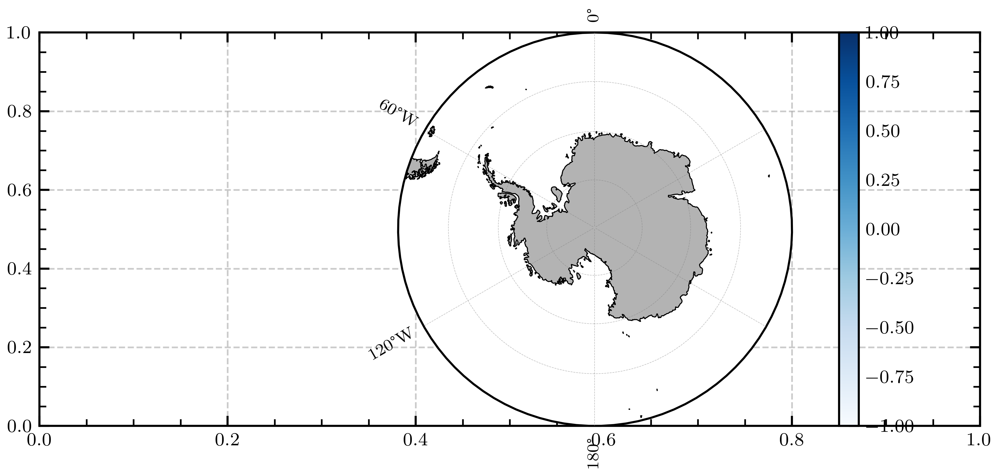

In [8]:
import numpy as np
from matplotlib import pyplot as plt, animation
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig, ax = plt.figure(figsize=[width, height])
x = np.linspace(-3, 3, 91)
t = np.linspace(0, 25, 30)
y = np.linspace(-3, 3, 91)
X3, Y3, T3 = np.meshgrid(x, y, t)
sinT3 = np.sin(2 * np.pi * T3 / T3.max(axis=2)[..., np.newaxis])
G = (X3 ** 2 + Y3 ** 2) * sinT3

ax = fig.add_subplot(1, 1, 1, projection=ccrs.SouthPolarStereo())
ax = create_map_axis(ax=ax, LN=LN, LT=LT, land_mask=land_mask, draw_labels="left")

cax = ax.pcolormesh(x, y, G[:-1, :-1, 0], vmin=-1, vmax=1, cmap='Blues')
fig.colorbar(cax)

def animate(i):
   cax.set_array(G[:-1, :-1, i].flatten())

anim = animation.FuncAnimation(fig, animate, interval=100, frames=len(t) - 1)
anim.save('/home/566/nd0349/notebooks/517.gif')
plt.show()

In [44]:
G

array([[[ 0.00000000e+00,  3.86946792e+00,  7.55800383e+00, ...,
         -7.55800383e+00, -3.86946792e+00, -4.40872848e-15],
        [ 0.00000000e+00,  3.78443517e+00,  7.39191436e+00, ...,
         -7.39191436e+00, -3.78443517e+00, -4.31184531e-15],
        [ 0.00000000e+00,  3.70131327e+00,  7.22955724e+00, ...,
         -7.22955724e+00, -3.70131327e+00, -4.21713929e-15],
        ...,
        [ 0.00000000e+00,  3.70131327e+00,  7.22955724e+00, ...,
         -7.22955724e+00, -3.70131327e+00, -4.21713929e-15],
        [ 0.00000000e+00,  3.78443517e+00,  7.39191436e+00, ...,
         -7.39191436e+00, -3.78443517e+00, -4.31184531e-15],
        [ 0.00000000e+00,  3.86946792e+00,  7.55800383e+00, ...,
         -7.55800383e+00, -3.86946792e+00, -4.40872848e-15]],

       [[ 0.00000000e+00,  3.78443517e+00,  7.39191436e+00, ...,
         -7.39191436e+00, -3.78443517e+00, -4.31184531e-15],
        [ 0.00000000e+00,  3.69940242e+00,  7.22582489e+00, ...,
         -7.22582489e+00, -3.69940242e

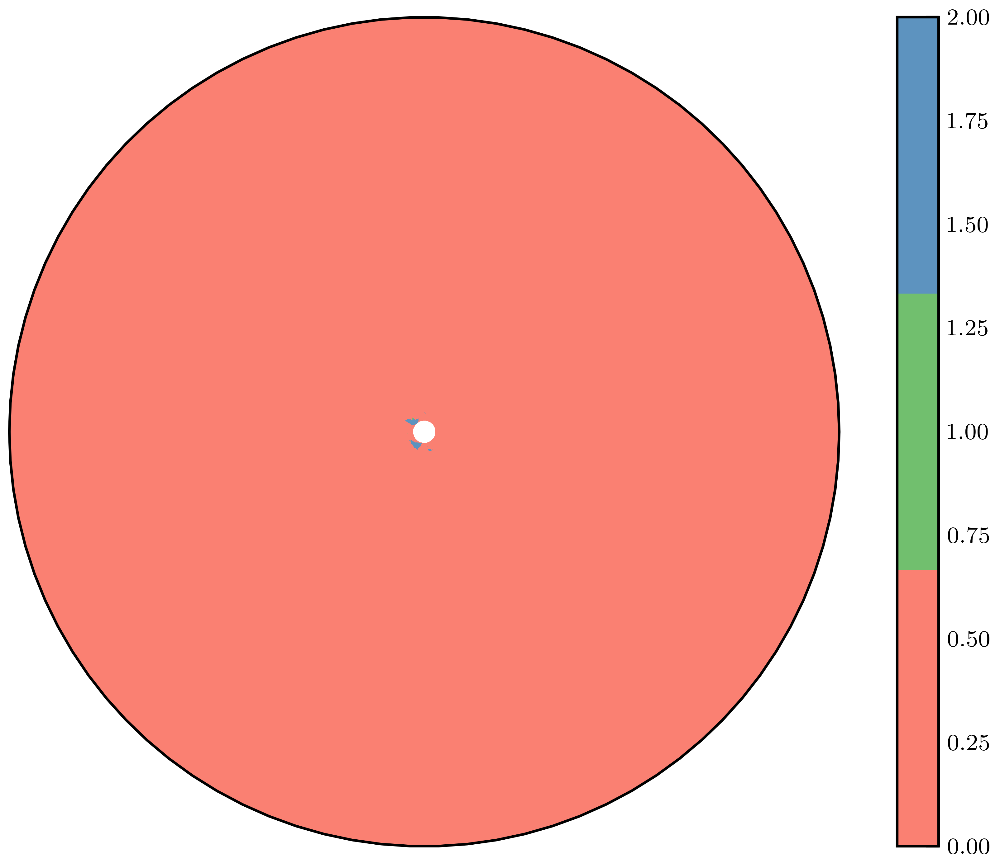

In [50]:
import numpy as np
from matplotlib import pyplot as plt, animation
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True
z_data = np.array(ds['k'][:,:,:])
fig = plt.figure(figsize=[width, height])
ax1 = fig.add_subplot(1, 1, 1, projection=ccrs.SouthPolarStereo())
#cax = ax.pcolormesh(x, y, G[:-1, :-1, 0], vmin=-1, vmax=1, cmap='Blues')
cax = ax1.pcolormesh(LN, LT, z_data[0,:,:], # March 1st
                transform=ccrs.PlateCarree(),
                cmap=cmap,
                #norm=norm,
                shading='auto')
fig.colorbar(cax)

def animate(i):
   cax.set_array(np.array(z_data[i,:,:]).ravel())

anim = animation.FuncAnimation(fig, animate, interval=100, frames=20)
anim.save('/home/566/nd0349/notebooks/517.gif')
plt.show()

In [48]:
np.array(z_data[0,:,:])

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])

# Evolution of each cell

In [4]:
# read in data
filename = '/g/data/ia40/sea-ice-classification/kmean_'+str(year)+'.nc'
n_clusters = 3
#filename = '/g/data/ia40/sea-ice-classification/kmean_'+str(n_clusters)+'_clusters_new_12345_'+str(year)+'.nc'
ds = xr.open_dataset(filename)
LT = ds['LAT']
LN = ds['LON']

In [32]:
ds['k'][:,40,i].values

array([ 0.,  0.,  0., nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan,  0.,  0.,  0.,  0.,  0.,  0.,
        1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
        1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
        1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1

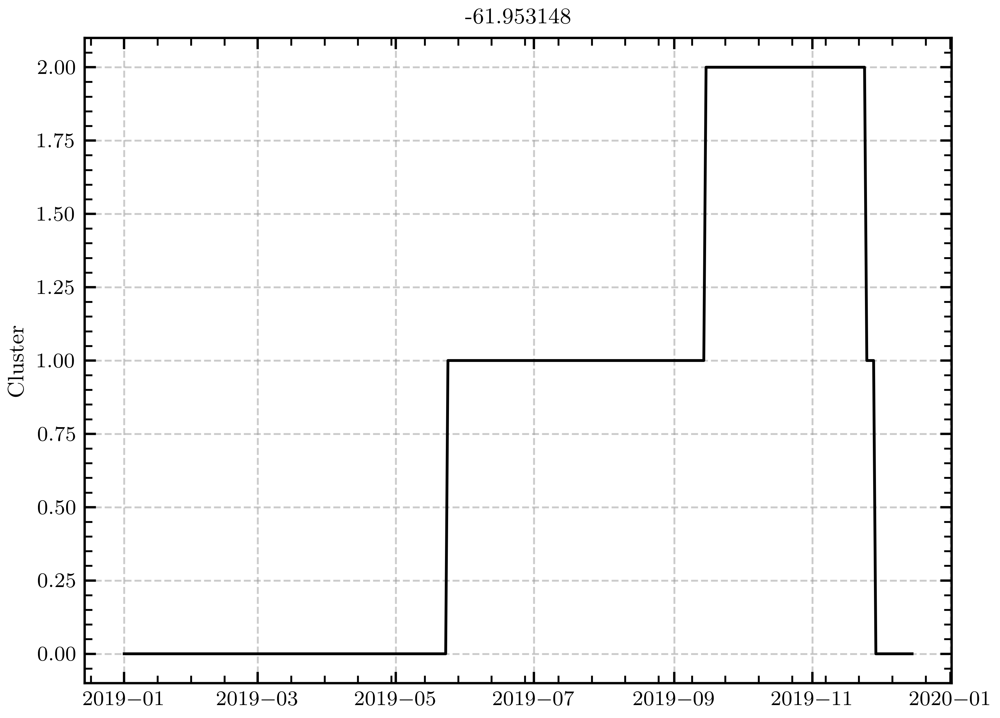

In [71]:

t = pd.date_range(start="2019-01-01",end="2019-12-31")


fig = plt.figure(figsize=[width, height])

ax1 = fig.add_subplot(1, 1, 1)
#ax2 = fig.add_subplot(2, 1, 2)
#ax1 = create_map_axis(ax=ax1, LN=LN, LT=LT, land_mask=land_mask, draw_labels="all")

#line1 = ax1.plot(t, class_vec, linestyle='-')
for i in [40]:
    class_vec = ds['k'][:,i,1].values
    if not np.isnan(class_vec).all():
        sns.lineplot(ax=ax1, x=t, y=class_vec,
            errorbar=None, legend=False)
    
    
#ax1.set_ylim((0,3))
ax1.set(ylabel='Cluster', title=str(ds['LAT'][i,0].values))
savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'cluster_change_single_cell.png', dpi = 600, bbox_inches="tight")
#plt.savefig(savepath+'MIZ_evolution_ts.pdf', bbox_inches="tight")


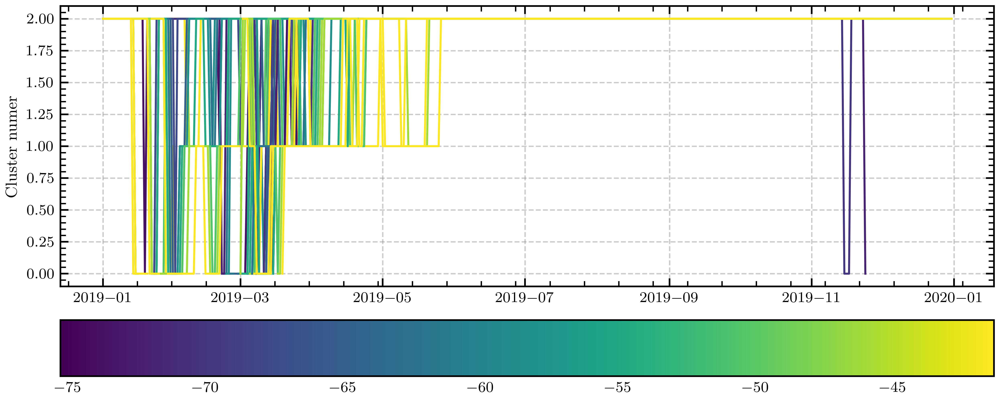

In [89]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np

idx_vec = range(10,70,5)
lat_vec = ds['LAT'][idx_vec,0].values

fig, (ax, cbar_ax) = plt.subplots(nrows=2, figsize=(10, 4 ), gridspec_kw={'height_ratios': [5, 1]})
cmap = mpl.cm.viridis
norm = plt.Normalize(vmin=np.min(lat_vec), vmax=np.max(lat_vec))
cb1 = mpl.colorbar.ColorbarBase(cbar_ax, cmap=cmap, norm=norm, orientation='horizontal')

x = pd.date_range(start="2019-01-01",end="2019-12-31")
for j in range(0,300,5):
    for i,lat in enumerate(lat_vec):
        if not np.isnan(class_vec).all():
            ax.plot(x, ds['k'][:,i,j].values, color=cmap(norm(lat)), linestyle = '-')
ax.set(ylabel = "Cluster numer")
ax1.set(ylabel='Cluster', title=str(ds['LAT'][i,0].values))
savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'cluster_change_multiple_cell.png', dpi = 600, bbox_inches="tight")
fig.show()

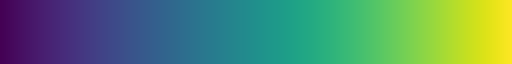

In [85]:
mpl.cm.viridis

In [44]:
idx_vec = range(10,50)
lat_vec = ds['LAT'][idx_vec,0].values
lat_vec

array([-75.28924 , -75.00513 , -74.71407 , -74.41551 , -74.10892 ,
       -73.793755, -73.469505, -73.13569 , -72.7918  , -72.4374  ,
       -72.07202 , -71.69524 , -71.30665 , -70.90585 , -70.492485,
       -70.06619 , -69.62665 , -69.173546, -68.706604, -68.22556 ,
       -67.73019 , -67.22025 , -66.69558 , -66.15601 , -65.601395,
       -65.03162 , -64.446594, -63.846264, -63.230583, -62.59954 ,
       -61.953148, -61.291443, -60.61449 , -59.922382, -59.21523 ,
       -58.49317 , -57.75638 , -57.005028, -56.23934 , -55.459553],
      dtype=float32)

# PDF of FSD

In [3]:
# Read in the dataframes
year = 2019
df_all_fsd = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/kmean_3_clusters_floesize_'+str(year)+'.csv') for year in tqdm(range(2019,2020))), ignore_index=True)

df_all = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/kmeans_'+str(year)+'.csv') for year in tqdm(range(2019,2020))), ignore_index=True)
#df_all_raw = pd.concat((pd.read_csv('/g/data/ia40/sea-ice-classification/dataframes/raw_'+str(year)+'.csv') for year in tqdm(range(2019,2020))), ignore_index=True)
#df_all_raw['k'] = df_all['k']

100%|██████████| 1/1 [00:02<00:00,  2.72s/it]


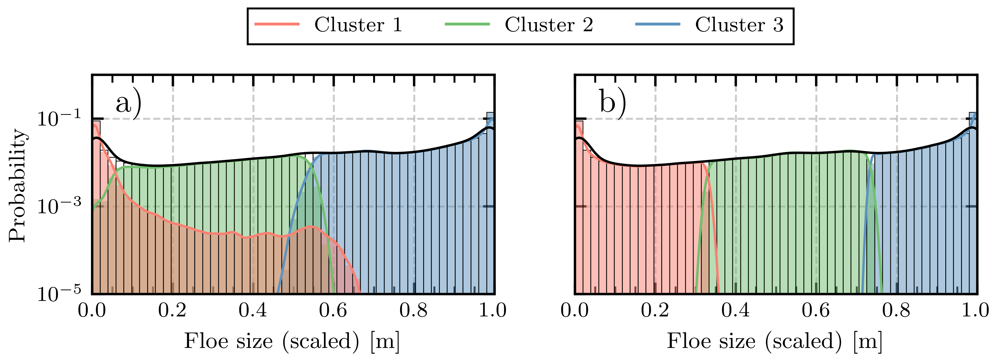

In [5]:
n_bins = 51
fig, axes = plt.subplots(1, 2, figsize=(width,height/3), sharey=True)

df_plot = df_all.sample(n=1000000)
df_plot_fsd = df_all_fsd.sample(n=1000000)

trans = mtransforms.ScaledTranslation(10/72, -5/72, fig.dpi_scale_trans)

sns.histplot(ax=axes[0], data=df_plot, x="fsdrad", hue="k", 
             kde=True, legend=False,
             palette=[(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)],
             bins=n_bins, stat='probability',
             line_kws={'lw': 1, 'ls': '-'},
             edgecolor=None, alpha = 0.5,
             cbar_kws=dict(edgecolor="black", linewidth=0))
             #binwidth = 0.33)#, line_kws={'lw': 0.25, 'color': (0.9805, 0.5000, 0.4453, 1.0)},
             #alpha=0.5,color=(0.9805, 0.5000, 0.4453, 1.0))

sns.histplot(ax=axes[0], data=df_plot, x="fsdrad",
             kde=True, legend=False,
             bins=n_bins, stat='probability',
             line_kws={'lw': 1, 'ls': '-'},
             edgecolor='k', alpha = 0.0,
             cbar_kws=dict(edgecolor="black", linewidth=0))

axes[0].set_yscale('log')
axes[0].set_xlabel('Floe size (scaled) [m]')
axes[0].set_ylim((0.00001, 1.0))
axes[0].set_xlim((0, 1))


sns.histplot(ax=axes[1], data=df_plot_fsd, x="fsdrad", hue="k", 
             kde=True, legend=False,
             palette=[(0.9805, 0.5000, 0.4453, 1.0), (0.4416, 0.7490, 0.4322, 1.0), (0.3639, 0.5755, 0.748, 1.0)],
             bins=n_bins, stat='probability',
             line_kws={'lw': 1, 'ls': '-'},
             edgecolor=None, alpha = 0.5,
             cbar_kws=dict(edgecolor="black", linewidth=0))
             #binwidth = 0.33)#, line_kws={'lw': 0.25, 'color': (0.9805, 0.5000, 0.4453, 1.0)},
             #alpha=0.5,color=(0.9805, 0.5000, 0.4453, 1.0))

sns.histplot(ax=axes[1], data=df_plot, x="fsdrad",
             kde=True, legend=False,
             bins=n_bins, stat='probability',
             line_kws={'lw': 1, 'ls': '-'},
             edgecolor='k', alpha = 0.0,
             cbar_kws=dict(edgecolor="black", linewidth=0))

axes[1].set_yscale('log')
axes[1].set_xlabel('Floe size (scaled) [m]')
axes[1].set_ylim((0.00001, 1.0))
axes[1].set_xlim((0, 1))
axes[1].set(ylabel=None)


# Create a legend
from matplotlib.lines import Line2D
import matplotlib.patches as mpatches
# access legend objects automatically created from data
handles, labels = axes[0].get_legend_handles_labels()

# create manual symbols for legend
#patch = mpatches.Patch(color='grey', label='manual patch')   
#line = Line2D([0], [0], label='manual line', color='k')
#point = Line2D([0], [0], label='manual point', marker='s', markersize=10, 
#         markeredgecolor='r', markerfacecolor='k', linestyle='')
line1 = Line2D([0], [0], label='Cluster 1', color=(0.9805, 0.5000, 0.4453, 1.0))
line2 = Line2D([0], [0], label='Cluster 2', color=(0.4416, 0.7490, 0.4322, 1.0))
line3 = Line2D([0], [0], label='Cluster 3', color=(0.3639, 0.5755, 0.748, 1.0))
                                                             

# add manual symbols to auto legend
handles.extend([line1, line2, line3])
plt.legend(handles=handles, ncol=3, fancybox=False, edgecolor="black", loc="center", bbox_to_anchor=(0.5, 1.05), bbox_transform=fig.transFigure)


#fig.tight_layout(pad=0.00)



axes[0].text(0.0, 1.0, 'a)', transform=axes[0].transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))
axes[1].text(0.0, 1.0, 'b)', transform=axes[1].transAxes + trans,
       fontsize='medium', verticalalignment='top', fontfamily='serif',
       bbox=dict(facecolor='none', edgecolor='none', pad=3.0))

savepath = '/home/566/nd0349/notebooks/'
plt.savefig(savepath+'fsd_dist_comp_floesize.png', dpi = 600, bbox_inches="tight")
plt.savefig(savepath+'fsd_dist_floesize.pdf')